In [12]:
#imports
import pandas as pd
import numpy as np
import matplotlib as mpl
from matplotlib import rcParams
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib import cycler
from matplotlib.ticker import StrMethodFormatter
from matplotlib.axis import Axis
from matplotlib.patches import FancyBboxPatch
from matplotlib.font_manager import FontProperties
import sqlite3 as sq
from functools import reduce
#settings
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width', 150)
pd.options.mode.chained_assignment = None  # default='warn'
from warnings import simplefilter
simplefilter(action="ignore", category=pd.errors.PerformanceWarning)
import sys
sys.path.append("../../../Functions and Dictionaries/") # Adds higher directory to python modules path
import geodict
namestocommon = geodict.namestocommon

In [13]:
import vizfunctions2
prettypercentchange = vizfunctions2.prettypercentchange #single viz per x axis unit datalabels, active inputs: xoffset, yoffset, labelformat
percentchange = vizfunctions2.percentchange #double viz per x axis unit datalabels, active inputs: xoffset1, yoffset1, xoffset2, yoffset2, labelformat, size
percent = vizfunctions2.percent
percentchange = vizfunctions2.percentchange
realchange = vizfunctions2.realchange

In [14]:
import changefunctions
calculate_changes = changefunctions.calculate_changes
generate_time_frames = changefunctions.generate_time_frames

In [15]:
import vizfunctions
#allheaders = vizfunctions.allheaders
#howwide = vizfunctions.howwide
tablecolors = vizfunctions.tablecolors
#allheadersmerged = vizfunctions.allheadersmerged
#makeinvisible = vizfunctions.makeinvisible
mergecells = vizfunctions.mergecells
mergemultcells = vizfunctions.mergemultcells

In [16]:
#data labels functions
def singledatalabels(xoffset, yoffset, labelformat):
    for j, k in zip(x, y):
        label = labelformat.format(k)
        plt.annotate(label, (j, k), textcoords = 'offset points', xytext = (xoffset, yoffset), ha = 'center')
boxstyleinput = "round,pad=-0.060,rounding_size=0.15"
def roundedboxes(boxstyleinput):
    new_patches = []
    for patch in reversed(ax.patches):
        bb = patch.get_bbox()
        color=patch.get_facecolor()
        p_bbox = FancyBboxPatch((bb.xmin, bb.ymin),abs(bb.width), abs(bb.height),boxstyle=boxstyleinput, ec="none", fc=color, mutation_aspect=1)
        patch.remove()
        new_patches.append(p_bbox)
    for patch in new_patches:
        ax.add_patch(patch)
def howwide(width):
    ['None' for x in range(width)]
def howlong(indexlength):
    ["None" for x in range(indexlength)]
col1, col2, edge1, edge2 = '#00263E', '#E1EFF2', 'vertical', 'horizontal'
def allheadersmerged(col1, col2, edge1, edge2):
    for cell in table.get_children():
        cell_text = cell.get_text().get_text()
        if cell_text not in row_headers\
        and cell_text not in doublecols:
            cell.set_edgecolor(col1)
        elif cell_text in column_headers:
            cell.set_edgecolor(None)
        else:
            cell.set(edgecolor=col2)
        if cell_text in column_headers:
            cell.visible_edges = 'B'
        elif cell_text in row_headers:
            cell.visible_edges = edge2
        elif cell_text in col_names:
            cell.visible_edges = 'LR'
        if cell_text in row_headers\
        or cell_text in doublecols:
            cell.set_text_props(fontproperties=FontProperties(weight='bold'))
#function to make figure invisible for tables
guy1, guy2, guy3 = False, 'off', 'tight'
def makeinvisible(guy1, guy2, guy3):
    return fig.patch.set_visible(guy1), ax.axis(guy2), ax.axis(guy3)
col1, col2, edge1, edge2 = '#00263E', '#E1EFF2', 'vertical', 'horizontal'
def allheaders(col1, col2, edge1, edge2):
    for cell in table.get_children():
        cell_text = cell.get_text().get_text()
        if cell_text not in row_headers\
        and cell_text not in column_headers:
            cell.set_edgecolor(col1)
        else:
            cell.set(edgecolor=col2)
    for cell in table.get_children():
        cell_text = cell.get_text().get_text()
        if cell_text in column_headers:
            cell.visible_edges = edge1
        elif cell_text in row_headers:
            cell.visible_edges = edge2
    for cell in table.get_children():
        cell_text = cell.get_text().get_text()
        if cell_text in row_headers\
        or cell_text in column_headers:
            cell.set_text_props(fontproperties=FontProperties(weight='bold'))
#stacked bar labels function
belowstackedbarlabels, abovestackedbarlabels = -5, 2
def stackedbarlabels(locationoffset):
    for bar in ax.patches:
        ax.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + bar.get_y() + locationoffset, str(float(round(bar.get_height(), 1))) + '%', ha='center')
def doubledatalabels(xoffset1, yoffset1, xoffset2, yoffset2, labelformat, size):
    for j, k in zip(xpos, y1):
        label = labelformat.format(k)
        ax.annotate(label, (j, k), textcoords = 'offset points', xytext = (xoffset1, yoffset1), fontsize = size, ha = 'center')
    for j, k in zip(xpos, y2):
        label = labelformat.format(k)
        ax.annotate(label, (j, k), textcoords = 'offset points', xytext = (xoffset2, yoffset2), fontsize = size, ha = 'center')

In [17]:
#Set branding parameters
GNRCDARKBLUE, GNRCLIGHTBLUE, GNRCORANGE, GNRCCOOLGRAY= '#00263E', '#6DB0C7', '#EB7525', '#7B7E85'
C1, C2, C3, C4, C5, C6, C7, C8, C9 = '#064460', '#757680', '#04979e', '#4f853d', '#808989', '#0C2428', '#414543', '#a9d6bd', '#e8ebbc'
TABLECOL1, TABLECOL2 = '#E1EFF2', '#F4F9F9'
GNRCFONTONE, GNRCFONTTWO, GNRCFONTTHREE = 'Calibri', 'DIN Condensed', 'Palatino Linotype'
SMALLER_SIZE, SMALL_SIZE, MEDIUM_SIZE, BIGGER_SIZE, BIGGEST_SIZE = 10, 11, 13, 18, 20
#Update the default style sheet using rcparams
plt.rcParams.update({'font.size': SMALL_SIZE, 'font.weight': 'normal', 'axes.titlesize': BIGGER_SIZE, 'axes.labelsize': MEDIUM_SIZE, 'xtick.labelsize': SMALL_SIZE, 
'ytick.labelsize': SMALL_SIZE, 'legend.fontsize': SMALL_SIZE, 'font.family': GNRCFONTONE, 'axes.facecolor': 'None', 'figure.figsize': (10, 5), 
'figure.facecolor': 'None', 'figure.edgecolor': 'None', 'figure.autolayout': True, 'figure.dpi': 500, 'axes.grid': False, 'axes.grid.which': 'major', 
'axes.axisbelow': True, 'text.color': GNRCDARKBLUE, 'axes.labelcolor': GNRCDARKBLUE, 'xtick.color': GNRCCOOLGRAY, 'ytick.color': GNRCCOOLGRAY, 
'axes.labelpad': 15, 'axes.titlepad': 20, 'grid.color': GNRCCOOLGRAY, 'grid.linestyle': '-', 'grid.alpha': '0.7', 'lines.linewidth': 1.5, 
'lines.linestyle': '-', 'lines.marker': 'o', 'legend.framealpha': 0.8, 'legend.facecolor': 'inherit', 'legend.frameon': False,
'axes.prop_cycle': cycler(color = [C1, C2, C3, C4, C5, C6, C7, C8, C9, GNRCLIGHTBLUE]), 
'axes.spines.top': False, 'axes.spines.right': False, 'axes.spines.bottom': False, 'axes.spines.left': False, 'xtick.major.size': 8, 
'xtick.minor.size': 4, 'ytick.major.size': 6, 'ytick.minor.size': 3, 'ytick.minor.size': 3})
#Settings not available in rcparams
tickaxisselection = 'both'                  #both axes have ticks
majororminortick = 'major'                  #only major ticks selected for now, although we just established a default size for the minor if we want them
linealpha = 0.8                             #no rcparam, set this as alpha for line plots
#AXIS LABEL FORMATTERS
yearformat = '{x:.0f}'                       #takes float datatype to look like a year
numbernodecimalformat = '{x:,.0f}'           #takes float datatype to a number with no decimal with commas at the thousandth
numberonedecimalformat = '{x:,.1f}'          #takes float datatype to a number with one decimal with commas at the thousandth
numbertwodecimalformat = '{x:,.2f}'          #takes float datatype to a number with two decimal with commas at the thousandth
percentformat = '{x:,.1f}%'                  #takes float datatype to a number with one decimal with commas at the thousandth and an appended %
percentnodecimalformat = '{x:,.0f}%'         #takes float datatype to a number with one decimal with commas at the thousandth and an appended %
moneyformat = '${x:,.0f}'                    #takes float datatype to a number with no decimal with commas at the thousandth and a MONEY sign   

In [18]:
#2000
conn = sq.connect('../../../Data-Pipelines/Outputs/CensusBureau.db')
#SF12000
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_SF1_2000]', conn)
sf12000 = pd.DataFrame(sql_query)
sf12000.drop(columns = 'Source', inplace = True)
#SF32000
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_SF3_2000]', conn)
sf32000 = pd.DataFrame(sql_query)
sf32000.drop(columns = 'Source', inplace = True)
# #TIGER2000
# sql_query = pd.read_sql('SELECT * FROM [CensusBureau_TIGER_2000]', conn)
# TIGER2000 = pd.DataFrame(sql_query)
# TIGER2000.drop(columns = 'Source', inplace = True)
dfs2000 = [#TIGER2000, 
           sf12000, sf32000]
twothousand= reduce(lambda  left,right: pd.merge(left,right,on=['NAME', 'GEO_ID'], how='outer'), dfs2000)
twothousand = twothousand.set_index(['NAME', 'GEO_ID'])
twothousandsuff = twothousand.add_suffix(' 2000')
#twothousand.columns = pd.MultiIndex.from_product([twothousand.columns, [2000], ['None']])
#2010
#SF12010
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_SF1_2010]', conn)
sf12010 = pd.DataFrame(sql_query)
sf12010.drop(columns = 'Source', inplace = True)
#ACS52010
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_ACS5_2010]', conn)
ACS52010 = pd.DataFrame(sql_query)
ACS52010.drop(columns = 'Source', inplace = True)
# #TIGER2010
# sql_query = pd.read_sql('SELECT * FROM [CensusBureau_TIGER_2010]', conn)
# TIGER2010 = pd.DataFrame(sql_query)
# TIGER2010.drop(columns = 'Source', inplace = True)
dfs2010 = [#TIGER2010, 
    sf12010, ACS52010]
twothousandten= reduce(lambda  left,right: pd.merge(left,right,on=['NAME', 'GEO_ID'], how='outer'), dfs2010)
twothousandten = twothousandten.fillna(0)
twothousandten = twothousandten.set_index(['NAME', 'GEO_ID'])
twothousandtensuff = twothousandten.add_suffix(' 2010')
#twothousandten.columns = pd.MultiIndex.from_product([twothousandten.columns, [2010], ['None']])
#2020/22
#ACS52022
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_ACS5_2022_1]', conn)
ACS52022_1 = pd.DataFrame(sql_query)
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_ACS5_2022_2]', conn)
ACS52022_2 = pd.DataFrame(sql_query)
ACS52022 = ACS52022_1.merge(ACS52022_2, on = ['NAME', 'GEO_ID', 'Source'])
ACS52022.drop(columns = 'Source', inplace = True)
#PL2020
sql_query = pd.read_sql('SELECT * FROM [CensusBureau_PL_2020]', conn)
PL2020 = pd.DataFrame(sql_query)
PL2020.drop(columns = 'Source', inplace = True)
# #TIGER2020
# sql_query = pd.read_sql('SELECT * FROM [CensusBureau_TIGER_2020]', conn)
# TIGER2020 = pd.DataFrame(sql_query)
# TIGER2020.drop(columns = 'Source', inplace = True)
dfs2022 = [#TIGER2020, 
    ACS52022, PL2020]
twothousandtwentytwo = reduce(lambda  left,right: pd.merge(left,right,on=['NAME', 'GEO_ID'], how='outer'), dfs2022)
twothousandtwentytwo = twothousandtwentytwo.fillna(0)
twothousandtwentytwo = twothousandtwentytwo.set_index(['NAME', 'GEO_ID'])
twothousandtwentytwosuff = twothousandtwentytwo.add_suffix(' 2022')

In [19]:
#CHECK WHATS GOING ON HERE LATER
twothousandten = twothousandten.drop(columns = 'index')

In [20]:
geos = ['Wilson Unincorporated', 'Wilson Incorporated', 'Wilson County', 'Tennessee', 'GNRC', 
        'Mount Juliet', 'Lebanon', 'Watertown']

In [21]:
dfs = [twothousandsuff, twothousandtensuff, twothousandtwentytwosuff]
dfsuff = reduce(lambda  left,right: pd.merge(left,right, on = ['NAME', 'GEO_ID'], how='outer'), dfs)

In [22]:
dfsuff = dfsuff.reset_index().set_index('NAME').transpose()
dfsuff = dfsuff.rename(columns = namestocommon)
dfsuff = dfsuff[geos]
dfsuff = dfsuff.transpose().reset_index()

In [23]:
cols = list(dfsuff.columns)
cols.remove('NAME')
cols.remove('GEO_ID')
dfsuff[cols] = dfsuff[cols].astype(float)

In [24]:
twothousand.columns = pd.MultiIndex.from_product([twothousand.columns, [2000], ['None']])
twothousandten.columns = pd.MultiIndex.from_product([twothousandten.columns, [2010], ['None']])
twothousandtwentytwo.columns = pd.MultiIndex.from_product([twothousandtwentytwo.columns, [2022], ['None']])

In [25]:
#all years tidy
dfs = [twothousand, twothousandten, twothousandtwentytwo]
dftidy = reduce(lambda  left,right: pd.merge(left,right,on=['NAME', 'GEO_ID'], how='outer'), dfs)

In [26]:
years = [2000, 2010, 2022]
time_frames = generate_time_frames(years)

In [27]:
value_counts = dftidy.columns.get_level_values(0).value_counts()
first_level = value_counts[value_counts == 3].index.tolist()
#remove percentages - don't want change metrics on them
first_level = [item for item in first_level if '%' not in item]

In [28]:
#pass the dataframe, the list of variables, time frames, and years through the "calculate change" function
dftidy = calculate_changes(dftidy, first_level, time_frames = time_frames, years = years)

In [29]:
#reformat and rename columns
dftidy = dftidy.stack([1, 1])
dftidy = dftidy.reset_index(drop = False)
dftidy = dftidy.rename(columns = {'level_2':'Year', 'level_3':'Time Frame'})

In [30]:
dftidy = dftidy.set_index('NAME').transpose()
dftidy = dftidy.rename(columns = namestocommon)
dftidy = dftidy[geos]
dftidy = dftidy.transpose().reset_index()
dftidy['Year'] = dftidy['Year'].replace({'None': 0})

In [31]:
cols = list(dftidy.columns)
cols.remove("GEO_ID")
cols.remove('Time Frame')
cols.remove('NAME')
dftidy[cols] = dftidy[cols].astype(float)

In [32]:
#set primary geo for colors
primarygeo = 'Wilson Unincorporated'
county = 'Wilson County'
#quick geo filters
reggeos = dftidy.loc[(dftidy['NAME'] == 'Wilson Unincorporated')|(dftidy['NAME'] == 'Wilson County')|
                     (dftidy['NAME'] == 'Tennessee')|(dftidy['NAME'] == 'GNRC')|(dftidy['NAME'] == 'Mount Juliet')|
                     (dftidy['NAME'] == 'Lebanon')|(dftidy['NAME'] == 'Watertown')].reset_index(drop = True)
reggeost = dfsuff.loc[(dfsuff['NAME'] == 'Wilson Unincorporated')|(dfsuff['NAME'] == 'Wilson County')|
                      (dfsuff['NAME'] == 'Tennessee')|(dfsuff['NAME'] == 'GNRC')|(dfsuff['NAME'] == 'Mount Juliet')|(dfsuff['NAME'] == 'Lebanon')|
                      (dfsuff['NAME'] == 'Watertown')].reset_index(drop = True)
Primary = dftidy.loc[dftidy['NAME'] == 'Wilson Unincorporated']
Primaryt = dfsuff.loc[dfsuff['NAME'] == 'Wilson Unincorporated']
County = dftidy.loc[dftidy['NAME'] == 'Wilson County']
Countyt = dfsuff.loc[dfsuff['NAME'] == 'Wilson County']
state = 'Tennessee'
State = dftidy.loc[dftidy['NAME'] == 'Tennessee']
region = 'GNRC'
Region = dftidy.loc[dftidy['NAME'] == 'GNRC']
MountJuliet = dftidy.loc[dftidy['NAME'] == 'Mount Juliet']
MountJuliett = dfsuff.loc[dfsuff['NAME'] == 'Mount Juliet']
Lebanon = dftidy.loc[dftidy['NAME'] == 'Lebanon']
Lebanont = dfsuff.loc[dfsuff['NAME'] == 'Lebanon']
Watertown = dftidy.loc[dftidy['NAME'] == 'Watertown']
Watertownt = dfsuff.loc[dfsuff['NAME'] == 'Watertown']
Tennessee = dftidy.loc[dftidy['NAME'] == 'Tennessee']
Tennesseet = dfsuff.loc[dfsuff['NAME'] == 'Tennessee']
GNRC = dftidy.loc[dftidy['NAME'] == 'GNRC']
GNRCt = dfsuff.loc[dfsuff['NAME'] == 'GNRC']

In [33]:
acs = '2018 - 2022 American Community Survey 5-Year Estimates'

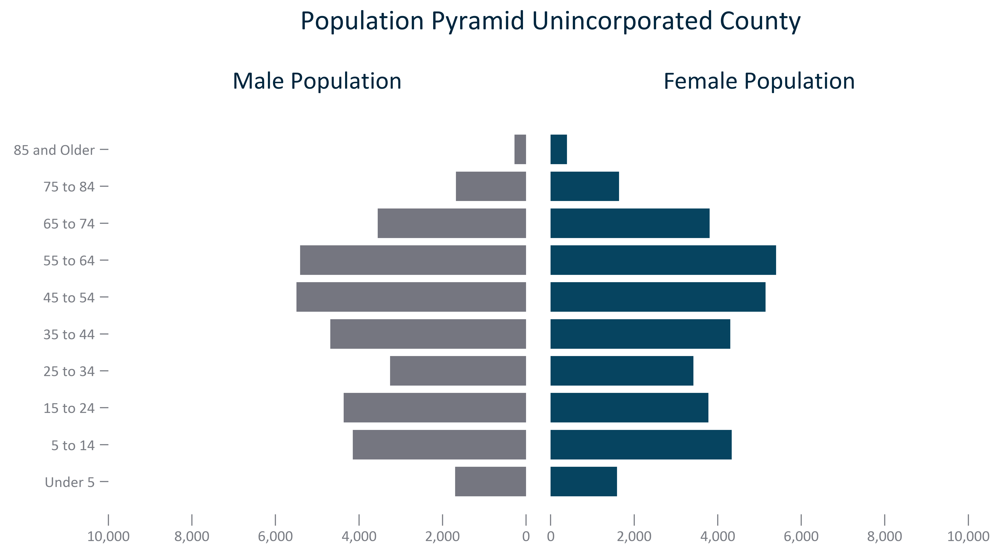

In [34]:
title = 'Population Pyramid Unincorporated County'
df_temp = Primary.loc[Primary['Year'] == 2022.0]
df_temp1 = df_temp[['Male Under 5', 'Male 5 to 14', 'Male 15 to 24', 'Male 25 to 34', 'Male 35 to 44', 'Male 45 to 54', 
                     'Male 55 to 64', 'Male 65 to 74', 'Male 75 to 84', 'Male 85 and Older']]
df_temp1_transp = df_temp1.transpose().reset_index()
df_temp1_transp.columns = ['Age Group', 'Male Population']
splittitle = df_temp1_transp['Age Group'].str.split("Male", expand = True)
df_temp1_transp['Age Group'] = splittitle[1]
df_temp2 = df_temp[['Female Under 5', 'Female 5 to 14', 'Female 15 to 24', 'Female 25 to 34', 'Female 35 to 44', 'Female 45 to 54', 
                     'Female 55 to 64', 'Female 65 to 74', 'Female 75 to 84', 'Female 85 and Older']]
df_temp2_transp = df_temp2.transpose().reset_index()
df_temp2_transp.columns = ['Age Group', 'Female Population']
splittitle = df_temp2_transp['Age Group'].str.split("Female", expand = True)
df_temp2_transp['Age Group'] = splittitle[1]
df_temp = df_temp1_transp.merge(df_temp2_transp, on = 'Age Group')
#initiate figures and set parameters
fig, axes = plt.subplots(ncols=2, sharey=True)
index = df_temp['Age Group']
indices = [df_temp['Age Group'], df_temp['Age Group']]
column0 = df_temp['Male Population']
column1 = df_temp['Female Population']
columns = [df_temp['Male Population'], df_temp['Female Population']]
axes[0].barh(index, column0, color = C2, align='center')
axes[0].set_title('Male Population')
axes[0].set_xlim(0, 10000)
axes[0].invert_xaxis() 
axes[0].xaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #x axis formatting
axes[1].xaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #x axis formatting
axes[1].yaxis.set_ticks_position('none')
axes[1].barh(index, column1, align='center')
axes[1].set_title('Female Population')
axes[1].set_xlim(0, 10000)
#title entire figure
fig.text(0.55, 1.05, title, fontsize = BIGGEST_SIZE, ha='center')
# #display and save
fig.savefig('../Figures/AGE_pyramid_primarygeo_populationpyramid_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_pyramid_primarygeo_populationpyramid_2022.png', bbox_inches='tight')
with open('../Figures/AGE_pyramid_primarygeo_populationpyramid_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

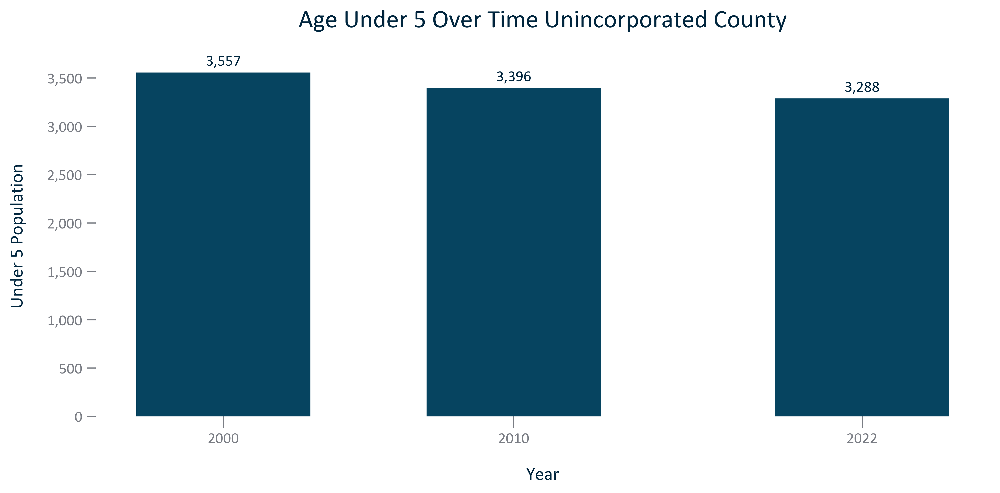

In [35]:
title = 'Age Under 5 Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
#df_temp = df_temp.loc[df_temp['Population'].notnull()]
df_temp = df_temp[['NAME', 'Year', 'Age:Under 5']]
xinput = 'Year'
yinput = 'Age:Under 5'
xlabel = xinput
ylabel = 'Under 5 Population'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/AGE_bar_primarygeo_under5_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_bar_primarygeo_under5_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_bar_primarygeo_under5_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, 2018-2022 American Community Survey 5-Year Estimates')
plt.show()
plt.close();

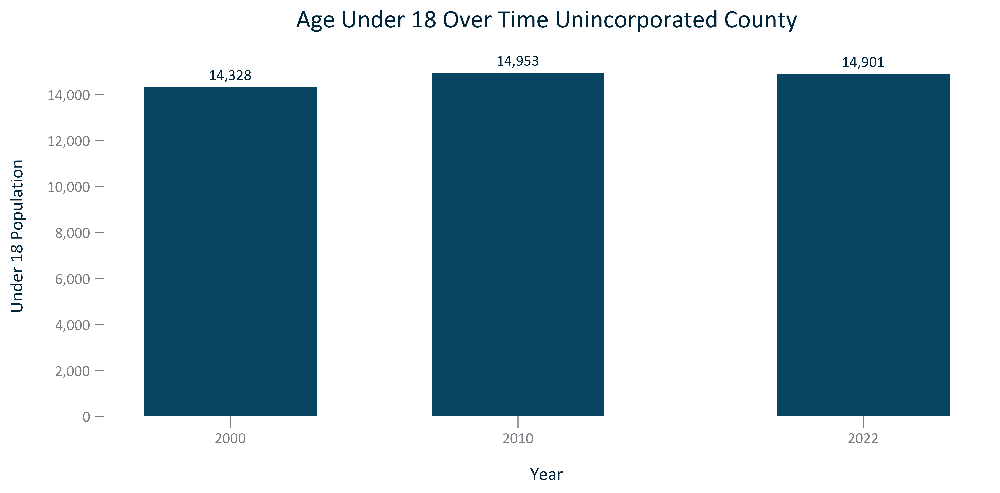

In [37]:
title = 'Age Under 18 Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
#df_temp = df_temp.loc[df_temp['Population'].notnull()]
df_temp = df_temp[['NAME', 'Year', 'Age:Under 18']]
xinput = 'Year'
yinput = 'Age:Under 18'
xlabel = xinput
ylabel = 'Under 18 Population'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/AGE_bar_primarygeo_under18_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_bar_primarygeo_under18_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_bar_primarygeo_under18_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, 2018-2022 American Community Survey 5-Year Estimates')
plt.show()
plt.close();

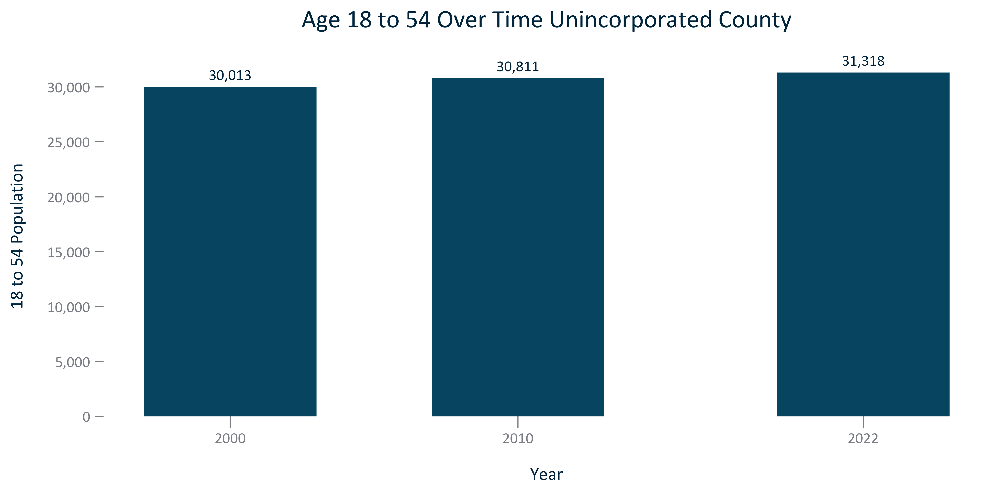

In [38]:
title = 'Age 18 to 54 Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
#df_temp = df_temp.loc[df_temp['Population'].notnull()]
df_temp = df_temp[['NAME', 'Year', 'Age:18 to 54']]
xinput = 'Year'
yinput = 'Age:18 to 54'
xlabel = xinput
ylabel = '18 to 54 Population'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/AGE_bar_primarygeo_18to54_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_bar_primarygeo_18to54_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_bar_primarygeo_18to54_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

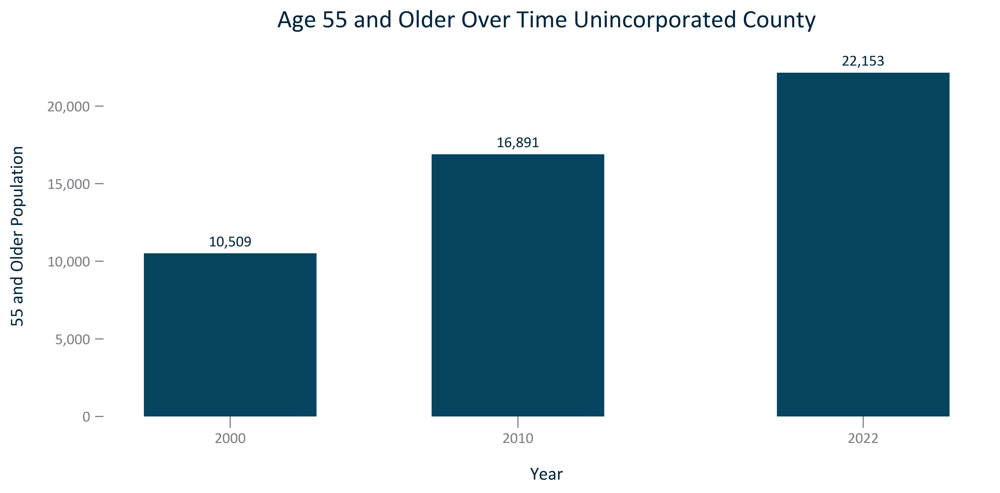

In [39]:
title = 'Age 55 and Older Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
#df_temp = df_temp.loc[df_temp['Population'].notnull()]
df_temp = df_temp[['NAME', 'Year', 'Age:55 and Older']]
xinput = 'Year'
yinput = 'Age:55 and Older'
xlabel = xinput
ylabel = '55 and Older Population'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(ticks = x, labels = labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/AGE_bar_primarygeo_55older_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_bar_primarygeo_55older_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_bar_primarygeo_55older_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

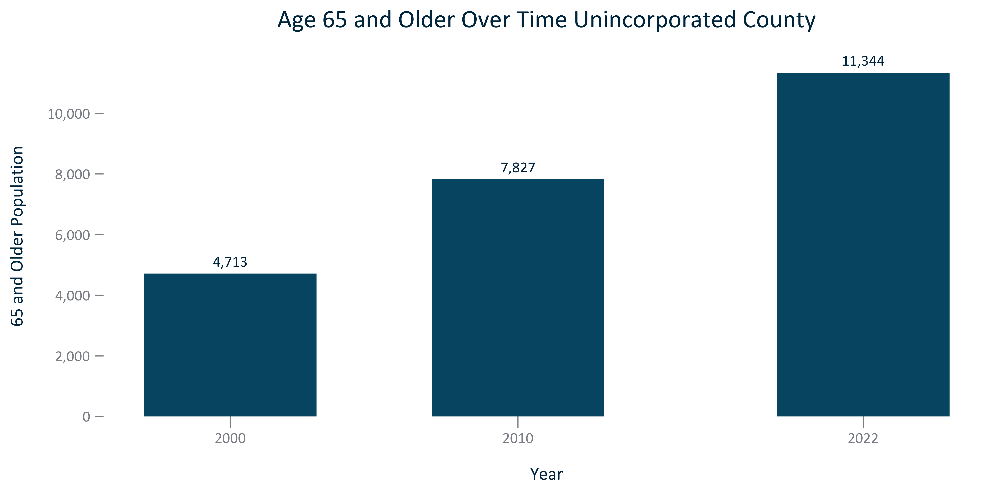

In [40]:
title = 'Age 65 and Older Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Age:65 and Older']]
xinput = 'Year'
yinput = 'Age:65 and Older'
xlabel = xinput
ylabel = '65 and Older Population'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/AGE_bar_primarygeo_65older_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_bar_primarygeo_65older_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_bar_primarygeo_65older_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

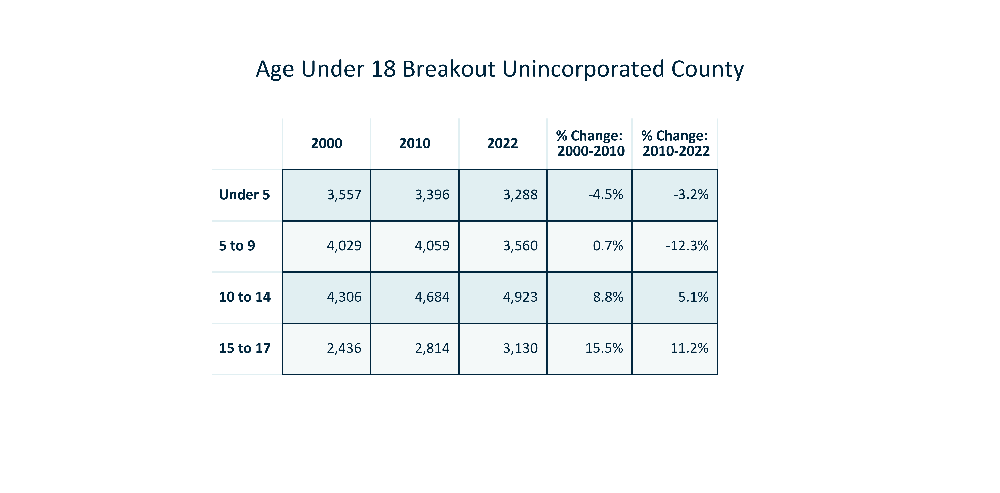

In [41]:
title = 'Age Under 18 Breakout Unincorporated County'
df_temp = Primary
df_temp1 = df_temp.loc[df_temp['Year'] != 0.0]
df_temp2 = df_temp.loc[df_temp['Time Frame'] == '2000-2010']
df_temp3 = df_temp.loc[df_temp['Time Frame'] == '2010-2022']
df_temp1 = df_temp1[['Year', 'Age:Under 5', 'Age:5 to 9', 'Age:10 to 14', 'Age:15 to 17']]
df_temp1 = df_temp1.rename(columns = {'Age:Under 5': 'Under 5  ', 'Age:5 to 9': '5 to 9  ', 'Age:10 to 14':'10 to 14  ', 'Age:15 to 17': '15 to 17  '})
df_temp1.update(df_temp1[['Under 5  ', '5 to 9  ', '10 to 14  ', '15 to 17  ']].applymap('{:,.0f}'.format))
df_temp1.update(df_temp1[['Year']].applymap('{:.0f}'.format))
df_temp1 = df_temp1.set_index('Year')
df_temp1 = df_temp1.transpose().reset_index()
df_temp2 = df_temp2[['Time Frame', 'Age:Under 5 % Change', 'Age:5 to 9 % Change', 'Age:10 to 14 % Change', 'Age:15 to 17 % Change']]
df_temp2.update(df_temp2[['Age:Under 5 % Change', 'Age:5 to 9 % Change', 'Age:10 to 14 % Change', 'Age:15 to 17 % Change']].applymap('{:,.1f}%'.format))
df_temp2 = df_temp2.set_index('Time Frame')
df_temp2 = df_temp2.transpose().reset_index()
extracted_col = df_temp2['2000-2010']
df_temp1.insert(4, '% Change:\n 2000-2010', extracted_col)
df_temp3 = df_temp3[['Time Frame', 'Age:Under 5 % Change', 'Age:5 to 9 % Change', 'Age:10 to 14 % Change', 'Age:15 to 17 % Change']]
df_temp3.update(df_temp3[['Age:Under 5 % Change', 'Age:5 to 9 % Change', 'Age:10 to 14 % Change', 'Age:15 to 17 % Change']].applymap('{:,.1f}%'.format))
df_temp3 = df_temp3.set_index('Time Frame')
df_temp3 = df_temp3.transpose().reset_index()
extracted_col = df_temp3['2010-2022']
df_temp1.insert(5, '% Change:\n 2010-2022', extracted_col)
df_temp = df_temp1.set_index('index')
df_temp = df_temp.rename(columns = {'2000':'      2000      ', '2010':'      2010      ', '2022':'      2022      '})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.8)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/AGE_table_primarygeo_under18breakout_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_table_primarygeo_under18breakout_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_table_primarygeo_under18breakout_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

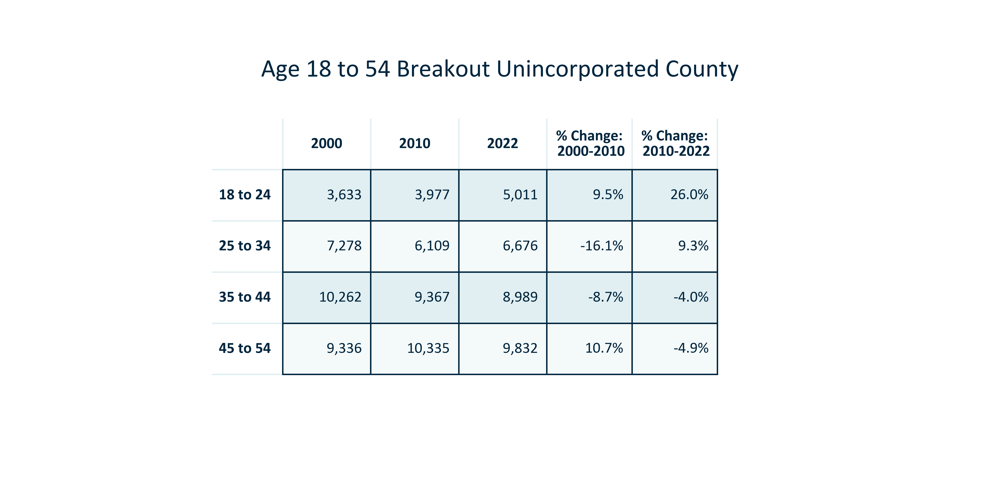

In [42]:
title = 'Age 18 to 54 Breakout Unincorporated County'
df_temp = Primary
df_temp1 = df_temp.loc[df_temp['Year'] != 0.0]
df_temp2 = df_temp.loc[df_temp['Time Frame'] == '2000-2010']
df_temp3 = df_temp.loc[df_temp['Time Frame'] == '2010-2022']
df_temp1 = df_temp1[['Year', 'Age:18 to 24', 'Age:25 to 34', 'Age:35 to 44', 'Age:45 to 54']]
df_temp1 = df_temp1.rename(columns = {'Age:18 to 24': '18 to 24  ', 'Age:25 to 34': '25 to 34  ', 'Age:35 to 44': '35 to 44  ', 'Age:45 to 54': '45 to 54  '})
df_temp1.update(df_temp1[['18 to 24  ', '25 to 34  ', '35 to 44  ', '45 to 54  ']].applymap('{:,.0f}'.format))
df_temp1.update(df_temp1[['Year']].applymap('{:.0f}'.format))
df_temp1 = df_temp1.set_index('Year')
df_temp1 = df_temp1.transpose().reset_index()
df_temp2 = df_temp2[['Time Frame', 'Age:18 to 24 % Change', 'Age:25 to 34 % Change', 'Age:35 to 44 % Change', 'Age:45 to 54 % Change']]
df_temp2.update(df_temp2[['Age:18 to 24 % Change', 'Age:25 to 34 % Change', 'Age:35 to 44 % Change', 'Age:45 to 54 % Change']].applymap('{:,.1f}%'.format))
df_temp2 = df_temp2.set_index('Time Frame')
df_temp2 = df_temp2.transpose().reset_index()
extracted_col = df_temp2['2000-2010']
df_temp1.insert(4, '% Change:\n 2000-2010', extracted_col)
df_temp3 = df_temp3[['Time Frame', 'Age:18 to 24 % Change', 'Age:25 to 34 % Change', 'Age:35 to 44 % Change', 'Age:45 to 54 % Change']]
df_temp3.update(df_temp3[['Age:18 to 24 % Change', 'Age:25 to 34 % Change', 'Age:35 to 44 % Change', 'Age:45 to 54 % Change']].applymap('{:,.1f}%'.format))
df_temp3 = df_temp3.set_index('Time Frame')
df_temp3 = df_temp3.transpose().reset_index()
extracted_col = df_temp3['2010-2022']
df_temp1.insert(5, '% Change:\n 2010-2022', extracted_col)
df_temp = df_temp1.set_index('index')
df_temp = df_temp.rename(columns = {'2000':'      2000      ', '2010':'      2010      ', '2022':'      2022      '})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.8)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/AGE_table_primarygeo_18to54breakout_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_table_primarygeo_18to54breakout_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_table_primarygeo_18to54breakout_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

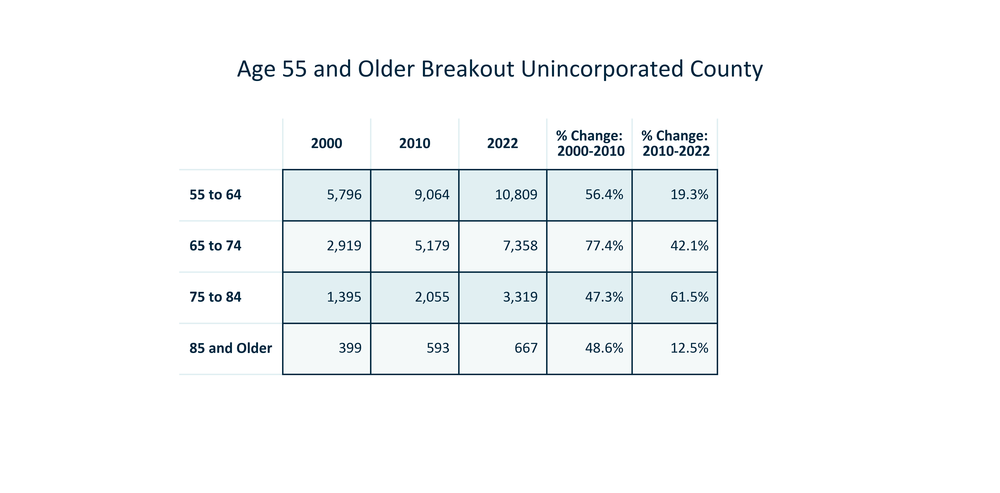

In [43]:
title = 'Age 55 and Older Breakout Unincorporated County'
df_temp = Primary
df_temp1 = df_temp.loc[df_temp['Year'] != 0.0]
df_temp2 = df_temp.loc[df_temp['Time Frame'] == '2000-2010']
df_temp3 = df_temp.loc[df_temp['Time Frame'] == '2010-2022']
df_temp1 = df_temp1[['Year', 'Age:55 to 64', 'Age:65 to 74', 'Age:75 to 84', 'Age:85 and Older']]
df_temp1 = df_temp1.rename(columns = {'Age:55 to 64': '55 to 64  ', 'Age:65 to 74': '65 to 74  ', 'Age:75 to 84': '75 to 84  ', 'Age:85 and Older': '85 and Older '})
df_temp1.update(df_temp1[['55 to 64  ', '65 to 74  ', '75 to 84  ', '85 and Older ']].applymap('{:,.0f}'.format))
df_temp1.update(df_temp1[['Year']].applymap('{:.0f}'.format))
df_temp1 = df_temp1.set_index('Year')
df_temp1 = df_temp1.transpose().reset_index()
df_temp2 = df_temp2[['Time Frame', 'Age:55 to 64 % Change', 'Age:65 to 74 % Change', 'Age:75 to 84 % Change', 'Age:85 and Older % Change']]
df_temp2.update(df_temp2[['Age:55 to 64 % Change', 'Age:65 to 74 % Change', 'Age:75 to 84 % Change', 'Age:85 and Older % Change']].applymap('{:,.1f}%'.format))
df_temp2 = df_temp2.set_index('Time Frame')
df_temp2 = df_temp2.transpose().reset_index()
extracted_col = df_temp2['2000-2010']
df_temp1.insert(4, '% Change:\n 2000-2010', extracted_col)
df_temp3 = df_temp3[['Time Frame', 'Age:55 to 64 % Change', 'Age:65 to 74 % Change', 'Age:75 to 84 % Change', 'Age:85 and Older % Change']]
df_temp3.update(df_temp3[['Age:55 to 64 % Change', 'Age:65 to 74 % Change', 'Age:75 to 84 % Change', 'Age:85 and Older % Change']].applymap('{:,.1f}%'.format))
df_temp3 = df_temp3.set_index('Time Frame')
df_temp3 = df_temp3.transpose().reset_index()
extracted_col = df_temp3['2010-2022']
df_temp1.insert(5, '% Change:\n 2010-2022', extracted_col)
df_temp = df_temp1.set_index('index')
df_temp = df_temp.rename(columns = {'2000':'      2000      ', '2010':'      2010      ', '2022':'      2022      '})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.8)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/AGE_table_primarygeo_55olderbreakout_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_table_primarygeo_55olderbreakout_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_table_primarygeo_55olderbreakout_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

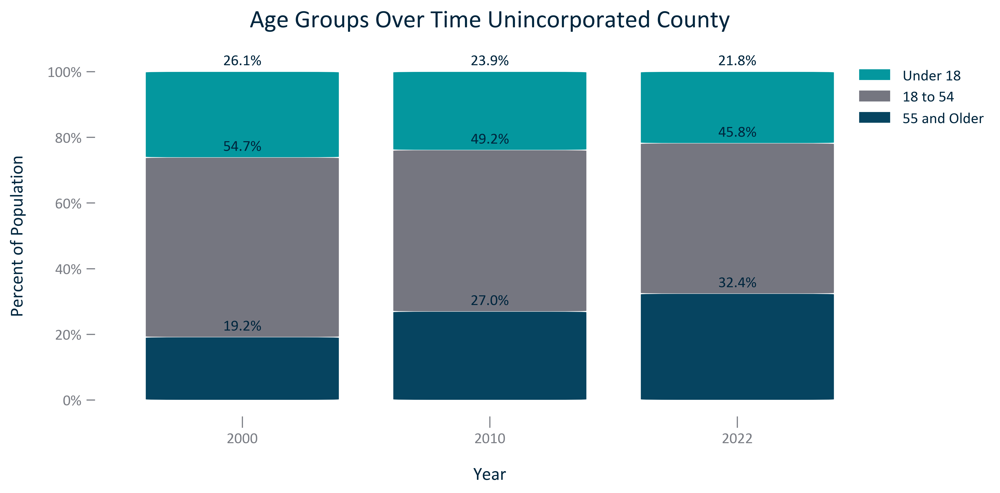

In [44]:
title = 'Age Groups Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year','Age%:55 and Older', 'Age%:18 to 54', 'Age%:Under 18']]
df_temp = df_temp.rename(columns = {'Age%:Under 18': 'Under 18', 'Age%:18 to 54':'18 to 54', 'Age%:55 and Older':'55 and Older'})
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Population') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
y_offset = 2
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/AGE_stackedbar_primarygeo_agegroups_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_stackedbar_primarygeo_agegroups_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_stackedbar_primarygeo_agegroups_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

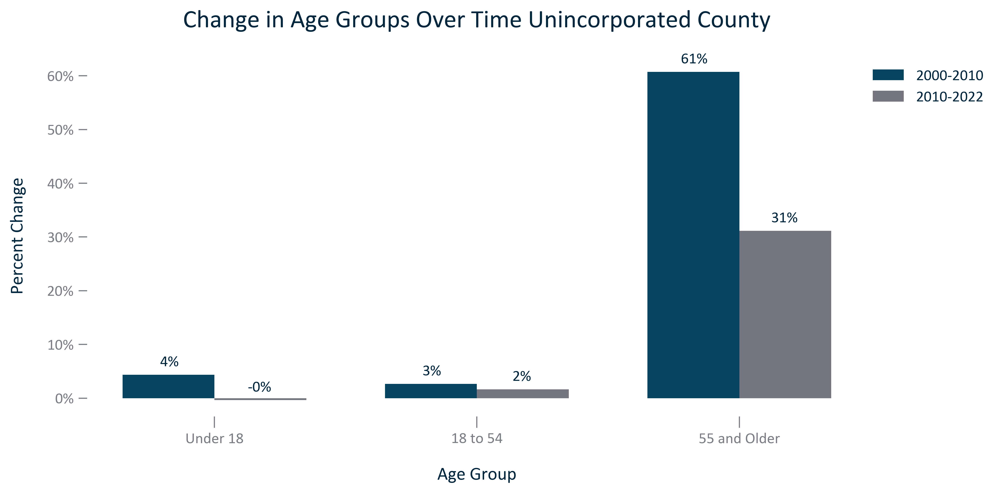

In [45]:
title = 'Change in Age Groups Over Time Unincorporated County'
#set up temporary dataframe
df_temp = Primary.loc[(Primary['Time Frame'] != 'None')&(Primary['Time Frame'] != '2000-2022')]
df_temp = df_temp[['Time Frame','Age:Under 18 % Change', 'Age:18 to 54 % Change', 'Age:55 and Older % Change']]
df_temp = df_temp.rename(columns = {'Age:Under 18 % Change': 'Under 18', 'Age:18 to 54 % Change': '18 to 54', 'Age:55 and Older % Change': '55 and Older'})
df_temp = df_temp.set_index('Time Frame').transpose()
xlabel = 'Age Group'
ylabel = 'Percent Change'
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['2000-2010']
y2 = df_temp['2010-2022']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = '2000-2010')
bar2 = ax.bar(xpos+width/2, y2, width, label = '2010-2022')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left', frameon = False)
#data labels
doubledatalabels(-32, 6, 32, 6, "{:,.0f}%", SMALL_SIZE)
#display and save
fig.savefig('../Figures/AGE_clusterbar_primarygeo_changeingroups_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_clusterbar_primarygeo_changeingroups_overtime.png', bbox_inches='tight')
with open('../Figures/AGE_clusterbar_primarygeo_changeingroups_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

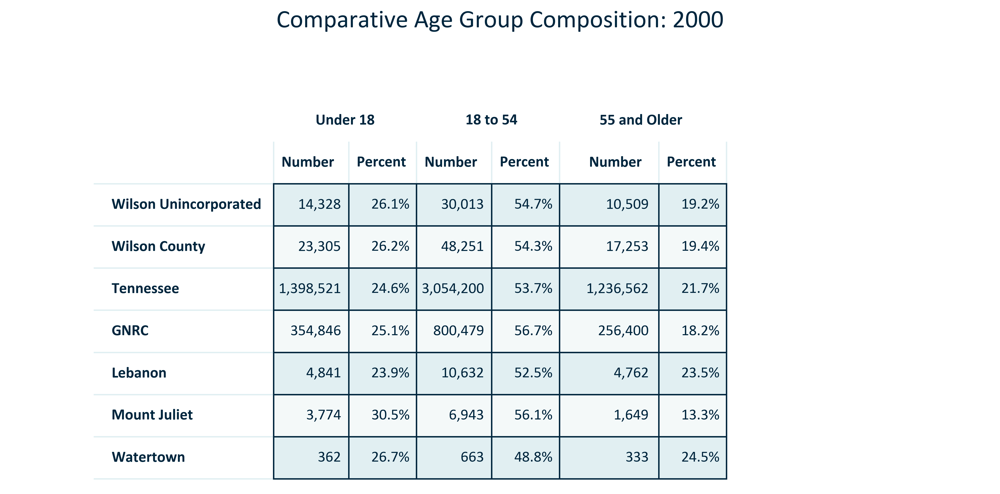

In [46]:
title = 'Comparative Age Group Composition: 2000'
#set up temporary dataframe
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2000.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Age:Under 18', 'Age%:Under 18', 'Age:18 to 54', 'Age%:18 to 54', 'Age:55 and Older', 'Age%:55 and Older']]
df_temp.update(df_temp[['Age%:Under 18', 'Age%:18 to 54', 'Age%:55 and Older']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Age:Under 18', 'Age:18 to 54', 'Age:55 and Older']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['Number  ', ' Percent ', 'Number  ', ' Percent ', 'Number  ', ' Percent ']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['Under 18','', '18 to 54', '', '55 and Older', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
ax.axhline(y = 1, color = 'red')
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/AGE_table_geocomparative_agecomposition_2000.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_table_geocomparative_agecomposition_2000.png', bbox_inches='tight')
with open('../Figures/AGE_table_geocomparative_agecomposition_2000.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census')
plt.show()
plt.close();

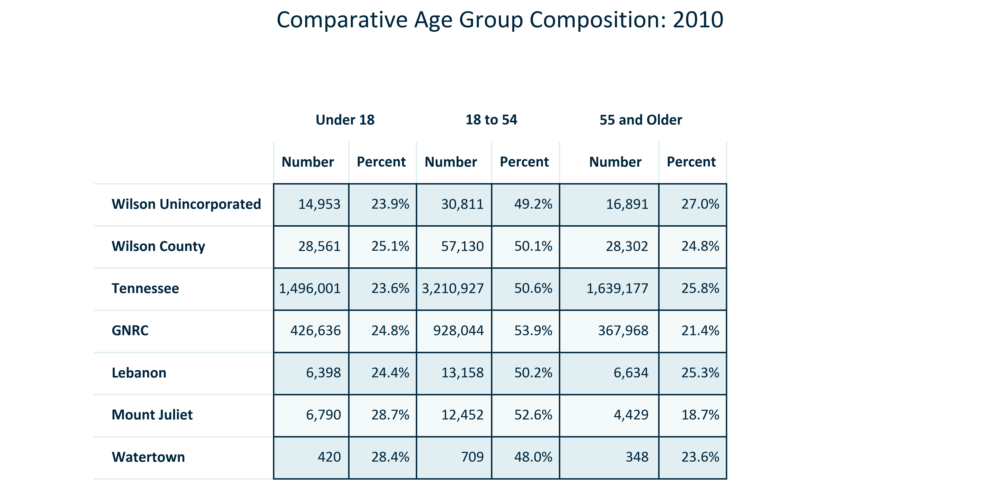

In [47]:
title = 'Comparative Age Group Composition: 2010'
#set up temporary dataframe
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2010.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)

df_temp = df_temp[['Age:Under 18', 'Age%:Under 18', 'Age:18 to 54', 'Age%:18 to 54', 'Age:55 and Older', 'Age%:55 and Older']]
df_temp.update(df_temp[['Age%:Under 18', 'Age%:18 to 54', 'Age%:55 and Older']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Age:Under 18', 'Age:18 to 54', 'Age:55 and Older']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['Number  ', ' Percent ', 'Number  ', ' Percent ', 'Number  ', ' Percent ']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['Under 18','', '18 to 54', '', '55 and Older', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
ax.axhline(y = 1, color = 'red')
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/AGE_table_geocomparative_agecomposition_2010.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_table_geocomparative_agecomposition_2010.png', bbox_inches='tight')
with open('../Figures/AGE_table_geocomparative_agecomposition_2010.txt', 'w') as text_file:
    text_file.write('Citation: 2010 Decennial Census')
plt.show()
plt.close();

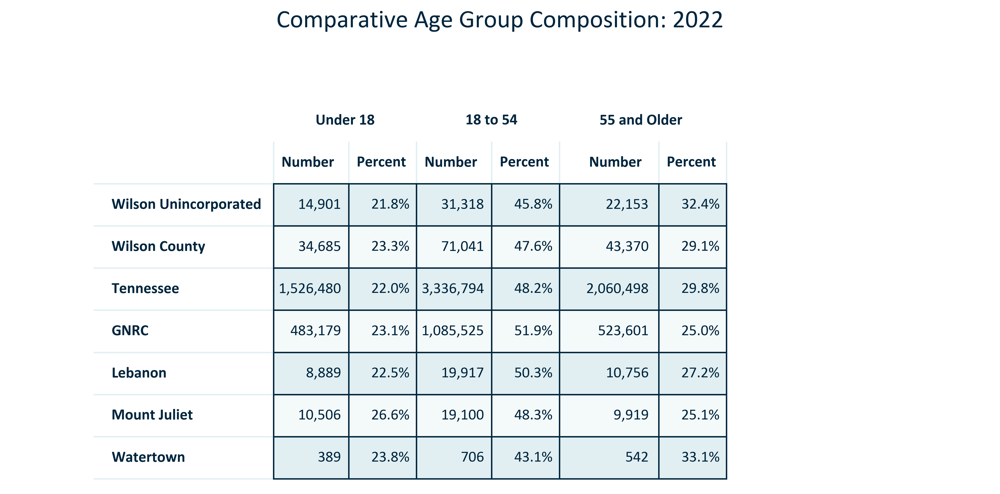

In [48]:
title = 'Comparative Age Group Composition: 2022'
#set up temporary dataframe
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)

df_temp = df_temp[['Age:Under 18', 'Age%:Under 18', 'Age:18 to 54', 'Age%:18 to 54', 'Age:55 and Older', 'Age%:55 and Older']]
df_temp.update(df_temp[['Age%:Under 18', 'Age%:18 to 54', 'Age%:55 and Older']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Age:Under 18', 'Age:18 to 54', 'Age:55 and Older']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['Number  ', ' Percent ', 'Number  ', ' Percent ', 'Number  ', ' Percent ']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['Under 18','', '18 to 54', '', '55 and Older', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
ax.axhline(y = 1, color = 'red')
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
fig.savefig('../Figures/AGE_table_geocomparative_agecomposition_2022.png', bbox_inches='tight')
with open('../Figures/AGE_table_geocomparative_agecomposition_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

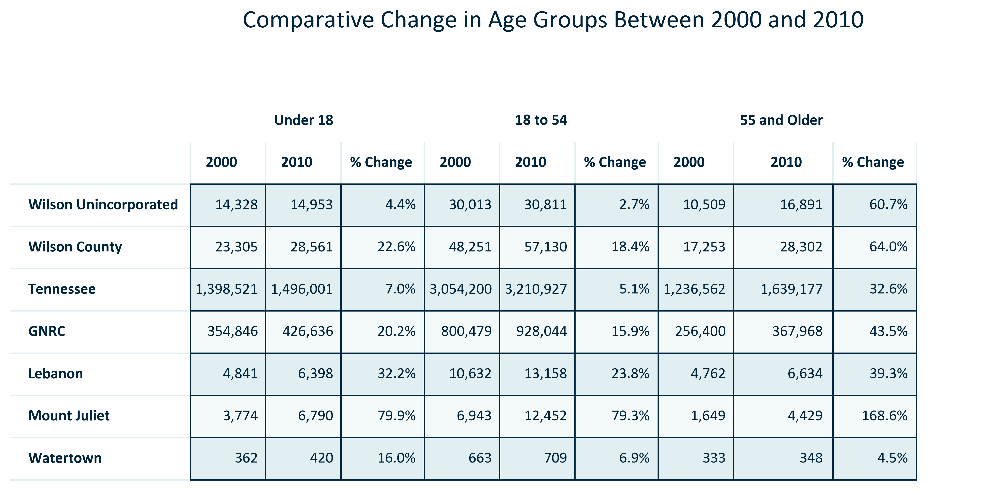

In [49]:
title = 'Comparative Change in Age Groups Between 2000 and 2010'
#set up temporary dataframe
df_temp = reggeost.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)

df_temp = df_temp[['Age:Under 18 2000', 'Age:Under 18 2010', 'Age:18 to 54 2000', 'Age:18 to 54 2010','Age:55 and Older 2000', 'Age:55 and Older 2010']]
#df_temp = df_temp.sort_values(by = 'Age:Under 18 2000', ascending = False)
new = prettypercentchange(df_temp['Age:Under 18 2010'], df_temp['Age:Under 18 2000'])
df_temp.insert(2, 'Percent Change', new)
new = prettypercentchange(df_temp['Age:18 to 54 2010'], df_temp['Age:18 to 54 2000'])
df_temp.insert(5, 'Percent Change1', new)
new = prettypercentchange(df_temp['Age:55 and Older 2010'], df_temp['Age:55 and Older 2000'])
df_temp.insert(8, 'Percent Change2', new)
df_temp.update(df_temp[['Age:Under 18 2000', 'Age:Under 18 2010', 'Age:18 to 54 2000', 'Age:18 to 54 2010','Age:55 and Older 2000',
                        'Age:55 and Older 2010']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['2000      ', '2010      ', ' % Change ', '2000      ', '2010      ', ' % Change ', '2000      ', '2010      ', ' % Change ']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['','Under 18', '', '', '18 to 54', '', '', '55 and Older', '']
doublecols = np.vstack([colstomerge, col_names])
#initiate table and set parameters
table = ax.table(cellText=np.vstack([colstomerge, col_names, df_temp.values]), rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
#mergecells(table, (0,2), (0,3))
mergemultcells(table, [(0,1), (0,2), (0,3)])
mergemultcells(table, [(0,4), (0,5)])
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/AGE_table_geocomparative_changeinagegroups_00to10.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_table_geocomparative_changeinagegroups_00to10.png', bbox_inches='tight')
with open('../Figures/AGE_table_geocomparative_changeinagegroups_00to10.txt', 'w') as text_file:
    text_file.write('Citation: 2000 and 2010 Decennial Census')
plt.show()
plt.close();

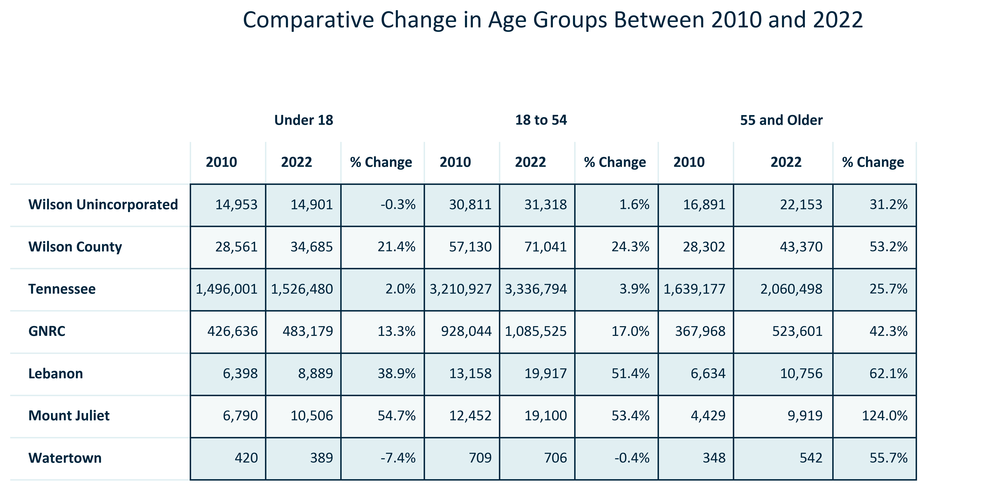

In [50]:
title = 'Comparative Change in Age Groups Between 2010 and 2022'
#set up temporary dataframe
df_temp = reggeost.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)

df_temp = df_temp[['Age:Under 18 2010', 'Age:Under 18 2022', 'Age:18 to 54 2010', 'Age:18 to 54 2022','Age:55 and Older 2010', 'Age:55 and Older 2022']]
new = prettypercentchange(df_temp['Age:Under 18 2022'], df_temp['Age:Under 18 2010'])
df_temp.insert(2, 'Percent Change', new)
new = prettypercentchange(df_temp['Age:18 to 54 2022'], df_temp['Age:18 to 54 2010'])
df_temp.insert(5, 'Percent Change1', new)
new = prettypercentchange(df_temp['Age:55 and Older 2022'], df_temp['Age:55 and Older 2010'])
df_temp.insert(8, 'Percent Change2', new)
df_temp.update(df_temp[['Age:Under 18 2010', 'Age:Under 18 2022', 'Age:18 to 54 2010', 'Age:18 to 54 2022',
                        'Age:55 and Older 2010', 'Age:55 and Older 2022']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['2010      ', '2022      ', ' % Change ', '2010      ', '2022      ', ' % Change ', '2010      ', '2022      ', ' % Change ']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['','Under 18', '', '', '18 to 54', '', '', '55 and Older', '']
doublecols = np.vstack([colstomerge, col_names])
#initiate table and set parameters
table = ax.table(cellText=np.vstack([colstomerge, col_names, df_temp.values]), rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
#mergecells(table, (0,2), (0,3))
mergemultcells(table, [(0,1), (0,2), (0,3)])
mergemultcells(table, [(0,4), (0,5)])
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/AGE_table_geocomparative_changeinagegroups_10to21.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_table_geocomparative_changeinagegroups_10to22.png', bbox_inches='tight')
with open('../Figures/AGE_table_geocomparative_changeinagegroups_10to22.txt', 'w') as text_file:
    text_file.write('Citation: 2010 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

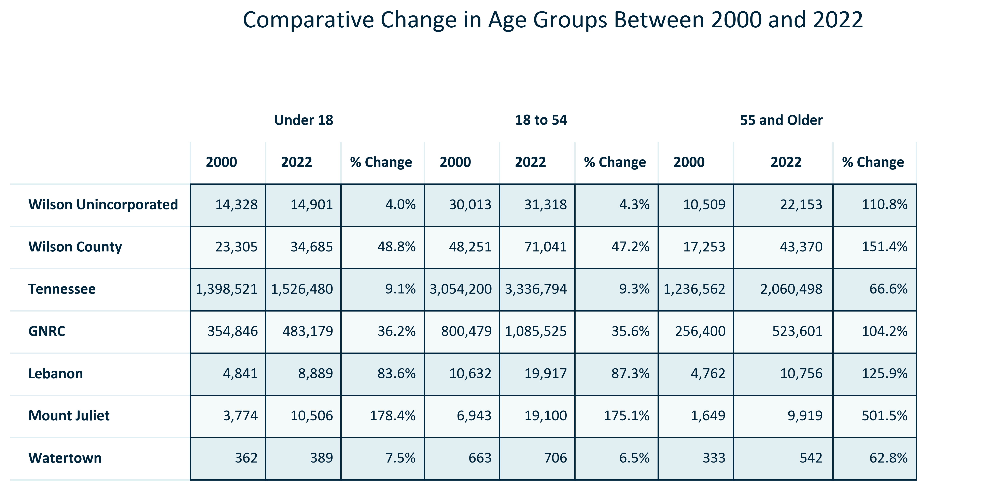

In [51]:
title = 'Comparative Change in Age Groups Between 2000 and 2022'
#set up temporary dataframe
df_temp = reggeost.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)

df_temp = df_temp[['Age:Under 18 2000', 'Age:Under 18 2022', 'Age:18 to 54 2000', 'Age:18 to 54 2022','Age:55 and Older 2000', 'Age:55 and Older 2022']]
new = prettypercentchange(df_temp['Age:Under 18 2022'], df_temp['Age:Under 18 2000'])
df_temp.insert(2, 'Percent Change', new)
new = prettypercentchange(df_temp['Age:18 to 54 2022'], df_temp['Age:18 to 54 2000'])
df_temp.insert(5, 'Percent Change1', new)
new = prettypercentchange(df_temp['Age:55 and Older 2022'], df_temp['Age:55 and Older 2000'])
df_temp.insert(8, 'Percent Change2', new)
df_temp.update(df_temp[['Age:Under 18 2000', 'Age:Under 18 2022', 'Age:18 to 54 2000', 'Age:18 to 54 2022',
                        'Age:55 and Older 2000', 'Age:55 and Older 2022']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['2000      ', '2022      ', ' % Change ', '2000      ', '2022      ', ' % Change ', '2000      ', '2022      ', ' % Change ']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['','Under 18', '', '', '18 to 54', '', '', '55 and Older', '']
doublecols = np.vstack([colstomerge, col_names])
#initiate table and set parameters
table = ax.table(cellText=np.vstack([colstomerge, col_names, df_temp.values]), rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
#mergecells(table, (0,2), (0,3))
mergemultcells(table, [(0,1), (0,2), (0,3)])
mergemultcells(table, [(0,4), (0,5)])
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/AGE_table_geocomparative_changeinagegroups_00to21.svg', bbox_inches='tight')
fig.savefig('../Figures/AGE_table_geocomparative_changeinagegroups_00to22.png', bbox_inches='tight')
with open('../Figures/AGE_table_geocomparative_changeinagegroups_00to22.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

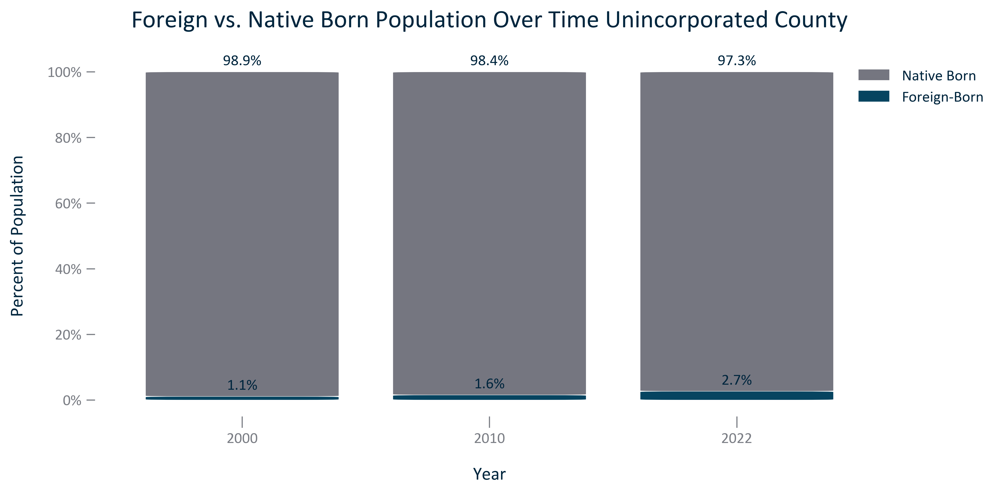

In [52]:
title = 'Foreign vs. Native Born Population Over Time Unincorporated County'
df_temp = Primary
df_temp = df_temp.loc[df_temp['Year'] != 0.0]
df_temp = df_temp[['Year', 'Foreign Born Population %', 'Native Born Population %']]
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
#df_temp.update(df_temp[['Foreign Born Population %', 'Native Born Population %']].applymap('{:.2f}%'.format))
df_temp = df_temp.rename(columns = {'Foreign Born Population %':'Foreign-Born', 'Native Born Population %':'Native Born'})
df_temp = df_temp.set_index('Year')
df_temp
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Population') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
y_offset = 2
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/FOREIGNBORN_stackedbar_primarygeo_shareforeignandnativeborn_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_stackedbar_primarygeo_shareforeignandnativeborn_overtime.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_stackedbar_primarygeo_shareforeignandnativeborn_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, {}'.format(acs))
plt.show()
plt.close();

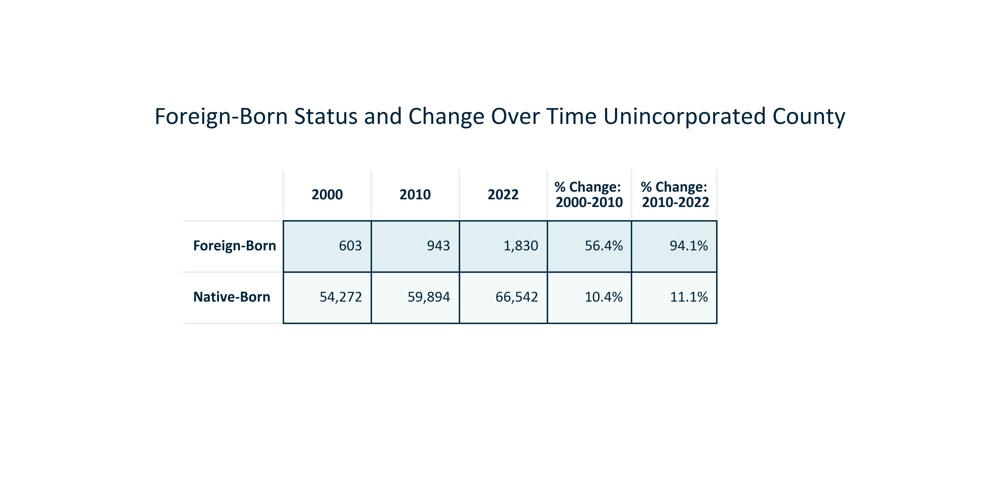

In [53]:
title = 'Foreign-Born Status and Change Over Time Unincorporated County'
df_temp = Primary
df_temp1 = df_temp.loc[df_temp['Year'] != 0.0]
df_temp2 = df_temp.loc[df_temp['Time Frame'] == '2000-2010']
df_temp3 = df_temp.loc[df_temp['Time Frame'] == '2010-2022']
df_temp1 = df_temp1[['Year', 'Foreign Born Population', 'Native Born Population']]
df_temp1.update(df_temp1[['Foreign Born Population', 'Native Born Population']].applymap('{:,.0f}'.format))
df_temp1.update(df_temp1[['Year']].applymap('{:.0f}'.format))
df_temp1 = df_temp1.set_index('Year')
df_temp1 = df_temp1.rename(columns = {'Foreign Born Population':'Foreign-Born', 'Native Born Population': 'Native-Born'}) 
df_temp1 = df_temp1.transpose().reset_index()
df_temp2 = df_temp2[['Time Frame', 'Foreign Born Population % Change', 'Native Born Population % Change']]
df_temp2.update(df_temp2[['Foreign Born Population % Change', 'Native Born Population % Change']].applymap('{:,.1f}%'.format))
df_temp2 = df_temp2.set_index('Time Frame')
df_temp2 = df_temp2.transpose().reset_index()
extracted_col = df_temp2['2000-2010']
df_temp1.insert(4, '% Change: \n2000-2010', extracted_col)
df_temp3 = df_temp3[['Time Frame', 'Foreign Born Population % Change', 'Native Born Population % Change']]
df_temp3.update(df_temp3[['Foreign Born Population % Change', 'Native Born Population % Change']].applymap('{:,.1f}%'.format))
df_temp3 = df_temp3.set_index('Time Frame')
df_temp3 = df_temp3.transpose().reset_index()
extracted_col = df_temp3['2010-2022']
df_temp1.insert(5, '% Change:\n 2010-2022', extracted_col)
df_temp = df_temp1.set_index('index')
df_temp = df_temp.rename(columns = {'2000':'      2000      ', '2010':'      2010      ', '2022':'      2022      '})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.7)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
# #display and save
fig.savefig('../Figures/FOREIGNBORN_table_primarygeo_foreignbornstatusandchange_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_primarygeo_foreignbornstatusandchange_overtime.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_primarygeo_foreignbornstatusandchange_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and , {}'.format(acs))
plt.show()
plt.close();

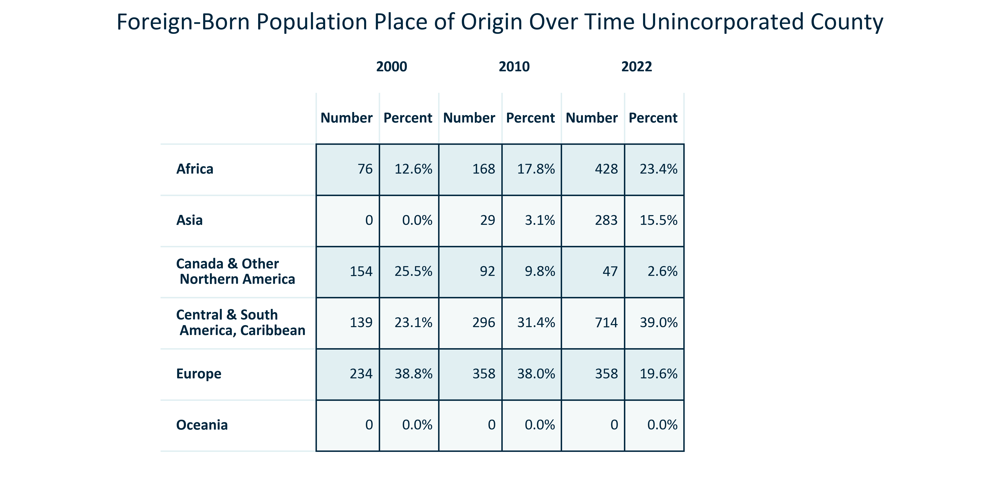

In [54]:
title = 'Foreign-Born Population Place of Origin Over Time Unincorporated County'
#set up temporary dataframe
df_temp = Primaryt
next_line = ['Number2000', 'Percent2000', 'Number2010', 'Percent2010', 'Number2022', 'Percent2022']
df_temp1 = df_temp[['ForeignBorn:Europe 2000', 'ForeignBorn%:Europe 2000',
                    'ForeignBorn:Europe 2010', 'ForeignBorn%:Europe 2010',
                    'ForeignBorn:Europe 2022', 'ForeignBorn%:Europe 2022']]
df_temp1.columns = next_line
df_temp2 = df_temp[['ForeignBorn:Asia 2000', 'ForeignBorn%:Asia 2000',
                    'ForeignBorn:Asia 2010', 'ForeignBorn%:Asia 2010',
                    'ForeignBorn:Asia 2022', 'ForeignBorn%:Asia 2022']]
df_temp2.columns = next_line
df_temp3 = df_temp[['ForeignBorn:Africa 2000', 'ForeignBorn%:Africa 2000',
                    'ForeignBorn:Africa 2010', 'ForeignBorn%:Africa 2010',
                    'ForeignBorn:Africa 2022', 'ForeignBorn%:Africa 2022']]
df_temp3.columns = next_line
df_temp4 = df_temp[['ForeignBorn:Oceania 2000', 'ForeignBorn%:Oceania 2000',
                    'ForeignBorn:Oceania 2010', 'ForeignBorn%:Oceania 2010',
                    'ForeignBorn:Oceania 2022', 'ForeignBorn%:Oceania 2022']]
df_temp4.columns = next_line
df_temp5 = df_temp[['ForeignBorn:Central & South America, Caribbean 2000', 'ForeignBorn%:Central & South America, Caribbean 2000',
                    'ForeignBorn:Central & South America, Caribbean 2010', 'ForeignBorn%:Central & South America, Caribbean 2010',
                    'ForeignBorn:Central & South America, Caribbean 2022', 'ForeignBorn%:Central & South America, Caribbean 2022']]
df_temp5.columns = next_line
df_temp6 = df_temp[['ForeignBorn:Canada & Other Northern American 2000', 'ForeignBorn%:Canada & Other Northern American 2000',
                    'ForeignBorn:Canada & Other Northern American 2010', 'ForeignBorn%:Canada & Other Northern American 2010',
                    'ForeignBorn:Canada & Other Northern American 2022', 'ForeignBorn%:Canada & Other Northern American 2022']]
df_temp6.columns = next_line
dfs = [df_temp2, df_temp3, df_temp6, df_temp5, df_temp1, df_temp4]
df_temp = pd.concat(dfs)
newindex = ['Africa', 'Asia', 'Canada & Other\n Northern America', 'Central & South\n America, Caribbean', 'Europe', 'Oceania']
df_temp = df_temp.set_axis(newindex)
df_temp.update(df_temp[['Number2000', 'Number2010', 'Number2022']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Percent2000', 'Percent2010', 'Percent2022']].applymap('{:.1f}%'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['2000','', '2010', '', '2022', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.9)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
# #display and save
#fig.savefig('../Figures/FOREIGNBORN_table_primarygeo_foreignbornorigin_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_primarygeo_foreignbornorigin_overtime.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_primarygeo_foreignbornorigin_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000, 2010, {}'.format(acs))
plt.show()
plt.close();

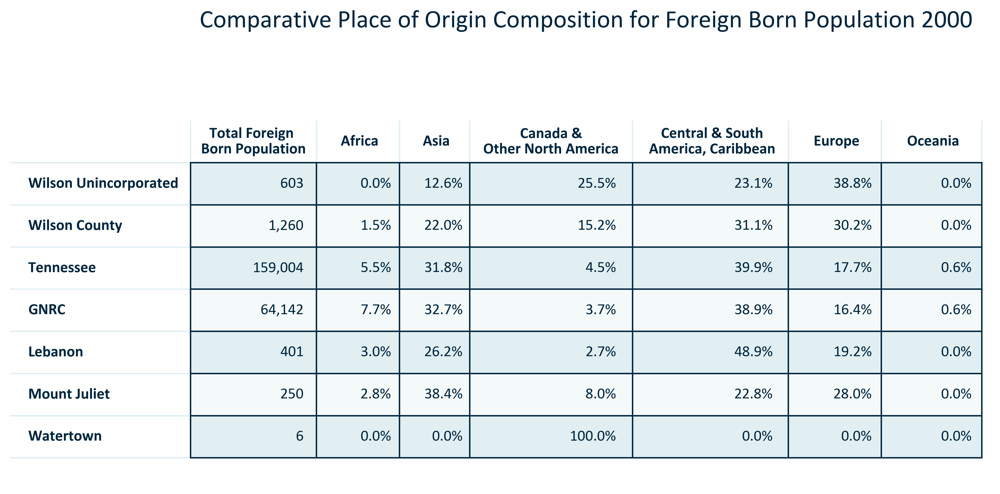

In [55]:
title = 'Comparative Place of Origin Composition for Foreign Born Population 2000'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2000.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Foreign Born Population', 'ForeignBorn%:Africa', 'ForeignBorn%:Asia', 'ForeignBorn%:Canada & Other Northern American', 
                   'ForeignBorn%:Central & South America, Caribbean', 'ForeignBorn%:Europe', 'ForeignBorn%:Oceania']]
df_temp.update(df_temp[['ForeignBorn%:Europe', 
                   'ForeignBorn%:Asia', 'ForeignBorn%:Africa', 
                   'ForeignBorn%:Oceania', 'ForeignBorn%:Central & South America, Caribbean',
                  'ForeignBorn%:Canada & Other Northern American']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Foreign Born Population']].applymap('{:,.0f}'.format))
df_temp = df_temp.rename(columns = {'ForeignBorn%:Europe':'     Europe    ', 
                                    'ForeignBorn%:Asia':'     Asia    ', 'ForeignBorn%:Africa':'     Africa    ', 
                                    'ForeignBorn%:Oceania':  '     Oceania    ', 
                                    'ForeignBorn%:Central & South America, Caribbean':' Central & South\n America, Caribbean',
                                    'ForeignBorn%:Canada & Other Northern American':' Canada & \nOther North America', 
                                    'Foreign Born Population': 'Total Foreign \nBorn Population'})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2000.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2000.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2000.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census')
plt.show()
plt.close();

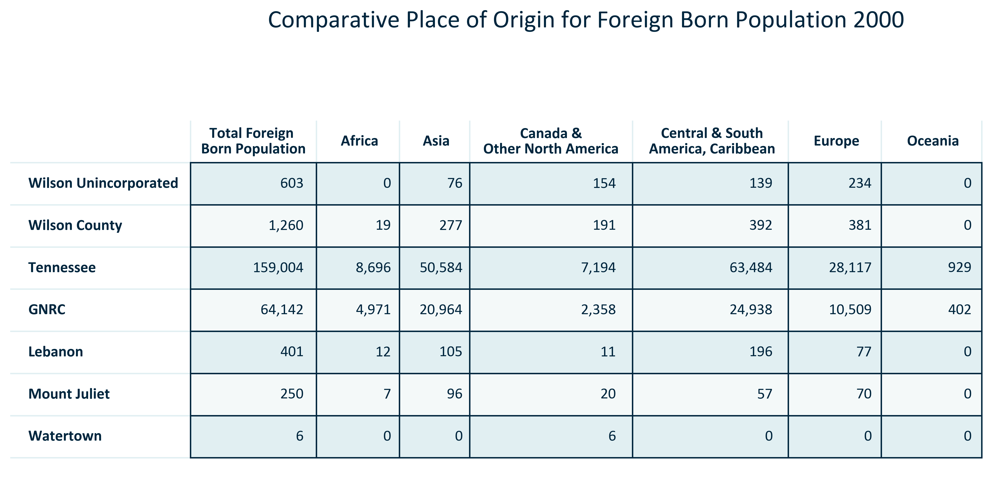

In [56]:
title = 'Comparative Place of Origin for Foreign Born Population 2000'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2000.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Foreign Born Population', 'ForeignBorn:Africa', 'ForeignBorn:Asia', 'ForeignBorn:Canada & Other Northern American', 
                   'ForeignBorn:Central & South America, Caribbean', 'ForeignBorn:Europe', 'ForeignBorn:Oceania']]
df_temp.update(df_temp[['ForeignBorn:Europe', 
                   'ForeignBorn:Asia', 'ForeignBorn:Africa', 
                   'ForeignBorn:Oceania', 'ForeignBorn:Central & South America, Caribbean',
                  'ForeignBorn:Canada & Other Northern American']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Foreign Born Population']].applymap('{:,.0f}'.format))
df_temp = df_temp.rename(columns = {'ForeignBorn:Europe':'     Europe    ', 
                                    'ForeignBorn:Asia':'     Asia    ', 'ForeignBorn:Africa':'     Africa    ', 
                                    'ForeignBorn:Oceania':  '     Oceania    ', 
                                    'ForeignBorn:Central & South America, Caribbean':' Central & South\n America, Caribbean',
                                    'ForeignBorn:Canada & Other Northern American':' Canada & \nOther North America', 
                                    'Foreign Born Population': 'Total Foreign \nBorn Population'})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2000.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2000.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2000.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census')
plt.show()
plt.close();

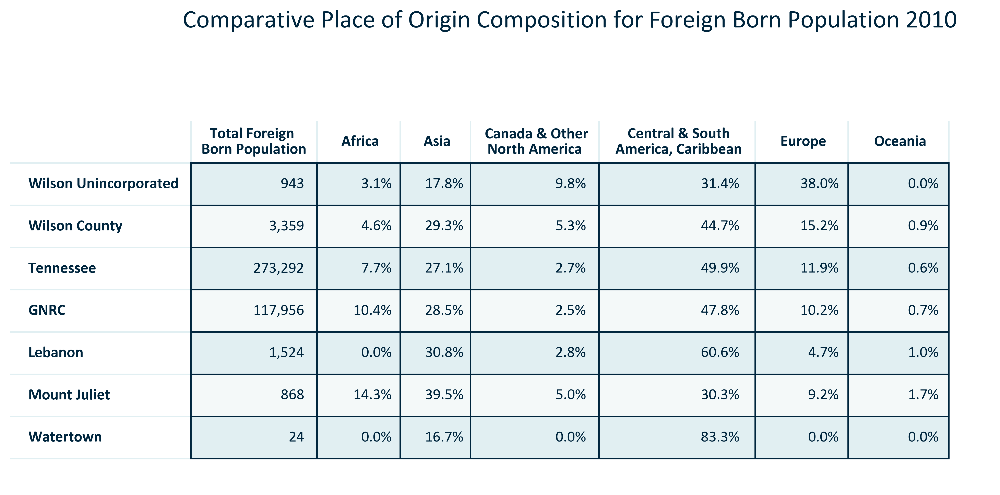

In [57]:
title = 'Comparative Place of Origin Composition for Foreign Born Population 2010'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2010.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Foreign Born Population', 'ForeignBorn%:Africa', 'ForeignBorn%:Asia', 'ForeignBorn%:Canada & Other Northern American', 
                   'ForeignBorn%:Central & South America, Caribbean', 'ForeignBorn%:Europe', 'ForeignBorn%:Oceania']]
df_temp.update(df_temp[['ForeignBorn%:Europe', 
                   'ForeignBorn%:Asia', 'ForeignBorn%:Africa', 
                   'ForeignBorn%:Oceania', 'ForeignBorn%:Central & South America, Caribbean',
                  'ForeignBorn%:Canada & Other Northern American']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Foreign Born Population']].applymap('{:,.0f}'.format))
df_temp = df_temp.rename(columns = {'ForeignBorn%:Europe':'     Europe    ', 
                                    'ForeignBorn%:Asia':'     Asia    ', 'ForeignBorn%:Africa':'     Africa    ', 
                                    'ForeignBorn%:Oceania':  '     Oceania    ', 
                                    'ForeignBorn%:Central & South America, Caribbean':' Central & South\n America, Caribbean',
                                    'ForeignBorn%:Canada & Other Northern American':' Canada & Other\nNorth America', 
                                    'Foreign Born Population': 'Total Foreign \nBorn Population'})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2010.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2010.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2010.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 American Community Survey 5-Year Estimates')
plt.show()
plt.close();

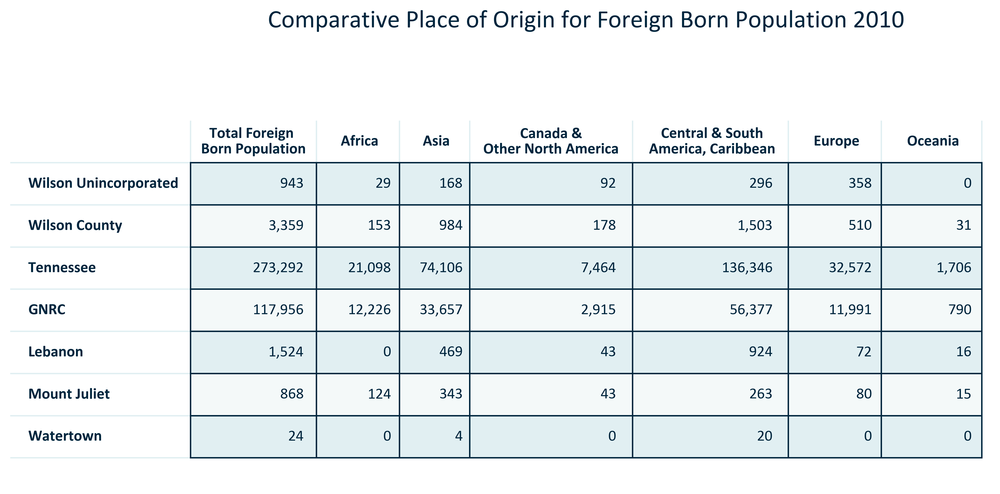

In [58]:
title = 'Comparative Place of Origin for Foreign Born Population 2010'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2010.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Foreign Born Population', 'ForeignBorn:Africa', 'ForeignBorn:Asia', 'ForeignBorn:Canada & Other Northern American', 
                   'ForeignBorn:Central & South America, Caribbean', 'ForeignBorn:Europe', 'ForeignBorn:Oceania']]
df_temp.update(df_temp[['ForeignBorn:Europe', 
                   'ForeignBorn:Asia', 'ForeignBorn:Africa', 
                   'ForeignBorn:Oceania', 'ForeignBorn:Central & South America, Caribbean',
                  'ForeignBorn:Canada & Other Northern American']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Foreign Born Population']].applymap('{:,.0f}'.format))
df_temp = df_temp.rename(columns = {'ForeignBorn:Europe':'     Europe    ', 
                                    'ForeignBorn:Asia':'     Asia    ', 'ForeignBorn:Africa':'     Africa    ', 
                                    'ForeignBorn:Oceania':  '     Oceania    ', 
                                    'ForeignBorn:Central & South America, Caribbean':' Central & South\n America, Caribbean',
                                    'ForeignBorn:Canada & Other Northern American':' Canada & \nOther North America', 
                                    'Foreign Born Population': 'Total Foreign \nBorn Population'})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2010.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2010.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2010.txt', 'w') as text_file:
    text_file.write('Citation: 2006-2010 American Community Survey 5-Year Estimates')
plt.show()
plt.close();

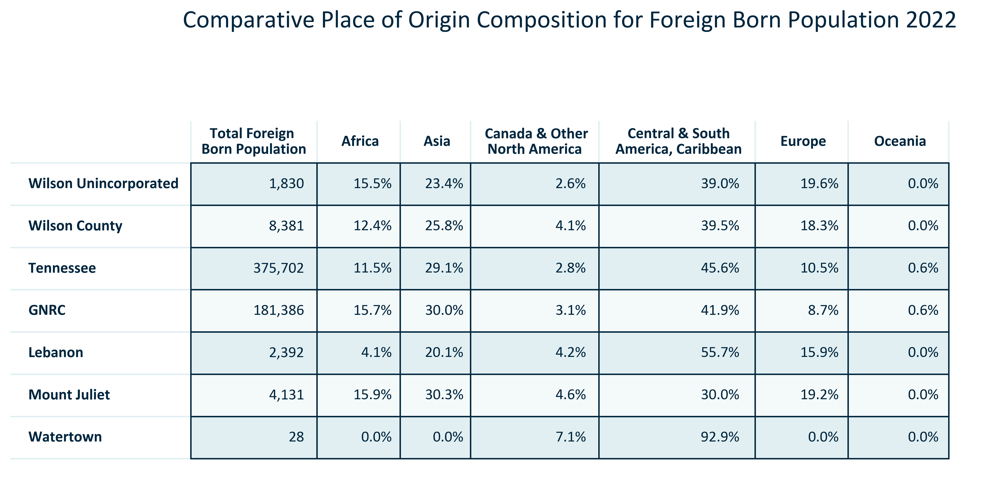

In [59]:
title = 'Comparative Place of Origin Composition for Foreign Born Population 2022'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Foreign Born Population', 'ForeignBorn%:Africa', 'ForeignBorn%:Asia', 'ForeignBorn%:Canada & Other Northern American', 
                   'ForeignBorn%:Central & South America, Caribbean', 'ForeignBorn%:Europe', 'ForeignBorn%:Oceania']]
df_temp.update(df_temp[['ForeignBorn%:Europe', 
                   'ForeignBorn%:Asia', 'ForeignBorn%:Africa', 
                   'ForeignBorn%:Oceania', 'ForeignBorn%:Central & South America, Caribbean',
                  'ForeignBorn%:Canada & Other Northern American']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Foreign Born Population']].applymap('{:,.0f}'.format))
df_temp = df_temp.rename(columns = {'ForeignBorn%:Europe':'     Europe    ', 
                                    'ForeignBorn%:Asia':'     Asia    ', 'ForeignBorn%:Africa':'     Africa    ', 
                                    'ForeignBorn%:Oceania':  '     Oceania    ', 
                                    'ForeignBorn%:Central & South America, Caribbean':' Central & South\n America, Caribbean',
                                    'ForeignBorn%:Canada & Other Northern American':' Canada & Other\nNorth America', 
                                    'Foreign Born Population': 'Total Foreign \nBorn Population'})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2022.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_geocomparative_percentplaceoforigin_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

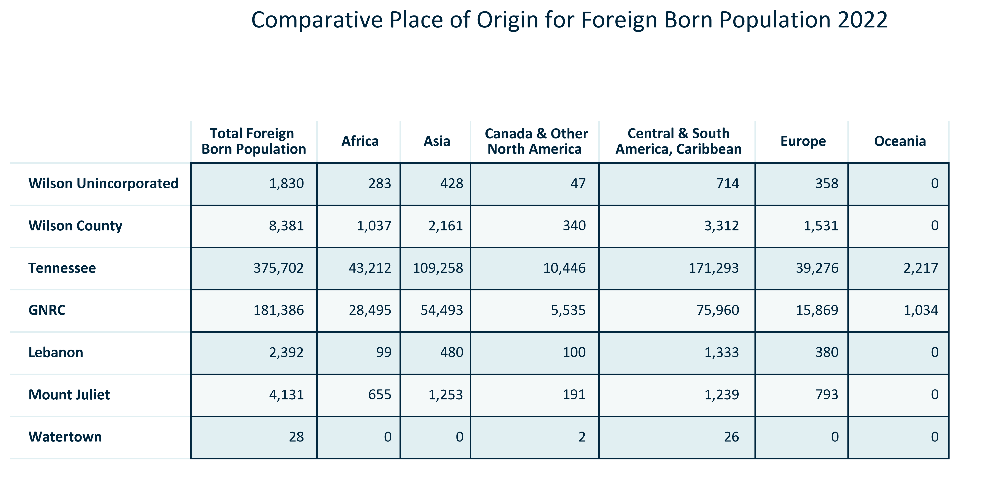

In [60]:
title = 'Comparative Place of Origin for Foreign Born Population 2022'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Foreign Born Population', 'ForeignBorn:Africa', 'ForeignBorn:Asia', 'ForeignBorn:Canada & Other Northern American', 
                   'ForeignBorn:Central & South America, Caribbean', 'ForeignBorn:Europe', 'ForeignBorn:Oceania']]
df_temp.update(df_temp[['ForeignBorn:Europe', 
                   'ForeignBorn:Asia', 'ForeignBorn:Africa', 
                   'ForeignBorn:Oceania', 'ForeignBorn:Central & South America, Caribbean',
                  'ForeignBorn:Canada & Other Northern American']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Foreign Born Population']].applymap('{:,.0f}'.format))
df_temp = df_temp.rename(columns = {'ForeignBorn:Europe':'     Europe    ', 
                                    'ForeignBorn:Asia':'     Asia    ', 'ForeignBorn:Africa':'     Africa    ', 
                                    'ForeignBorn:Oceania':  '     Oceania    ', 
                                    'ForeignBorn:Central & South America, Caribbean':' Central & South\n America, Caribbean',
                                    'ForeignBorn:Canada & Other Northern American':' Canada & Other\nNorth America', 
                                    'Foreign Born Population': 'Total Foreign \nBorn Population'})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2022.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_geocomparative_numberplaceoforigin_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

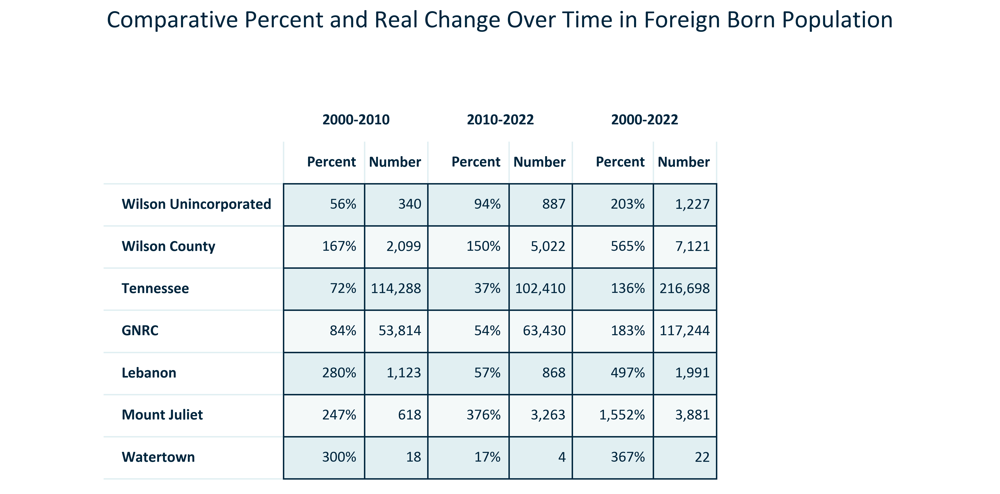

In [61]:
title = 'Comparative Percent and Real Change Over Time in Foreign Born Population'
df_temp = reggeos
df_temp1 = df_temp.sort_values(by = 'NAME')
df_temp1 = df_temp1.loc[df_temp1['Time Frame'] == '2000-2010'].set_index('NAME')
df_temp1 = df_temp1[['Foreign Born Population % Change', 'Foreign Born Population Change']]
df_temp1.update(df_temp1[['Foreign Born Population % Change']].applymap('{:,.0f}%'.format))
df_temp1.update(df_temp1[['Foreign Born Population Change']].applymap('{:,.0f}'.format))
df_temp1 = df_temp1.rename(columns = {'Foreign Born Population % Change':'Percent0010', 
                                    'Foreign Born Population Change':'Number0010'})
df_temp2 = df_temp.sort_values(by = 'Population', ascending = False)
df_temp2 = df_temp2.loc[df_temp2['Time Frame'] == '2010-2022'].set_index('NAME')
df_temp2 = df_temp2[['Foreign Born Population % Change', 'Foreign Born Population Change']]
df_temp2.update(df_temp2[['Foreign Born Population % Change']].applymap('{:,.0f}%'.format))
df_temp2.update(df_temp2[['Foreign Born Population Change']].applymap('{:,.0f}'.format))
df_temp2 = df_temp2.rename(columns = {'Foreign Born Population % Change':'Percent1021', 
                                    'Foreign Born Population Change':'Number1021'})
df_temp3 = df_temp.sort_values(by = 'Population', ascending = False)
df_temp3 = df_temp3.loc[df_temp3['Time Frame'] == '2000-2022'].set_index('NAME')
df_temp3 = df_temp3[['Foreign Born Population % Change', 'Foreign Born Population Change']]
df_temp3.update(df_temp3[['Foreign Born Population % Change']].applymap('{:,.0f}%'.format))
df_temp3.update(df_temp3[['Foreign Born Population Change']].applymap('{:,.0f}'.format))
df_temp3 = df_temp3.rename(columns = {'Foreign Born Population % Change':'Percent0021', 
                                    'Foreign Born Population Change':'Number0021'})
dfs = [df_temp2, df_temp3]
df_temp = pd.concat([df_temp1, df_temp2], axis = 1)
df_temp = pd.concat([df_temp, df_temp3], axis = 1)
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#2000-2010, 2010-2021, 2000-2021
col_names = ['Percent', 'Number', 'Percent', 'Number', 'Percent', 'Number']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['2000-2010','', '2010-2022', '', '2000-2022', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_allchangeforeignborn_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_geocomparative_allchangeforeignborn_overtime.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_geocomparative_allchangeforeignborn_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

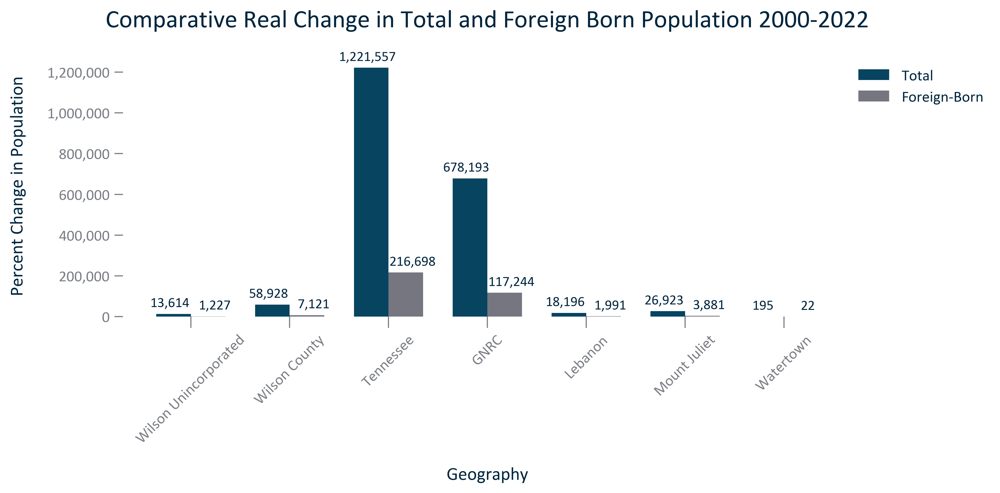

In [62]:
title = 'Comparative Real Change in Total and Foreign Born Population 2000-2022'
df_temp = reggeos.loc[reggeos['Time Frame'] == '2000-2022'].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['Population Change']
y2 = df_temp['Foreign Born Population Change']
xlabel = 'Geography'
ylabel = 'Percent Change in Population'
width = 0.35
#initiate
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = 'Total')
bar2 = ax.bar(xpos+width/2, y2, width, label = 'Foreign-Born')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left', frameon = False)
#data labels
#data labels
doubledatalabels(-15, 5, 17, 5, "{:,.0f}", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/FOREIGNBORN_clusterbar_geocomparative_realchangetotalvsforeignborn_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_clusterbar_geocomparative_realchangetotalvsforeignborn_overtime.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_clusterbar_geocomparative_realchangetotalvsforeignborn_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, {}, 2020 PL'.format(acs))
plt.show()
plt.close();

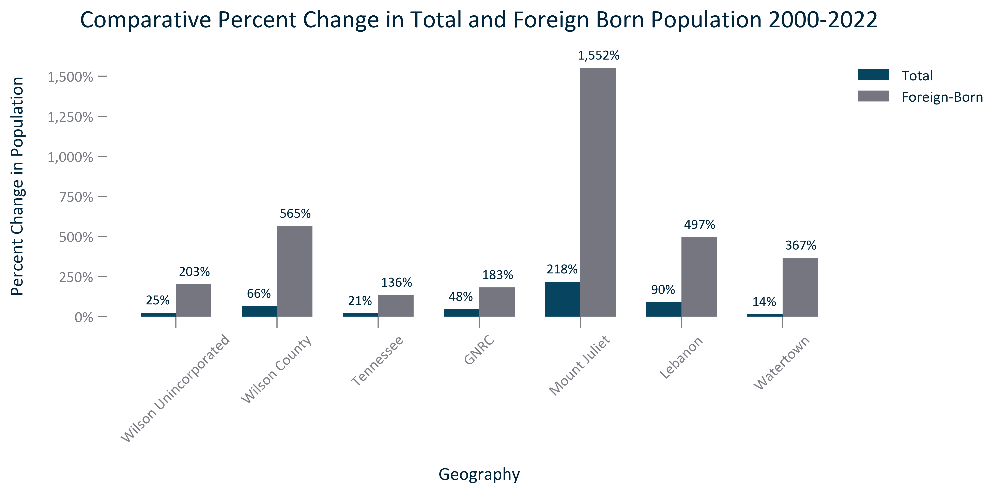

In [63]:
title = 'Comparative Percent Change in Total and Foreign Born Population 2000-2022'
df_temp = reggeos.sort_values(by = 'Population', ascending = False)
#df_temp = df_temp.loc[(df_temp['NAME'] != 'US')&(df_temp['NAME'] != 'Mitchellville')&(df_temp['NAME'] != 'Millersville')&(df_temp['NAME'] != 'Westmoreland')]
df_temp = df_temp.loc[df_temp['Time Frame'] == '2000-2022'].set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['Population % Change']
y2 = df_temp['Foreign Born Population % Change']
xlabel = 'Geography'
ylabel = 'Percent Change in Population'
width = 0.35
#initiate
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = 'Total')
bar2 = ax.bar(xpos+width/2, y2, width, label = 'Foreign-Born')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left', frameon = False)
#data labels
#data labels
doubledatalabels(-13, 6, 13, 6, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/FOREIGNBORN_clusterbar_geocomparative_percentchangetotalvsforeignborn_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_clusterbar_geocomparative_percentchangetotalvsforeignborn_overtime.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_clusterbar_geocomparative_percentchangetotalvsforeignborn_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, {}, 2020 PL'.format(acs))
plt.show()
plt.close();

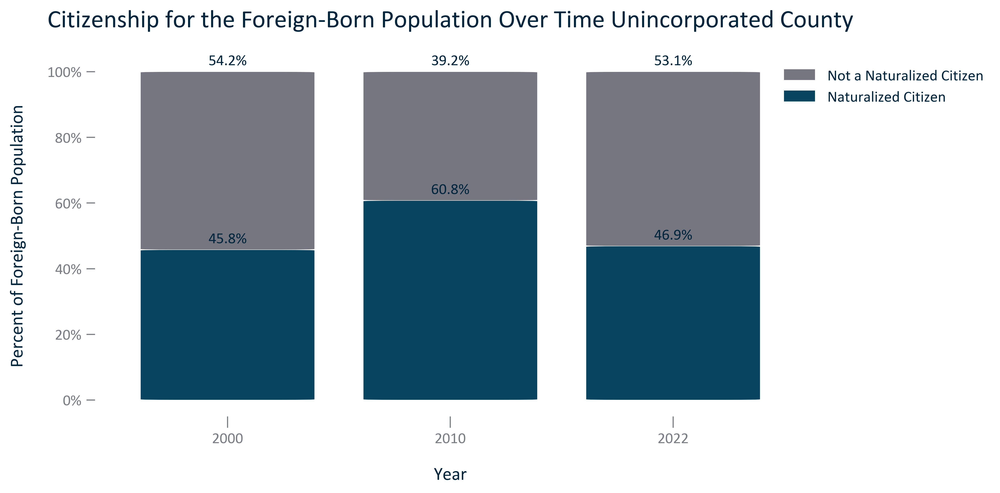

In [64]:
title = 'Citizenship for the Foreign-Born Population Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year', 'Nativity and Citizenship%:Foreign Born Population that is Naturalized Citizen', 
                   'Nativity and Citizenship%:Foreign Born Population that is Not a US Citizen']]
df_temp = df_temp.rename(columns = {'Nativity and Citizenship%:Foreign Born Population that is Naturalized Citizen': 'Naturalized Citizen', 
                                    'Nativity and Citizenship%:Foreign Born Population that is Not a US Citizen': 'Not a Naturalized Citizen'})
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Foreign-Born Population') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/FOREIGNBORN_stackedbar_primarygeo_sharefbcitizenandnot_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_stackedbar_primarygeo_sharefbcitizenandnot_overtime.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_stackedbar_primarygeo_sharefbcitizenandnot_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

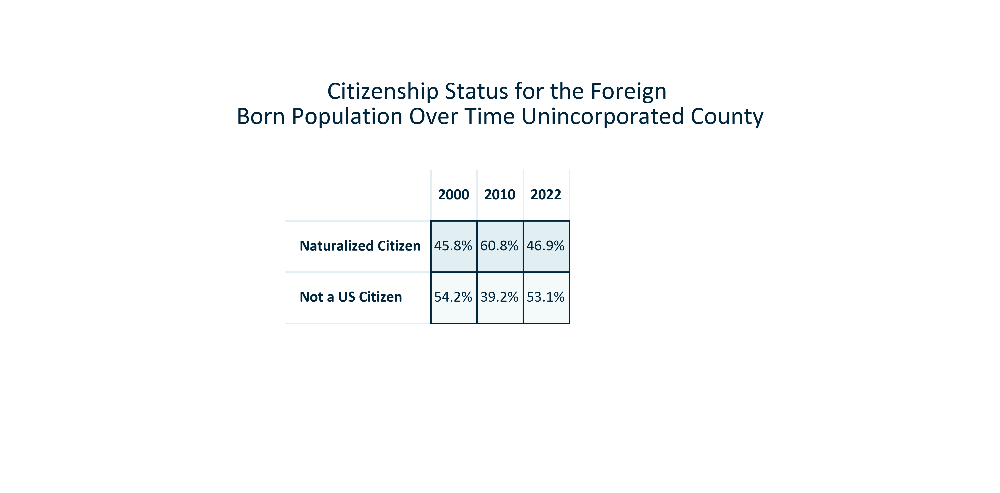

In [65]:
title = 'Citizenship Status for the Foreign \nBorn Population Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year', 'Nativity and Citizenship%:Foreign Born Population that is Naturalized Citizen', 
                     'Nativity and Citizenship%:Foreign Born Population that is Not a US Citizen']]
df_temp = df_temp.rename(columns = {'Nativity and Citizenship%:Foreign Born Population that is Naturalized Citizen': 'Naturalized Citizen', 
                     'Nativity and Citizenship%:Foreign Born Population that is Not a US Citizen': 'Not a US Citizen'})
df_temp.update(df_temp[['Naturalized Citizen', 'Not a US Citizen']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.set_index('Year').transpose()
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
# #set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.7)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/FOREIGNBORN_table_primarygeo_citizenshipstatus_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/FOREIGNBORN_table_primarygeo_citizenshipstatus_overtime.png', bbox_inches='tight')
with open('../Figures/FOREIGNBORN_table_primarygeo_citizenshipstatus_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

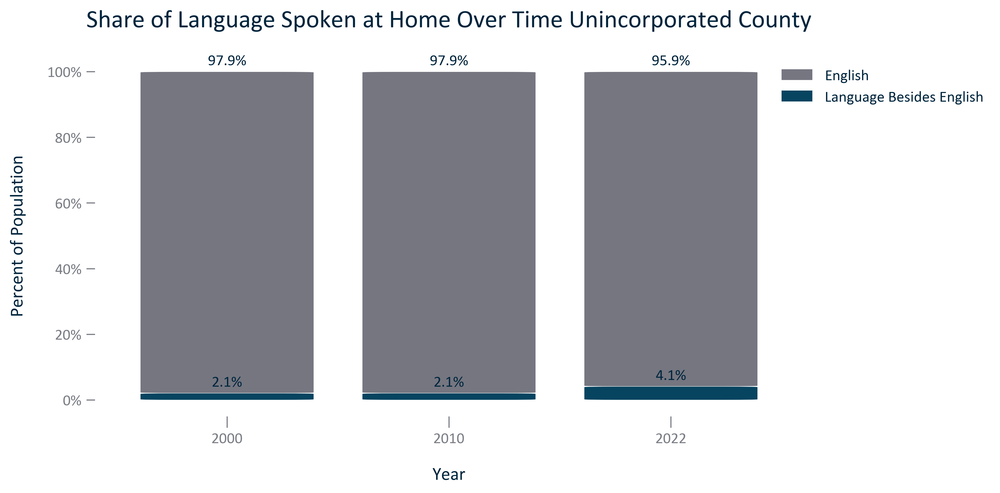

In [66]:
title = 'Share of Language Spoken at Home Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year', 'Language%:Speak Language Besides English', 'Language%:Speak Only English']]
df_temp = df_temp.rename(columns = {'Language%:Speak Language Besides English': 'Language Besides English', 'Language%:Speak Only English': 'English' })
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
#plt.locator_params(axis='x', nbins = 4)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Population') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
# For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/LANGUAGE_stackedbar_primarygeo_shareenglishornon_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/LANGUAGE_stackedbar_primarygeo_shareenglishornon_overtime.png', bbox_inches='tight')
with open('../Figures/LANGUAGE_stackedbar_primarygeo_shareenglishornon_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

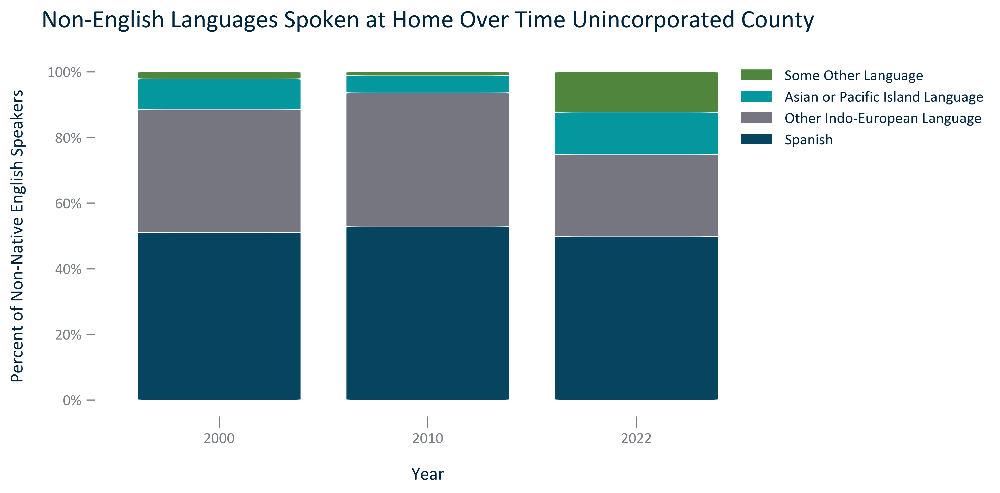

In [67]:
title = 'Non-English Languages Spoken at Home Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year','Language%:Non-English Speak Spanish', 'Language%:Non-English Speak Other Indo-European Language',
                   'Language%:Non-English Speak Asian or Pacific Island Language', 'Language%:Non-English Speak Other Language']]
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.rename(columns = {'Language%:Non-English Speak Spanish':'Spanish', 
                                    'Language%:Non-English Speak Other Indo-European Language':'Other Indo-European Language',
                                    'Language%:Non-English Speak Asian or Pacific Island Language':'Asian or Pacific Island Language',
                                    'Language%:Non-English Speak Other Language':'Some Other Language'})
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Percent of Non-Native English Speakers') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
#display and save
fig.savefig('../Figures/LANGUAGE_stackedbar_primarygeo_sharenonenglishlanguages_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/LANGUAGE_stackedbar_primarygeo_sharenonenglishlanguages_overtime.png', bbox_inches='tight')
with open('../Figures/LANGUAGE_stackedbar_primarygeo_sharenonenglishlanguages_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

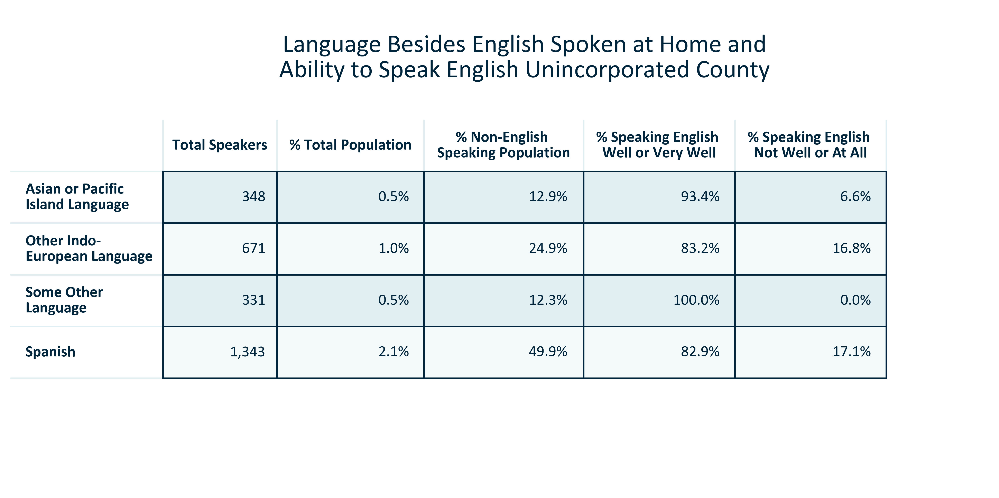

In [68]:
title = 'Language Besides English Spoken at Home and\nAbility to Speak English Unincorporated County'
df_temp = Primaryt
next_line = ['Total Speakers', '% Total Population', '% Non-English \nSpeaking Population', '% Speaking English \nWell or Very Well', 
             '% Speaking English \nNot Well or At All']
df_temp1 = df_temp[['Language:Speak Spanish 2022', 'Language%:Speak Spanish 2022', 'Language%:Non-English Speak Spanish 2022', 
                    'Language:Spanish%:Speak English Well or Very Well 2022', 'Language:Spanish%:Speak English Not Well or At All 2022']]
df_temp1.columns = next_line
df_temp2 = df_temp[['Language:Speak Other Indo-European Language 2022', 'Language%:Speak Other Indo-European Language 2022', 
                    'Language%:Non-English Speak Other Indo-European Language 2022', 'Language:Other Indo-European%:Speak English Well or Very Well 2022', 
                    'Language:Other Indo-European%:Speak English Not Well or At All 2022']]
df_temp2.columns = next_line
df_temp3 = df_temp[['Language:Speak Asian or Pacific Island Language 2022', 'Language%:Speak Asian or Pacific Island Language 2022', 
                    'Language%:Non-English Speak Asian or Pacific Island Language 2022', 'Language:Asian or Pacific Island%:Speak English Well or Very Well 2022', 
                    'Language:Asian or Pacific Island%:Speak English Not Well or At All 2022']]
df_temp3.columns = next_line
df_temp4 = df_temp[['Language:Speak Other Language 2022', 'Language%:Speak Other Language 2022', 
                    'Language%:Non-English Speak Other Language 2022', 'Language:Other%:Speak English Well or Very Well 2022', 
                    'Language:Other%:Speak English Not Well or At All 2022']]
df_temp4.columns = next_line
dfs = [df_temp3, df_temp2, df_temp4, df_temp1]
df_temp = pd.concat(dfs)#df_temp3.append(dfs)
newindex = ['Asian or Pacific\nIsland Language', 'Other Indo-\nEuropean Language', 'Some Other \nLanguage', 'Spanish']
df_temp = df_temp.set_axis(newindex)
#df_temp = df_temp.sort_values(by = 'Total Speakers', ascending = False)
df_temp.update(df_temp[['Total Speakers']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['% Total Population', '% Non-English \nSpeaking Population', '% Speaking English \nWell or Very Well', 
                        '% Speaking English \nNot Well or At All']].applymap('{:.1f}%'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#initiate table and set parameters
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.8)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/LANGUAGE_table_primarygeo_languagebesidesenglish_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/LANGUAGE_table_primarygeo_languagebesidesenglish_2022.png', bbox_inches='tight')
with open('../Figures/LANGUAGE_table_primarygeo_languagebesidesenglish_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

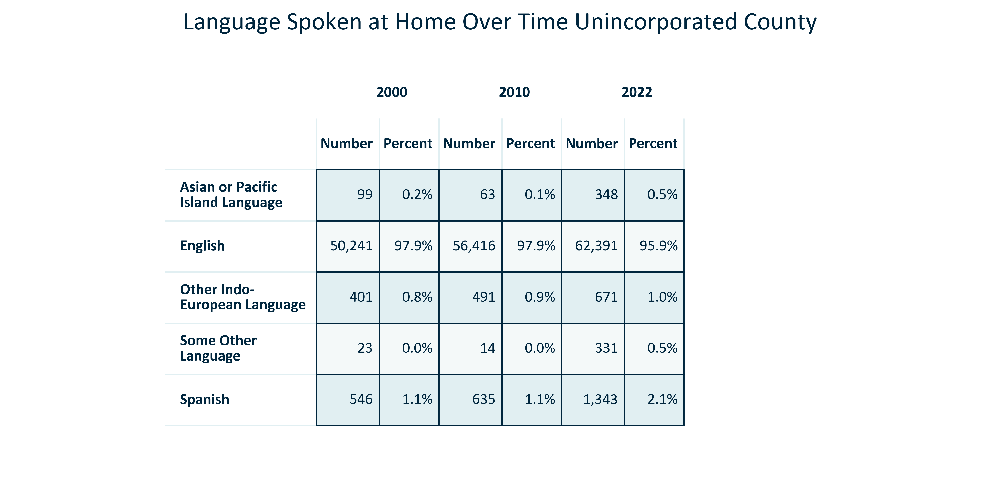

In [69]:
title = 'Language Spoken at Home Over Time Unincorporated County'
#set up temporary dataframe
df_temp = Primaryt
next_line = ['Number2000', 'Percent2000', 'Number2010', 'Percent2010', 'Number2020', 'Percent2020']
df_temp0 = df_temp[['Language:Speak Only English 2000', 'Language%:Speak Only English 2000', 
                    'Language:Speak Only English 2010', 'Language%:Speak Only English 2010',
                    'Language:Speak Only English 2022', 'Language%:Speak Only English 2022']]
df_temp0.columns = next_line
df_temp1 = df_temp[['Language:Speak Spanish 2000', 'Language%:Speak Spanish 2000', 'Language:Speak Spanish 2010', 'Language%:Speak Spanish 2010',
                    'Language:Speak Spanish 2022', 'Language%:Speak Spanish 2022']]
df_temp1.columns = next_line
df_temp2 = df_temp[['Language:Speak Other Indo-European Language 2000', 'Language%:Speak Other Indo-European Language 2000', 
                    'Language:Speak Other Indo-European Language 2010', 'Language%:Speak Other Indo-European Language 2010',
                    'Language:Speak Other Indo-European Language 2022', 'Language%:Speak Other Indo-European Language 2022']]
df_temp2.columns = next_line
df_temp3 = df_temp[['Language:Speak Asian or Pacific Island Language 2000', 'Language%:Speak Asian or Pacific Island Language 2000', 
                    'Language:Speak Asian or Pacific Island Language 2010', 'Language%:Speak Asian or Pacific Island Language 2010',
                    'Language:Speak Asian or Pacific Island Language 2022', 'Language%:Speak Asian or Pacific Island Language 2022']]
df_temp3.columns = next_line
df_temp4 = df_temp[['Language:Speak Other Language 2000', 'Language%:Speak Other Language 2000', 
                    'Language:Speak Other Language 2010', 'Language%:Speak Other Language 2010',
                    'Language:Speak Other Language 2022', 'Language%:Speak Other Language 2022']]
df_temp4.columns = next_line
dfs = [df_temp3, df_temp0, df_temp2, df_temp4, df_temp1]
df_temp = pd.concat(dfs)
newindex = ['Asian or Pacific\nIsland Language', 'English', 'Other Indo-\nEuropean Language', 'Some Other \nLanguage', 'Spanish']
df_temp = df_temp.set_axis(newindex)
df_temp.update(df_temp[['Number2000', 'Number2010', 'Number2020']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Percent2000', 'Percent2010', 'Percent2020']].applymap('{:.1f}%'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['2000','', '2010', '', '2022', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.9)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/LANGUAGE_table_primarygeo_languagespokenathome_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/LANGUAGE_table_primarygeo_languagespokenathome_overtime.png', bbox_inches='tight')
with open('../Figures/LANGUAGE_table_primarygeo_languagespokenathome_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

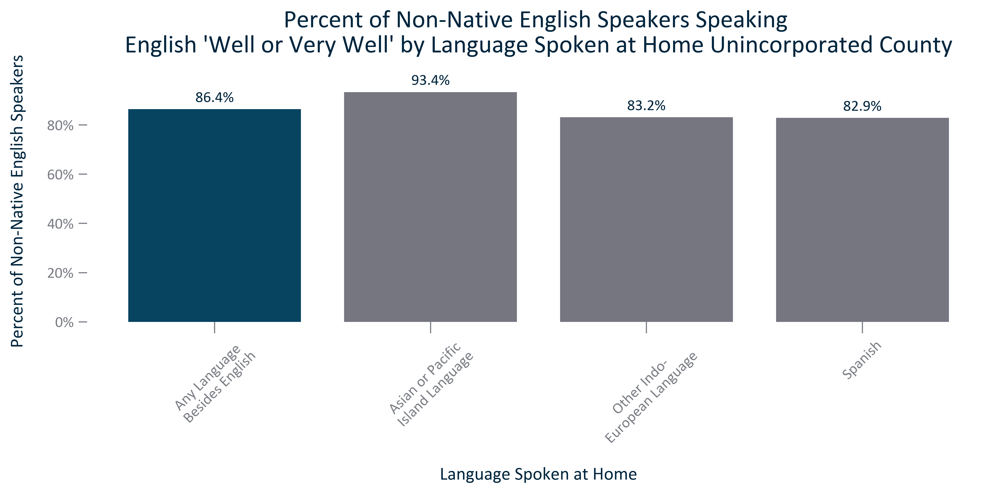

In [70]:
title = "Percent of Non-Native English Speakers Speaking \nEnglish 'Well or Very Well' by Language Spoken at Home Unincorporated County"
df_temp = Primary.loc[Primary['Year'] == 2022.0]
#nobody in "Some Other Language"
df_temp = df_temp[['Language:Language Besides English%:Speak English Well or Very Well', 'Language:Spanish%:Speak English Well or Very Well', 
                   'Language:Other Indo-European%:Speak English Well or Very Well', 'Language:Asian or Pacific Island%:Speak English Well or Very Well']]#, 
                   #'Language:Other%:Speak English Well or Very Well']]
df_temp = df_temp.rename(columns = {'Language:Language Besides English%:Speak English Well or Very Well': "Any Language \nBesides English", 
                                    'Language:Spanish%:Speak English Well or Very Well': "Spanish", 
                                    'Language:Other Indo-European%:Speak English Well or Very Well': "Other Indo-\nEuropean Language", 
                                    'Language:Asian or Pacific Island%:Speak English Well or Very Well': "Asian or Pacific\nIsland Language", 
                                    'Language:Other%:Speak English Well or Very Well': "Some Other\nLanguage"})
df_temp = df_temp.melt(var_name = 'Language', value_name = 'People')
df_temp = df_temp.sort_values(by = 'Language')
#initiate figure and set parameters
x = df_temp['Language']
y = df_temp['People']
xlabel = 'Language Spoken at Home'
ylabel = "Percent of Non-Native English Speakers"
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != 'Any Language \nBesides English' else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.1f}%")
#display and save
fig.savefig('../Figures/LANGUAGE_bar_primarygeo_englishwellorverywell_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/LANGUAGE_bar_primarygeo_englishwellorverywell_2022.png', bbox_inches='tight')
with open('../Figures/LANGUAGE_bar_primarygeo_englishwellorverywell_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

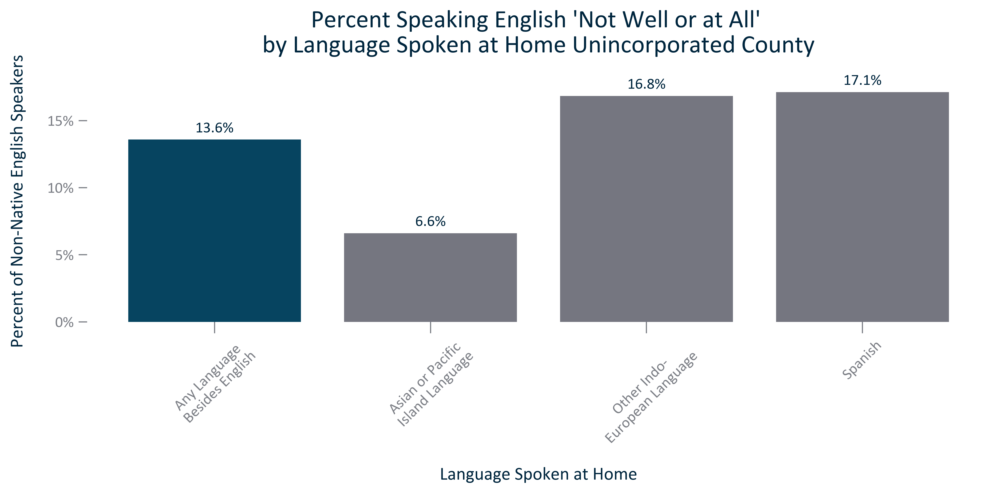

In [71]:
title = "Percent Speaking English 'Not Well or at All' \nby Language Spoken at Home Unincorporated County"
df_temp = Primary.loc[Primary['Year'] == 2022.0]
#nobody in "some other language" here
df_temp = df_temp[['Language:Language Besides English%:Speak English Not Well or At All', 'Language:Spanish%:Speak English Not Well or At All', 
                   'Language:Other Indo-European%:Speak English Not Well or At All', 'Language:Asian or Pacific Island%:Speak English Not Well or At All']]#, 
                  # 'Language:Other%:Speak English Not Well or At All']]
df_temp = df_temp.rename(columns = {'Language:Language Besides English%:Speak English Not Well or At All': "Any Language \nBesides English", 
                                    'Language:Spanish%:Speak English Not Well or At All': "Spanish", 
                                    'Language:Other Indo-European%:Speak English Not Well or At All': "Other Indo-\nEuropean Language", 
                                    'Language:Asian or Pacific Island%:Speak English Not Well or At All': "Asian or Pacific\nIsland Language", 
                                    'Language:Other%:Speak English Not Well or At All': "Some Other\nLanguage"})
df_temp = df_temp.melt(var_name = 'Language', value_name = 'People')
df_temp = df_temp.sort_values(by = 'Language')
#initiate figure and set parameters
x = df_temp['Language']
y = df_temp['People']
xlabel = 'Language Spoken at Home'
ylabel = "Percent of Non-Native English Speakers"
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != 'Any Language \nBesides English' else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.1f}%")

#display and save
fig.savefig('../Figures/LANGUAGE_bar_primarygeo_englishnotwelloratall_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/LANGUAGE_bar_primarygeo_englishnotwelloratall_2022.png', bbox_inches='tight')
with open('../Figures/LANGUAGE_bar_primarygeo_englishnotwelloratall_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

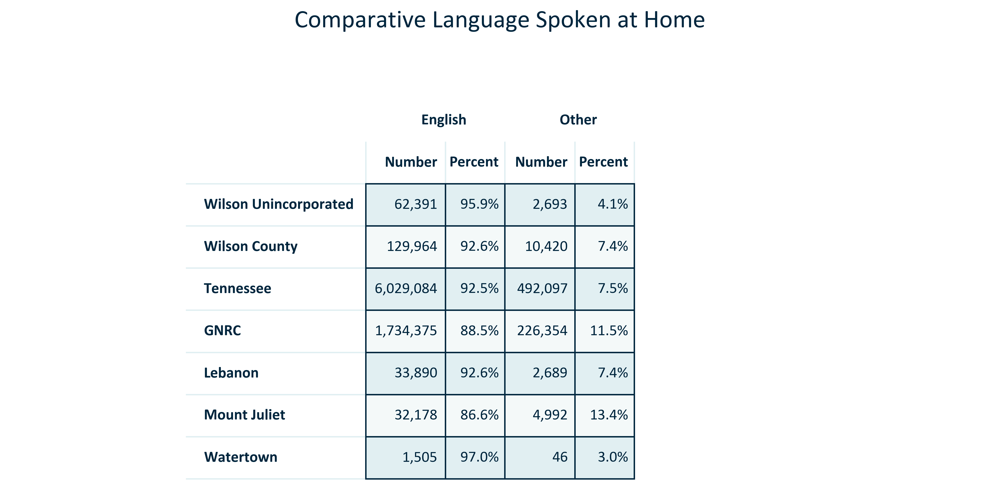

In [72]:
title = 'Comparative Language Spoken at Home'
#set up temporary dataframe
df_temp = reggeos.loc[reggeos['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Language:Speak Only English', 'Language%:Speak Only English', 
                   'Language:Speak Language Besides English', 'Language%:Speak Language Besides English']]
df_temp.update(df_temp[['Language:Speak Only English', 'Language:Speak Language Besides English']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Language%:Speak Only English', 'Language%:Speak Language Besides English']].applymap('{:,.1f}%'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#English and Non-English
col_names = ['Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['English      ','', 'Other      ', '']
doublecols = np.vstack([colstomerge, col_names])
#initiate table and set parameters
table = ax.table(cellText=np.vstack([colstomerge, col_names, df_temp.values]), rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/LANGUAGE_table_geocomparative_englishornon_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/LANGUAGE_table_geocomparative_englishornon_overtime.png', bbox_inches='tight')
with open('../Figures/LANGUAGE_table_geocomparative_englishornon_overtime.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

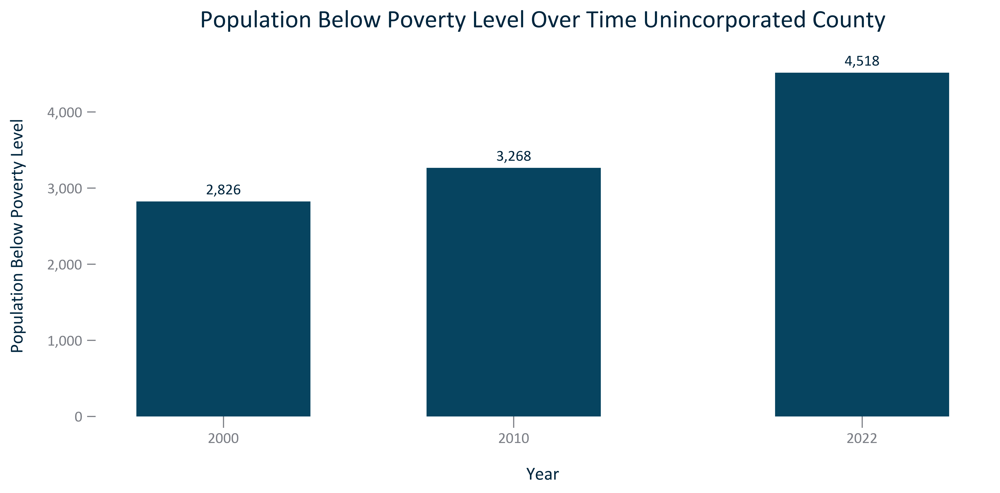

In [73]:
title = 'Population Below Poverty Level Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Poverty: Population Below Poverty Level']]
xinput = 'Year'
yinput = 'Poverty: Population Below Poverty Level'
xlabel = xinput
ylabel = 'Population Below Poverty Level'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/POVERTY_bar_primarygeo_populationbelowpovertylevel_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_bar_primarygeo_populationbelowpovertylevel_overtime.png', bbox_inches='tight')
with open('../Figures/POVERTY_bar_primarygeo_populationbelowpovertylevel_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

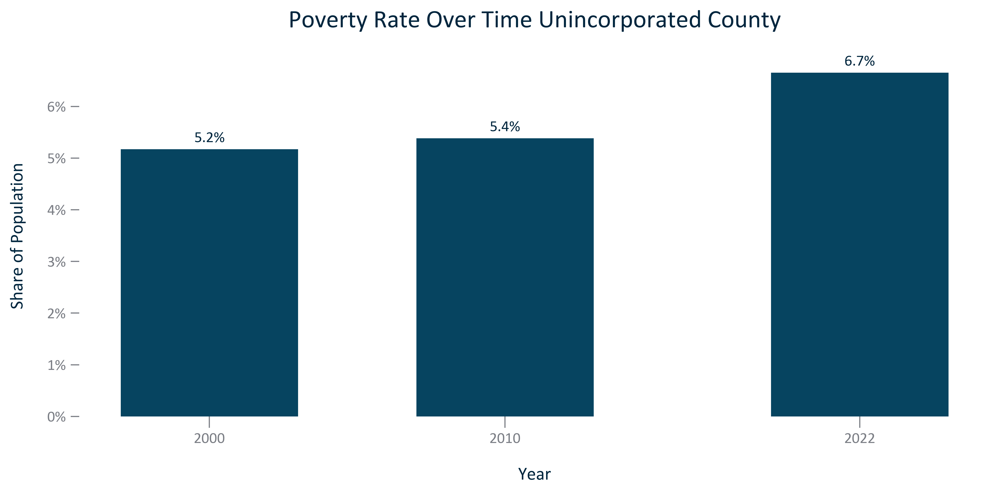

In [74]:
title = 'Poverty Rate Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Poverty%: Below Poverty Level']]
xinput = 'Year'
yinput = 'Poverty%: Below Poverty Level'
xlabel = xinput
ylabel = 'Share of Population'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.1f}%")
#display and save
fig.savefig('../Figures/POVERTY_bar_primarygeo_percentpopulationbelowpovertylevel_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_bar_primarygeo_percentpopulationbelowpovertylevel_overtime.png', bbox_inches='tight')
with open('../Figures/POVERTY_bar_primarygeo_percentpopulationbelowpovertylevel_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

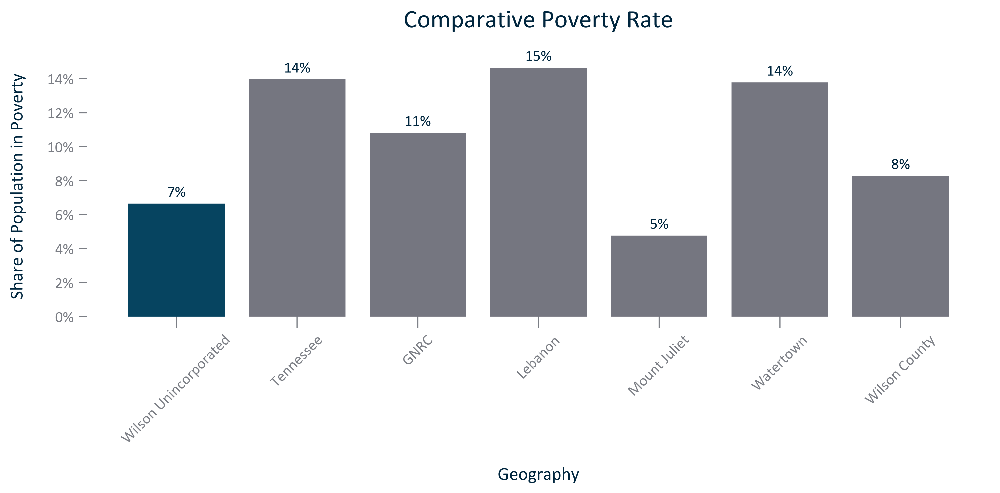

In [75]:
title = 'Comparative Poverty Rate'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['NAME', 'Poverty%: Below Poverty Level']]
x = df_temp['NAME']
y = df_temp['Poverty%: Below Poverty Level']
xlabel = 'Geography'
ylabel = 'Share of Population in Poverty'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.0f}%")
# #display and save
fig.savefig('../Figures/POVERTY_bar_geocomparative_povertyrate_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_bar_geocomparative_povertyrate_2022.png', bbox_inches='tight')
with open('../Figures/POVERTY_bar_geocomparative_povertyrate_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

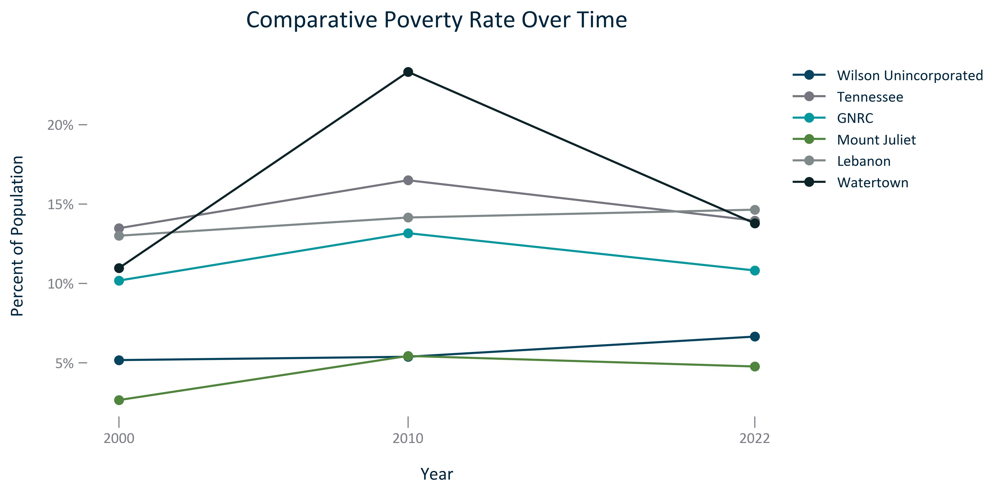

In [77]:
title = 'Comparative Poverty Rate Over Time'
#set up temporary dataframe
xinput = 'Year'
yinput = 'Poverty%: Below Poverty Level'
df_tempfirst = Primary.loc[Primary['Year'] != 0.0]
linelabelfirst = str(df_tempfirst['NAME'].values[0])
xfirst = df_tempfirst[xinput]
yfirst = df_tempfirst[yinput]
df_temp0 = State
linelabel0 = str(df_temp0['NAME'].values[0])
x0 = df_temp0[xinput]
y0 = df_temp0[yinput]
df_temp1 = Region
linelabel1 = str(df_temp1['NAME'].values[0])
x1 = df_temp1[xinput]
y1 = df_temp1[yinput]
df_temp2 = Lebanon
linelabel2 = str(df_temp2['NAME'].values[0])
x2 = df_temp2[xinput]
y2 = df_temp2[yinput]
df_temp3 = MountJuliet
linelabel3 = str(df_temp3['NAME'].values[0])
x3 = df_temp3[xinput]
y3 = df_temp3[yinput]
df_temp4 = Watertown
linelabel4 = str(df_temp4['NAME'].values[0])
x4 = df_temp4[xinput]
y4 = df_temp4[yinput]
#initiate figure and add lines and parameters
fig, ax = plt.subplots()
ax.plot(xfirst, yfirst, label = linelabelfirst)
ax.plot(x0, y0, label = linelabel0)
ax.plot(x1, y1, label = linelabel1)
ax.plot(x2, y2, label = linelabel2)
ax.plot(x3, y3, label = linelabel3)
ax.plot(x4, y4, label = linelabel4)
ax.set(title = title, xlabel = xinput, ylabel = 'Percent of Population')
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left')
labels = ['2000', '2010', '2022']
plt.xticks(df_tempfirst[xinput], labels)
# #display and save
fig.savefig('../Figures/POVERTY_line_geocomparative_sharebelowpovertylevel_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_line_geocomparative_sharebelowpovertylevel_overtime.png', bbox_inches='tight')
with open('../Figures/POVERTY_line_geocomparative_sharebelowpovertylevel_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

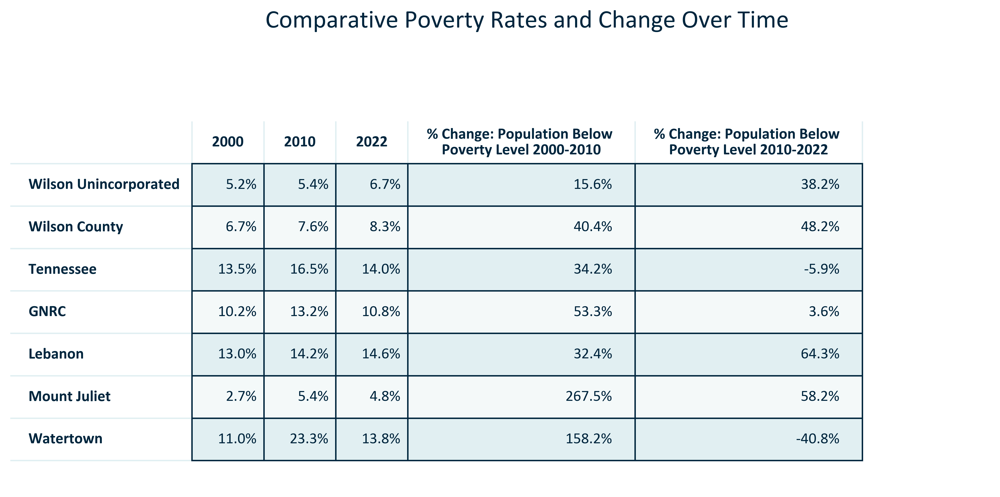

In [78]:
title = 'Comparative Poverty Rates and Change Over Time'
df_temp = reggeost.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Poverty%: Below Poverty Level 2000', 'Poverty%: Below Poverty Level 2010', 'Poverty%: Below Poverty Level 2022',
                  'Poverty: Population Below Poverty Level 2000', 'Poverty: Population Below Poverty Level 2010', 'Poverty: Population Below Poverty Level 2022']]
df_temp['% Change: Population Below \nPoverty Level 2000-2010'] = prettypercentchange(df_temp['Poverty: Population Below Poverty Level 2010'], 
                                                                                      df_temp['Poverty: Population Below Poverty Level 2000'])
df_temp['% Change: Population Below \nPoverty Level 2010-2022'] = prettypercentchange(df_temp['Poverty: Population Below Poverty Level 2022'], 
                                                                                      df_temp['Poverty: Population Below Poverty Level 2010'])
df_temp.update(df_temp[['Poverty%: Below Poverty Level 2000', 'Poverty%: Below Poverty Level 2010', 'Poverty%: Below Poverty Level 2022']].applymap('{:,.1f}%'.format))
df_temp = df_temp.rename(columns = {'Poverty%: Below Poverty Level 2000': '    2000    ', 
                                    'Poverty%: Below Poverty Level 2010': '    2010    ', 
                                    'Poverty%: Below Poverty Level 2022': '    2022    '})
df_temp = df_temp[['    2000    ', '    2010    ', '    2022    ', 
                   '% Change: Population Below \nPoverty Level 2000-2010', '% Change: Population Below \nPoverty Level 2010-2022']]
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
makeinvisible(guy1, guy2, guy3)
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', 
                 cellColours = colours, colColours = colcolours, cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
allheaders(col1, col2, edge1, edge2)
table.scale(2, 2.5)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
#display and save
fig.savefig('../Figures/POVERTY_table_geocomparative_rateandchange_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_table_geocomparative_rateandchange_overtime.png', bbox_inches='tight')
with open('../Figures/POVERTY_table_geocomparative_rateandchange_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

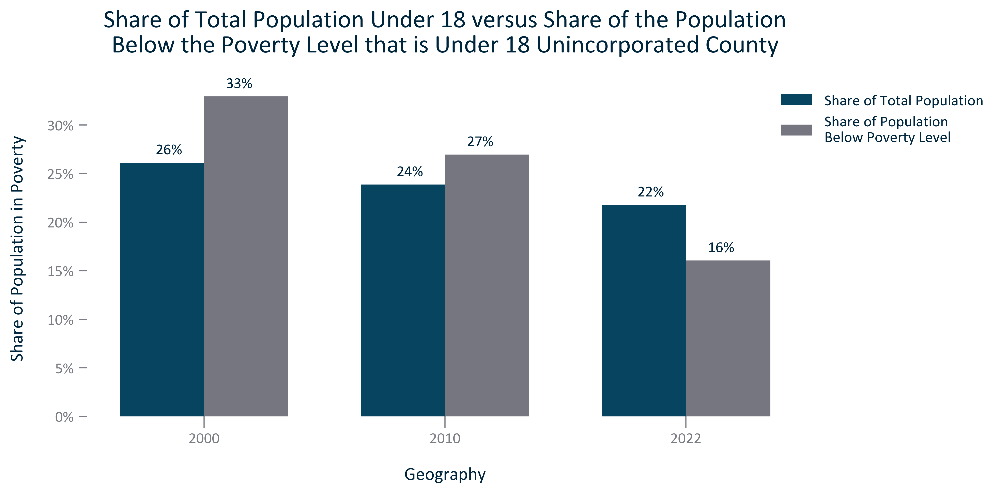

In [79]:
title = 'Share of Total Population Under 18 versus Share of the Population\nBelow the Poverty Level that is Under 18 Unincorporated County' #set title of figure
#set up temporary dataframe
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['Year', 'Age%:Under 18', 'Poverty%:Below Poverty Level Under 18']]
df_temp = df_temp.rename(columns = {'Age%:Under 18': 'Population Under 18', 
                                    'Poverty%:Below Poverty Level Under 18': 'Share of Population Below\n Poverty Level Under 18'}).set_index('Year')
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['Population Under 18']
y2 = df_temp['Share of Population Below\n Poverty Level Under 18']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = 'Share of Total Population')
bar2 = ax.bar(xpos+width/2, y2, width, label = 'Share of Population \nBelow Poverty Level')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set_xticks(xpos)
ax.set_xticklabels(['2000', '2010', '2022'])
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-25, 6, 25, 6, "{:,.0f}%", SMALL_SIZE)
fig.savefig('../Figures/POVERTY_clusterbar_primarygeo_u18popsharevspovertypopshare_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_clusterbar_primarygeo_u18popsharevspovertypopshare_overtime.png', bbox_inches='tight')
with open('../Figures/POVERTY_clusterbar_primarygeo_u18popsharevspovertypopshare_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

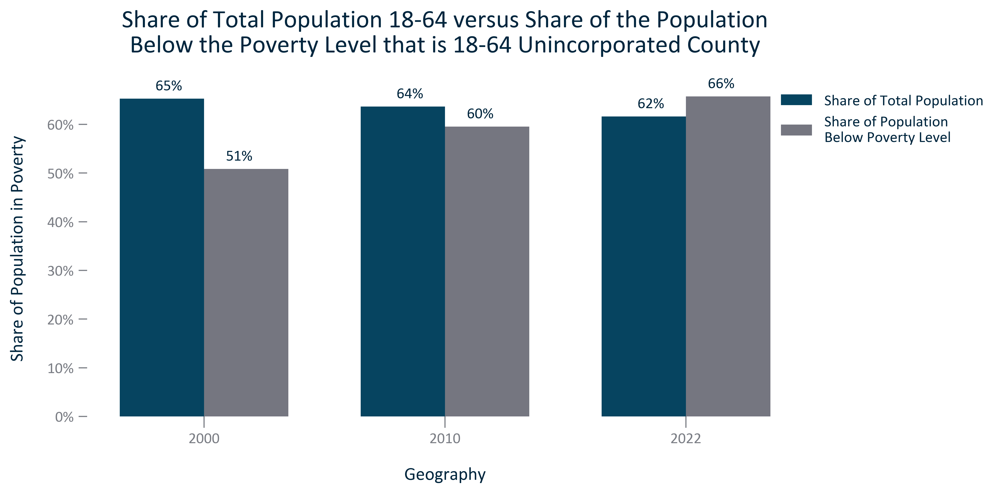

In [80]:
title = 'Share of Total Population 18-64 versus Share of the Population\nBelow the Poverty Level that is 18-64 Unincorporated County' #set title of figure
#set up temporary dataframe
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['Year', 'Age%:18 to 64', 'Poverty%:Below Poverty Level 18 to 64']]
df_temp = df_temp.rename(columns = {'Age%:18 to 64': 'Population 18 to 64', 
                                    'Poverty%:Below Poverty Level 18 to 64': 'Share of Population Below\n Poverty Level 18 to 64'}).set_index('Year')
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['Population 18 to 64']
y2 = df_temp['Share of Population Below\n Poverty Level 18 to 64']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = 'Share of Total Population')
bar2 = ax.bar(xpos+width/2, y2, width, label = 'Share of Population \nBelow Poverty Level')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set_xticks(xpos)
ax.set_xticklabels(['2000', '2010', '2022'])
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-25, 6, 25, 6, "{:,.0f}%", SMALL_SIZE)
fig.savefig('../Figures/POVERTY_clusterbar_primarygeo_18to64popsharevspovertypopshare_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_clusterbar_primarygeo_18to64popsharevspovertypopshare_overtime.png', bbox_inches='tight')
with open('../Figures/POVERTY_clusterbar_primarygeo_18to64popsharevspovertypopshare_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

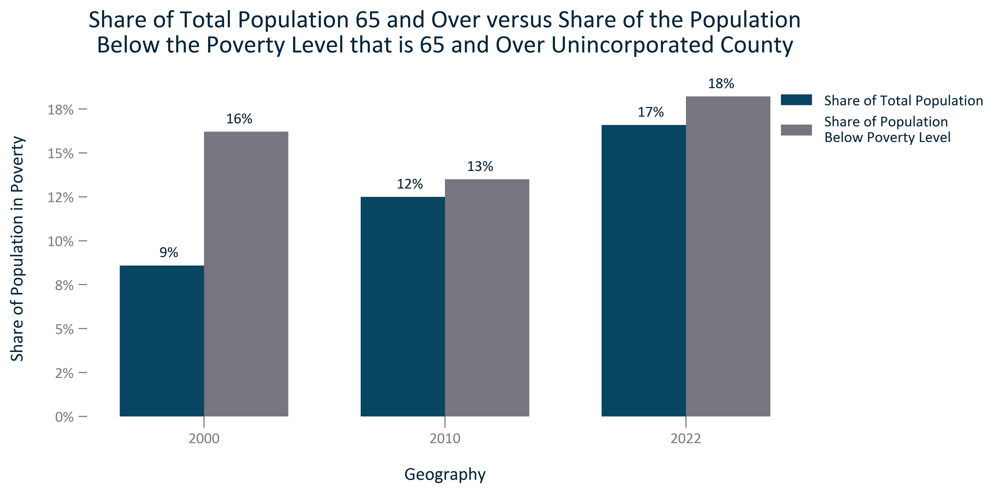

In [81]:
title = 'Share of Total Population 65 and Over versus Share of the Population\nBelow the Poverty Level that is 65 and Over Unincorporated County' #set title of figure
#set up temporary dataframe
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['Year', 'Age%:65 and Older', 'Poverty%:Below Poverty Level 65 and Over']]
df_temp = df_temp.rename(columns = {'Age%:65 and Older': 'Population 65 and Over', 
                                    'Poverty%:Below Poverty Level 65 and Over': 'Share of Population Below\n Poverty Level 65 and Over'}).set_index('Year')
#initiate figure and set parameters
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['Population 65 and Over']
y2 = df_temp['Share of Population Below\n Poverty Level 65 and Over']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = 'Share of Total Population')
bar2 = ax.bar(xpos+width/2, y2, width, label = 'Share of Population \nBelow Poverty Level')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set_xticks(xpos)
ax.set_xticklabels(['2000', '2010', '2022'])
#outside legend
ax.legend(bbox_to_anchor=(0.95, 1), loc='upper left', frameon = False)#, prop = {'size':9})
#data labels
doubledatalabels(-25, 6, 25, 6, "{:,.0f}%", SMALL_SIZE)
fig.savefig('../Figures/POVERTY_clusterbar_primarygeo_65overpopsharevspovertypopshare_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_clusterbar_primarygeo_65overpopsharevspovertypopshare_overtime.png', bbox_inches='tight')
with open('../Figures/POVERTY_clusterbar_primarygeo_65overpopsharevspovertypopshare_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

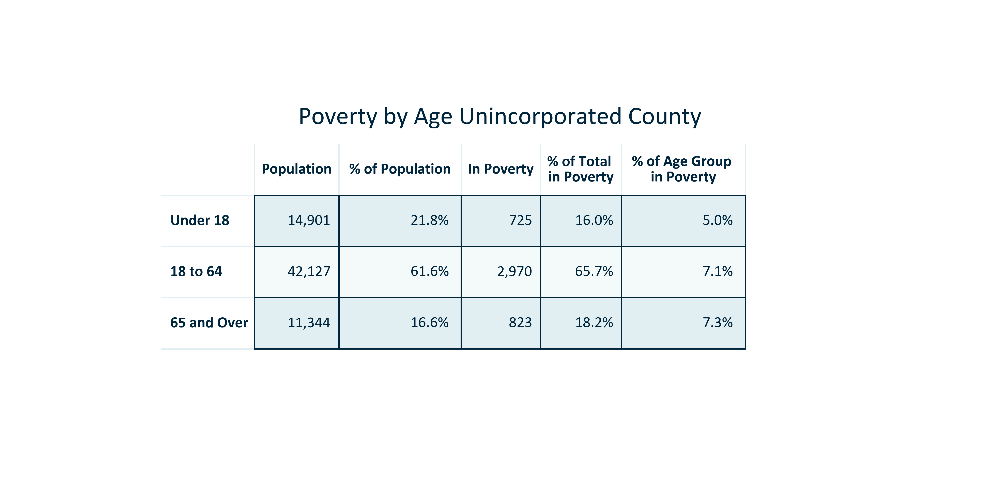

In [82]:
title = 'Poverty by Age Unincorporated County'
df_temp = Primary.loc[Primary['Year'] == 2022.0]
next_line = ['Population', '% of Population', 'In Poverty', '% of Total \nin Poverty', '% of Age Group \nin Poverty']
df_temp1 = df_temp[['Age:Under 18', 'Age%:Under 18', 'Poverty:Below Poverty Level Under 18', 
                    'Poverty%:Below Poverty Level Under 18', 'Poverty%:Under 18 Below Poverty Level']]
df_temp1.columns = next_line
df_temp2 = df_temp[['Age:18 to 64', 'Age%:18 to 64', 'Poverty:Below Poverty Level 18 to 64', 
                    'Poverty%:Below Poverty Level 18 to 64', 'Poverty%:18 to 64 Below Poverty Level']]
df_temp2.columns = next_line
df_temp3 = df_temp[['Age:65 and Older', 'Age%:65 and Older', 'Poverty:Below Poverty Level 65 and Over', 
                    'Poverty%:Below Poverty Level 65 and Over', 'Poverty%:65 and Over Below Poverty Level']]
df_temp3.columns = next_line
dfs = [df_temp1, df_temp2, df_temp3]
df_temp = pd.concat(dfs)
df_temp.update(df_temp[['% of Population', '% of Total \nin Poverty', '% of Age Group \nin Poverty']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Population', 'In Poverty']].applymap('{:,.0f}'.format))
newindex = ['Under 18', '18 to 64', '65 and Over']
df_temp = df_temp.set_axis(newindex)
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.7)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/POVERTY_table_primarygeo_byagegroups_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_table_primarygeo_byagegroups_2022.png', bbox_inches='tight')
with open('../Figures/POVERTY_table_primarygeo_byagegroups_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

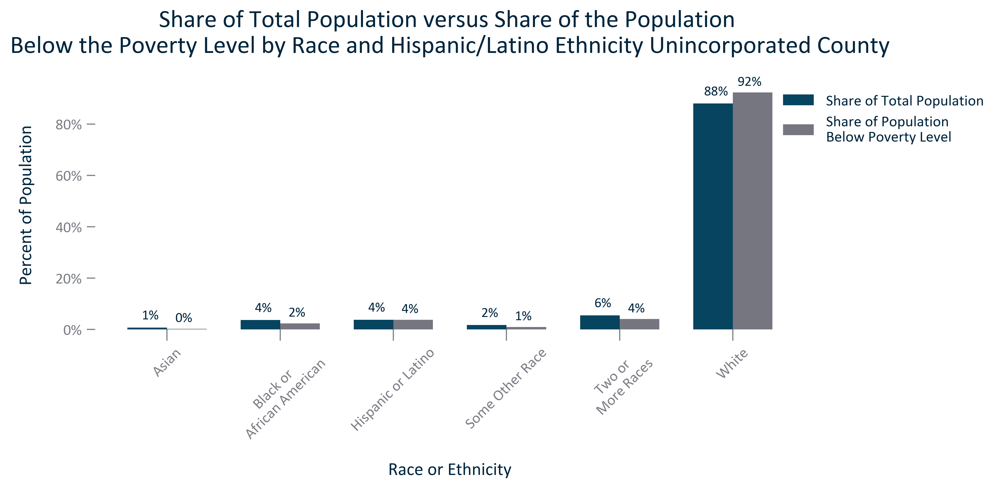

In [83]:
title = 'Share of Total Population versus Share of the Population \nBelow the Poverty Level by Race and Hispanic/Latino Ethnicity Unincorporated County'
#set up temporary dataframe
df_temp = Primary.loc[Primary['Year'] == 2022.0]
next_line = ['Share of Total Population', 'Share of Population in Poverty']
df_temp6 = df_temp[['White Alone %', 'Poverty%:Below Poverty Level White Alone']]
df_temp6.columns = next_line
df_temp2 = df_temp[['Black or African American Alone %', 'Poverty%:Below Poverty Level Black or African American Alone']]
df_temp2.columns = next_line
# df_temp3 = df_temp[['American Indian Alaska Native Alone %', 'Poverty%:Below Poverty Level American Indian Alaska Native Alone']]
# df_temp3.columns = next_line
df_temp1 = df_temp[['Asian Alone %', 'Poverty%:Below Poverty Level Asian Alone']]
df_temp1.columns = next_line
# df_temp5 = df_temp[['Native Hawaiian Other Pacific Islander Alone %', 'Poverty%:Below Poverty Level Native Hawaiian Other Pacific Islander Alone']]
# df_temp5.columns = next_line
df_temp4 = df_temp[['Some Other Race Alone %', 'Poverty%:Below Poverty Level Some Other Race Alone']]
df_temp4.columns = next_line
df_temp5 = df_temp[['Two or More Races %', 'Poverty%:Below Poverty Level Two or More Races']]
df_temp5.columns = next_line
df_temp3 = df_temp[['Hispanic or Latino %', 'Poverty%:Below Poverty Level Hispanic or Latino']]
df_temp3.columns = next_line
dfs = [df_temp1, df_temp2, 
       df_temp3, 
       df_temp4, 
       df_temp5, 
       df_temp6]
df_temp = pd.concat(dfs)
newindex = ['Asian', 'Black or \nAfrican American', 'Hispanic or Latino', 
            'Some Other Race', 'Two or \nMore Races', 'White']
df_temp = df_temp.set_axis(newindex)
#set up
xlabel = 'Race or Ethnicity'
ylabel = 'Percent of Population'

xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['Share of Total Population']
y2 = df_temp['Share of Population in Poverty']
width = 0.35
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = 'Share of Total Population')
bar2 = ax.bar(xpos+width/2, y2, width, label = 'Share of Population \nBelow Poverty Level')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(.95, 1), loc='upper left', frameon = False)
#data labels
doubledatalabels(-12, 6, 12, 5, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/POVERTY_clusterbar_primarygeo_raceethpopulationsharevspovertypopulationshare_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_clusterbar_primarygeo_raceethpopulationsharevspovertypopulationshare_2022.png', bbox_inches='tight')
with open('../Figures/POVERTY_clusterbar_primarygeo_raceethpopulationsharevspovertypopulationshare_2022.txt', 'w') as text_file:
    text_file.write('Citation: {} and 2020 PL.... other races excluded because they make up less than 1% of population'.format(acs))
plt.show()
plt.close();

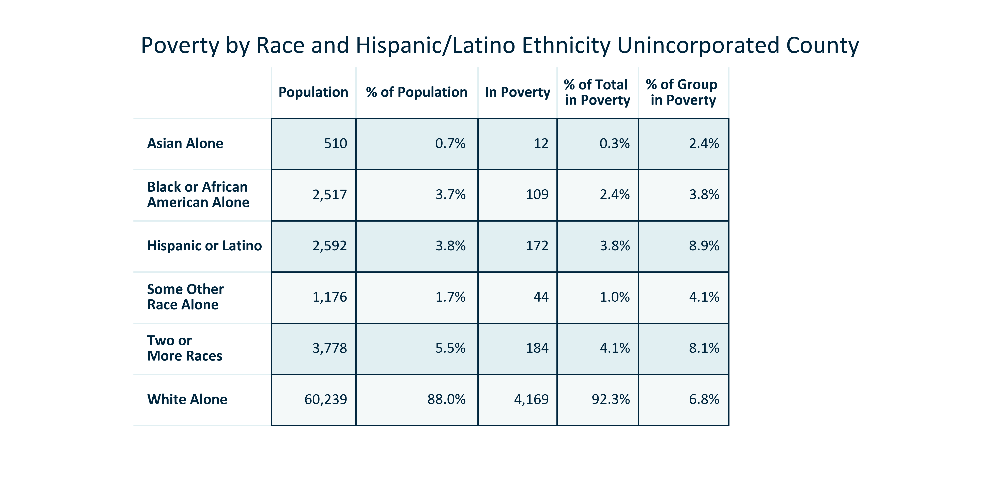

In [84]:
title = 'Poverty by Race and Hispanic/Latino Ethnicity Unincorporated County'
df_temp = Primary.loc[Primary['Year'] == 2022.0]
next_line = ['Population', '% of Population', 'In Poverty', '% of Total \nin Poverty', '% of Group \nin Poverty']
df_temp6 = df_temp[['White Alone', 'White Alone %', 'Poverty:Below Poverty Level White Alone', 
                    'Poverty%:Below Poverty Level White Alone', 'Poverty%:White Alone Below Poverty Level']]
df_temp6.columns = next_line
df_temp2 = df_temp[['Black or African American Alone', 'Black or African American Alone %', 'Poverty:Below Poverty Level Black or African American Alone', 
                    'Poverty%:Below Poverty Level Black or African American Alone', 'Poverty%:Black or African American Alone Below Poverty Level']]
df_temp2.columns = next_line
df_temp1 = df_temp[['Asian Alone', 'Asian Alone %', 'Poverty:Below Poverty Level Asian Alone', 
                    'Poverty%:Below Poverty Level Asian Alone', 'Poverty%:Asian Alone Below Poverty Level']]
df_temp1.columns = next_line
df_temp4 = df_temp[['Some Other Race Alone', 'Some Other Race Alone %', 'Poverty:Below Poverty Level Some Other Race Alone', 
                    'Poverty%:Below Poverty Level Some Other Race Alone', 'Poverty%:Some Other Race Alone Below Poverty Level']]
df_temp4.columns = next_line
df_temp5 = df_temp[['Two or More Races', 'Two or More Races %', 'Poverty:Below Poverty Level Two or More Races', 
                    'Poverty%:Below Poverty Level Two or More Races', 'Poverty%:Two or More Races Below Poverty Level']]
df_temp5.columns = next_line
df_temp3 = df_temp[['Hispanic or Latino', 'Hispanic or Latino %', 'Poverty:Below Poverty Level Hispanic or Latino', 
                    'Poverty%:Below Poverty Level Hispanic or Latino', 'Poverty%:Hispanic or Latino Below Poverty Level']]
df_temp3.columns = next_line
dfs = [df_temp1, df_temp2, df_temp3, df_temp4, df_temp5, df_temp6]
df_temp = pd.concat(dfs)
df_temp.update(df_temp[['% of Population', '% of Total \nin Poverty', '% of Group \nin Poverty']].applymap('{:,.1f}%'.format))
newindex = ['Asian Alone', 'Black or African \nAmerican Alone', 'Hispanic or Latino', 'Some Other \nRace Alone', 'Two or \nMore Races', 'White Alone']
df_temp = df_temp.set_axis(newindex)
df_temp.update(df_temp[['Population', 'In Poverty']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.85)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/POVERTY_table_primarygeo_byraceeth_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/POVERTY_table_primarygeo_byraceeth_2022.png', bbox_inches='tight')
with open('../Figures/POVERTY_table_primarygeo_byraceeth_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

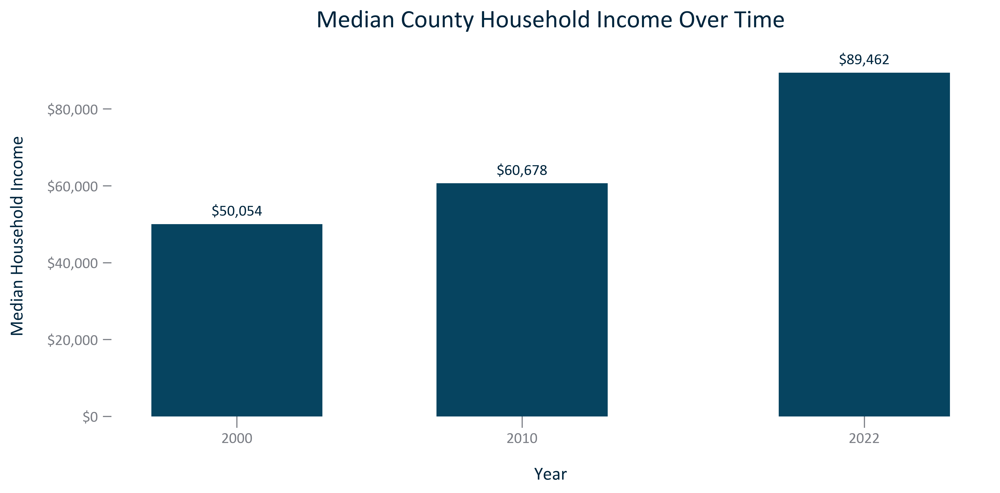

In [85]:
title = 'Median County Household Income Over Time'
df_temp = County.loc[County['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Median Household Income']]
xinput = 'Year'
yinput = 'Median Household Income'
xlabel = xinput
ylabel = yinput
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(moneyformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#plt.locator_params(axis='x', nbins=3)
#data labels
singledatalabels(0, 6, "${:,.0f}")
#display and save
fig.savefig('../Figures/INCOME_bar_primarygeo_medianhouseholdincome_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/INCOME_bar_primarygeo_medianhouseholdincome_overtime.png', bbox_inches='tight')
with open('../Figures/INCOME_bar_primarygeo_medianhouseholdincome_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

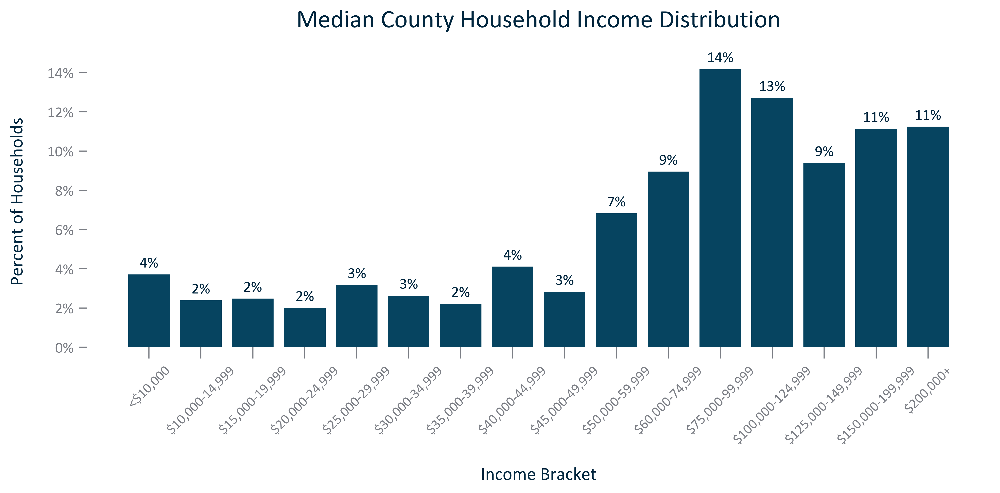

In [86]:
title = "Median County Household Income Distribution"
#create temporary dataframe
df_temp = County.loc[County['Year'] == 2022.0]
df_temp = df_temp[['HHIncome%:Less than 10,000', 'HHIncome%:10 to 14,999', 'HHIncome%:15 to 19,999', 'HHIncome%:20 to 24,999', 
                   'HHIncome%:25 to 29,999', 'HHIncome:%30 to 34,999', 'HHIncome%:35 to 39,999', 'HHIncome%:40 to 44,999', 
                   'HHIncome%:45 to 49,999', 'HHIncome%:50 to 59,999', 'HHIncome%:60 to 74,999', 'HHIncome%:75 to 99,999', 
                   'HHIncome%:100 to 124,999', 'HHIncome%:125 to 149,999', 'HHIncome%:150 to 199,999', 'HHIncome%:200K or More']]
df_temp = df_temp.rename(columns = {'HHIncome%:Less than 10,000': "<$10,000", 'HHIncome%:10 to 14,999': '$10,000-14,999', 
                                    'HHIncome%:15 to 19,999': '$15,000-19,999', 'HHIncome%:20 to 24,999': '$20,000-24,999', 
                                    'HHIncome%:25 to 29,999': '$25,000-29,999', 'HHIncome:%30 to 34,999': '$30,000-34,999', 
                                    'HHIncome%:35 to 39,999': '$35,000-39,999', 'HHIncome%:40 to 44,999': '$40,000-44,999', 
                                    'HHIncome%:45 to 49,999': '$45,000-49,999', 'HHIncome%:50 to 59,999': '$50,000-59,999', 
                                    'HHIncome%:60 to 74,999': '$60,000-74,999', 'HHIncome%:75 to 99,999': '$75,000-99,999', 
                                    'HHIncome%:100 to 124,999': '$100,000-124,999','HHIncome%:125 to 149,999': '$125,000-149,999', 
                                    'HHIncome%:150 to 199,999': '$150,000-199,999', 'HHIncome%:200K or More': '$200,000+'})
df_temp = df_temp.transpose().reset_index(drop = False).rename(columns = {'index':'Income Bracket', 14:'Percent of Households'})
#initiate figure and set parameters
xinput = 'Income Bracket'
yinput = 'Percent of Households'
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = xinput
ylabel = yinput
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', labelsize = SMALLER_SIZE, rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.0f}%")
#display and save
fig.savefig('../Figures/INCOME_bar_primarygeo_medianhhincomedistribution_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/INCOME_bar_primarygeo_medianhhincomedistribution_2022.png', bbox_inches='tight')
with open('../Figures/INCOME_bar_primarygeo_medianhhincomedistribution_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

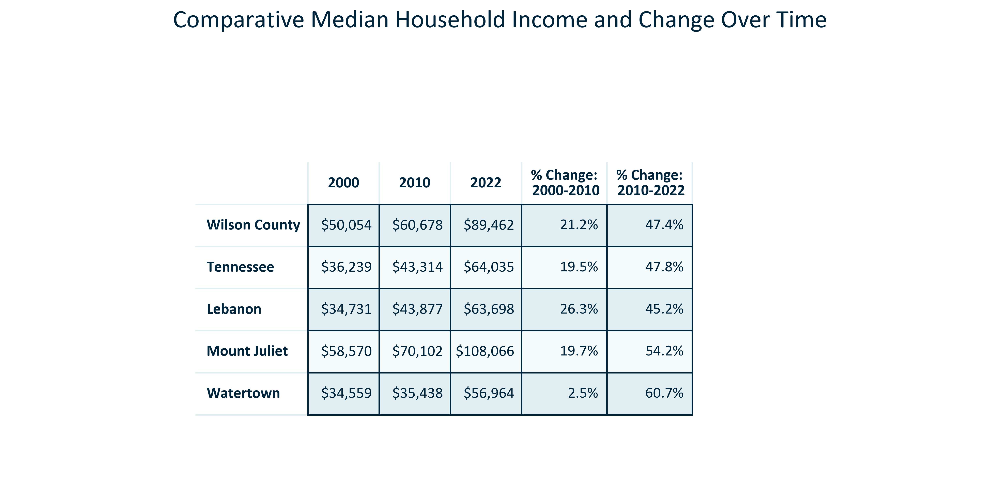

In [87]:
title = 'Comparative Median Household Income and Change Over Time'
df_temp = reggeost.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
#newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
#newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Median Household Income 2000', 'Median Household Income 2010', 'Median Household Income 2022']]
df_temp['% Change:\n 2000-2010'] = prettypercentchange(df_temp['Median Household Income 2010'], df_temp['Median Household Income 2000'])
df_temp['% Change:\n 2010-2022'] = prettypercentchange(df_temp['Median Household Income 2022'], df_temp['Median Household Income 2010'])
df_temp.update(df_temp[['Median Household Income 2000', 'Median Household Income 2010', 'Median Household Income 2022']].applymap('${:,.0f}'.format))
df_temp = df_temp.rename(columns = {'Median Household Income 2000': '    2000    ', 
                                    'Median Household Income 2010': '    2010    ', 
                                    'Median Household Income 2022': '    2022    '})
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/INCOME_table_geocomparative_medianhhincomeandchange_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/INCOME_table_geocomparative_medianhhincomeandchange_overtime.png', bbox_inches='tight')
with open('../Figures/INCOME_table_geocomparative_medianhhincomeandchange_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

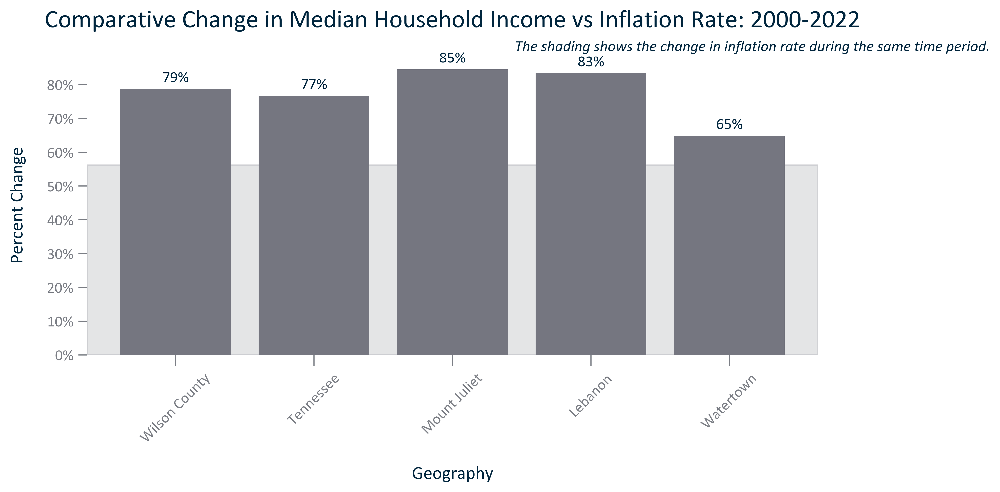

In [88]:
title = 'Comparative Change in Median Household Income vs Inflation Rate: 2000-2022'
#set up temporary dataframe
df_temp = reggeos.loc[reggeos['Time Frame'] == '2000-2022'].set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
#newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
#newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['NAME','Median Household Income % Change']]
#initiate figure and set parameters
xinput = 'NAME'
yinput = 'Median Household Income % Change'
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = 'Geography'
ylabel = 'Percent Change'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.text(2.45, 90, 'The shading shows the change in inflation rate during the same time period.', style = 'italic')
#data labels
singledatalabels(0, 5, "{:,.0f}%")
inflationrate = 56.26
plt.axhspan(0, inflationrate, alpha=0.2, color= GNRCCOOLGRAY, zorder=0)
# #display and save
fig.savefig('../Figures/INCOME_bar_geocomparative_changemedianhhincomevsinflation_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/INCOME_bar_geocomparative_changemedianhhincomevsinflation_overtime.png', bbox_inches='tight')
with open('../Figures/INCOME_bar_geocomparative_changemedianhhincomevsinflation_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, {}, BLS CPI All Urban Consumers South Region 2000 and 2022'.format(acs))
plt.show()
plt.close();

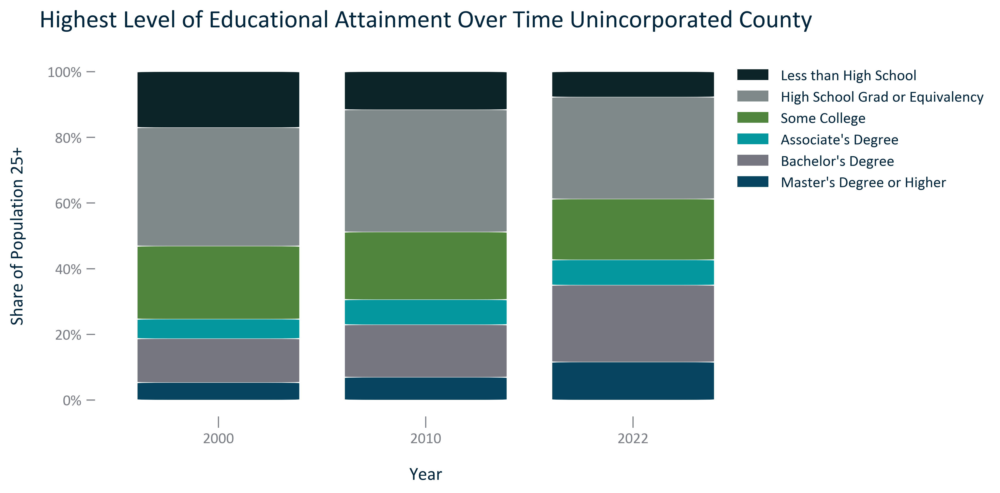

In [89]:
title = 'Highest Level of Educational Attainment Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Year'] != 0.0]
df_temp = df_temp[['Year','Ed%:Masters or More', 'Ed%:Bachelors', 'Ed%:Associates', 'Ed%:Some College', 
                   'Ed%:High School Graduate or Equivalency', 'Ed%:Less than High School']]
df_temp.update(df_temp[['Year']].applymap('{:.0f}'.format))
df_temp = df_temp.rename(columns = {'Ed%:Masters or More': "Master's Degree or Higher",'Ed%:Bachelors': "Bachelor's Degree", 
                                    'Ed%:Associates': "Associate's Degree", 'Ed%:Some College': 'Some College', 
                                    'Ed%:High School Graduate or Equivalency': 'High School Grad or Equivalency','Ed%:Less than High School': 'Less than High School'})
df_temp = df_temp.set_index('Year')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Population 25+') #set the title and axes labels
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
#display and save
fig.savefig('../Figures/EDUCATION_stackedbar_primarygeo_highestattainment_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_stackedbar_primarygeo_highestattainment_overtime.png', bbox_inches='tight')
with open('../Figures/EDUCATION_stackedbar_primarygeo_highestattainment_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

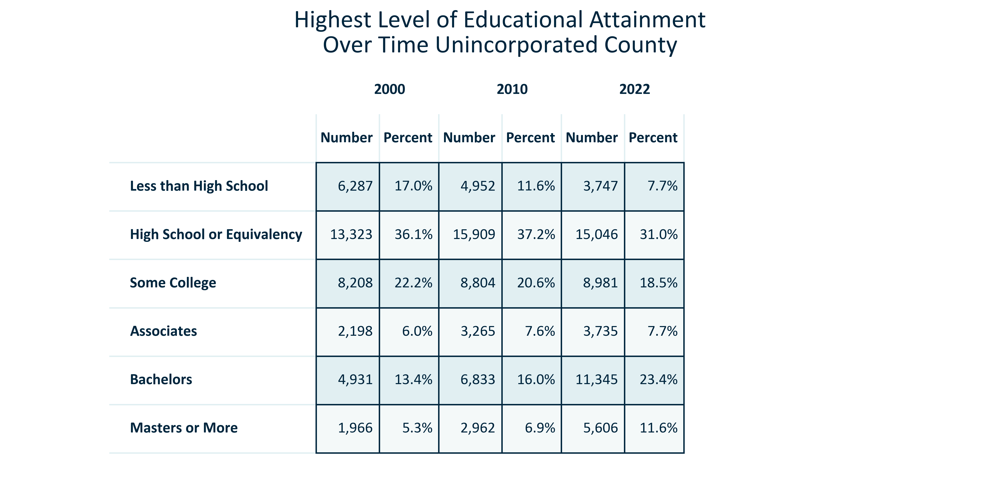

In [90]:
title = 'Highest Level of Educational Attainment\nOver Time Unincorporated County'
#set up temporary dataframe
df_temp = Primaryt
next_line = ['Number2000', 'Percent2000', 'Number2010', 'Percent2010', 'Number2022', 'Percent2022']
df_temp6 = df_temp[['Ed:Masters or More 2000', 'Ed%:Masters or More 2000',
                    'Ed:Masters or More 2010', 'Ed%:Masters or More 2010',
                    'Ed:Masters or More 2022', 'Ed%:Masters or More 2022']]
df_temp6.columns = next_line
df_temp5 = df_temp[['Ed:Bachelors 2000', 'Ed%:Bachelors 2000',
                    'Ed:Bachelors 2010', 'Ed%:Bachelors 2010',
                    'Ed:Bachelors 2022', 'Ed%:Bachelors 2022']]
df_temp5.columns = next_line
df_temp4 = df_temp[['Ed:Associates 2000', 'Ed%:Associates 2000',
                    'Ed:Associates 2010', 'Ed%:Associates 2010',
                    'Ed:Associates 2022', 'Ed%:Associates 2022']]
df_temp4.columns = next_line
df_temp3 = df_temp[['Ed:Some College 2000', 'Ed%:Some College 2000',
                    'Ed:Some College 2010', 'Ed%:Some College 2010',
                    'Ed:Some College 2022', 'Ed%:Some College 2022']]
df_temp3.columns = next_line
df_temp2 = df_temp[['Ed:High School Graduate or Equivalency 2000', 'Ed%:High School Graduate or Equivalency 2000',
                    'Ed:High School Graduate or Equivalency 2010', 'Ed%:High School Graduate or Equivalency 2010',
                    'Ed:High School Graduate or Equivalency 2022', 'Ed%:High School Graduate or Equivalency 2022']]
df_temp2.columns = next_line
df_temp1 = df_temp[['Ed:Less than High School 2000', 'Ed%:Less than High School 2000',
                    'Ed:Less than High School 2010', 'Ed%:Less than High School 2010',
                    'Ed:Less than High School 2022', 'Ed%:Less than High School 2022']]
df_temp1.columns = next_line
dfs = [df_temp1, df_temp2, df_temp3, df_temp4, df_temp5, df_temp6]
df_temp = pd.concat(dfs)
newindex = ['Less than High School', 'High School or Equivalency', 'Some College', 'Associates', 
             'Bachelors', 'Masters or More']
df_temp = df_temp.set_axis(newindex)
df_temp.update(df_temp[['Number2000', 'Number2010', 'Number2022']].applymap('{:,.0f}'.format))
df_temp.update(df_temp[['Percent2000', 'Percent2010', 'Percent2022']].applymap('{:.1f}%'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#groups
col_names = ['Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['2000','', '2010', '', '2022', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 0.9)
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/EDUCATION_table_primarygeo_attainmentnumberandpercent_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_table_primarygeo_attainmentnumberandpercent_overtime.png', bbox_inches='tight')
with open('../Figures/EDUCATION_table_primarygeo_attainmentnumberandpercent_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

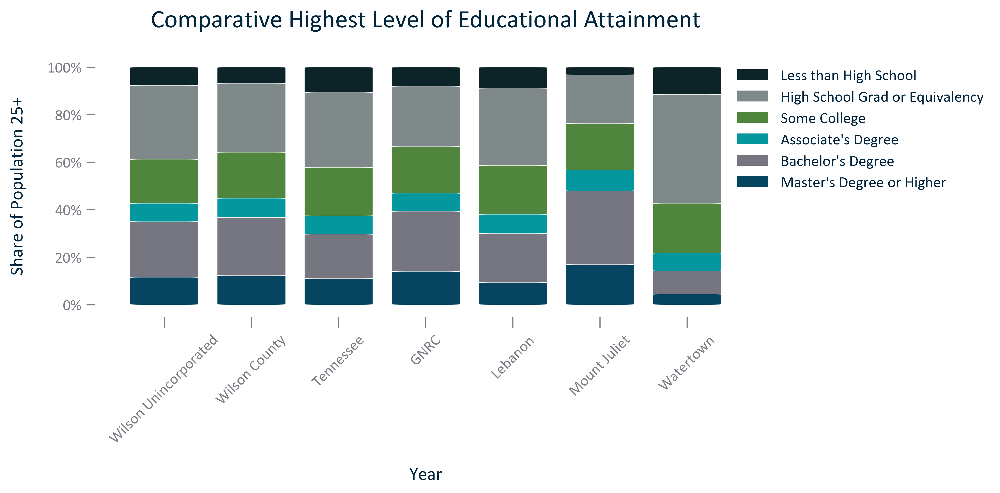

In [91]:
title = 'Comparative Highest Level of Educational Attainment'
df_temp = reggeos.loc[reggeos['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
df_temp = df_temp[['NAME','Ed%:Masters or More', 'Ed%:Bachelors', 'Ed%:Associates', 'Ed%:Some College', 
                   'Ed%:High School Graduate or Equivalency', 'Ed%:Less than High School']]
df_temp = df_temp.rename(columns = {'Ed%:Less than High School': 'Less than High School',
                                    'Ed%:High School Graduate or Equivalency': 'High School Grad or Equivalency',
                                    'Ed%:Some College': 'Some College', 
                                    'Ed%:Associates': "Associate's Degree",
                                    'Ed%:Bachelors': "Bachelor's Degree", 
                                    'Ed%:Masters or More': "Master's Degree or Higher"}).set_index('NAME')
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Year', ylabel = 'Share of Population 25+') #set the title and axes labels
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
#display and save
fig.savefig('../Figures/EDUCATION_stackedbar_geocomparative_highestattainment_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_stackedbar_geocomparative_highestattainment_2022.png', bbox_inches='tight')
with open('../Figures/EDUCATION_stackedbar_geocomparative_highestattainment_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

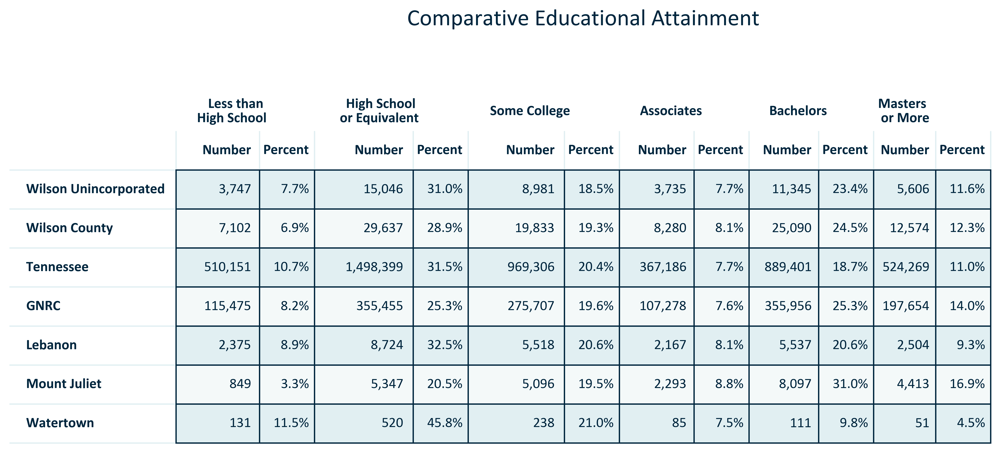

In [92]:
title = 'Comparative Educational Attainment'
#set up temporary dataframe
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp[['Ed:Less than High School', 'Ed%:Less than High School', 'Ed:High School Graduate or Equivalency', 
                   'Ed%:High School Graduate or Equivalency', 'Ed:Some College', 'Ed%:Some College', 
                   'Ed:Associates', 'Ed%:Associates', 'Ed:Bachelors', 'Ed%:Bachelors', 'Ed:Masters or More', 'Ed%:Masters or More']]
df_temp.update(df_temp[['Ed%:Masters or More', 'Ed%:Bachelors', 'Ed%:Associates', 'Ed%:Some College', 
                        'Ed%:High School Graduate or Equivalency', 'Ed%:Less than High School']].applymap('{:,.1f}%'.format))
df_temp.update(df_temp[['Ed:Masters or More', 'Ed:Bachelors', 'Ed:Associates', 'Ed:Some College', 
                        'Ed:High School Graduate or Equivalency', 'Ed:Less than High School']].applymap('{:,.0f}'.format))
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
#index length + 2 for merge column table
colours = tablecolors((indexlength + 2), width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#under 18, 18 to 54, 55 and Older
col_names = ['Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent', 'Number', 'Percent']
row_headers = df_temp.index
rowstemp = row_headers.insert(0, '')
rowsformerged = rowstemp.insert(0, '')
colstomerge = ['Less than \nHigh School','', 'High School \n or Equivalent', '', 'Some College', '', 'Associates','', 'Bachelors', '', 'Masters \n or More', '']
doublecols = np.vstack([colstomerge, col_names])
tabletext=np.vstack([colstomerge, col_names, df_temp.values])
#initiate table and set parameters
table = ax.table(cellText=tabletext, rowLabels = rowsformerged, loc = 'center', cellColours = colours, 
                 colColours = colcolours, cellLoc = 'right', rowLoc = 'left', colLoc = 'left', rowColours = rowcolours)
#draw canvas and merge cells
fig.canvas.draw()
mergecells(table, (0,2), (0,3))
mergecells(table, (0,0), (0,1))
mergecells(table, (0,4), (0,5))
mergecells(table, (0,6), (0,7))
mergecells(table, (0,8), (0,9))
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
ax.axhline(y = 1, color = 'red')
column_headers = colstomerge
allheadersmerged(col1, col2, edge1, edge2)
table.scale(2, 2.5) #table scaling
#display and save
#fig.savefig('../Figures/EDUCATION_table_geocomparative_attainment_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_table_geocomparative_attainment_2022.png', bbox_inches='tight')
with open('../Figures/EDUCATION_table_geocomparative_attainment_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

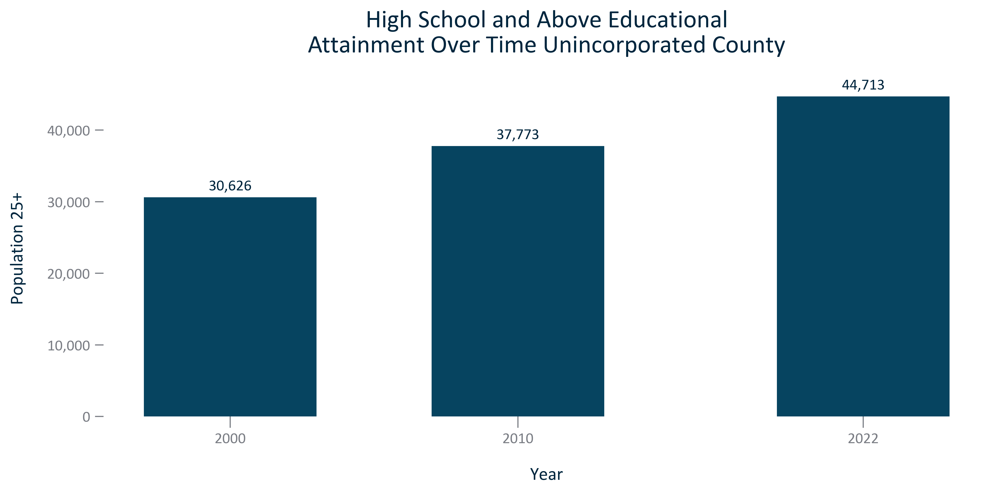

In [93]:
title = 'High School and Above Educational\nAttainment Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Ed:High School Graduate or More']]
xinput = 'Year'
yinput = 'Ed:High School Graduate or More'
xlabel = xinput
ylabel = 'Population 25+'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/EDUCATION_bar_primarygeo_highschoolandabove_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_bar_primarygeo_highschoolandabove_overtime.png', bbox_inches='tight')
with open('../Figures/EDUCATION_bar_primarygeo_highschoolandabove_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

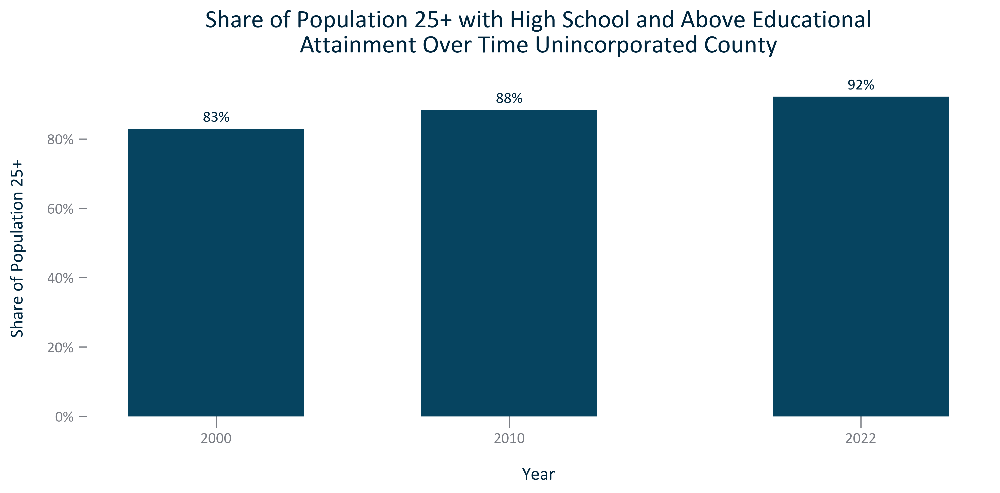

In [94]:
title = 'Share of Population 25+ with High School and Above Educational\nAttainment Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Ed%:High School Graduate or More']]
xinput = 'Year'
yinput = 'Ed%:High School Graduate or More'
xlabel = xinput
ylabel = 'Share of Population 25+'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}%")
#display and save
fig.savefig('../Figures/EDUCATION_bar_primarygeo_sharehighschoolandabove_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_bar_primarygeo_sharehighschoolandabove_overtime.png', bbox_inches='tight')
with open('../Figures/EDUCATION_bar_primarygeo_sharehighschoolandabove_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

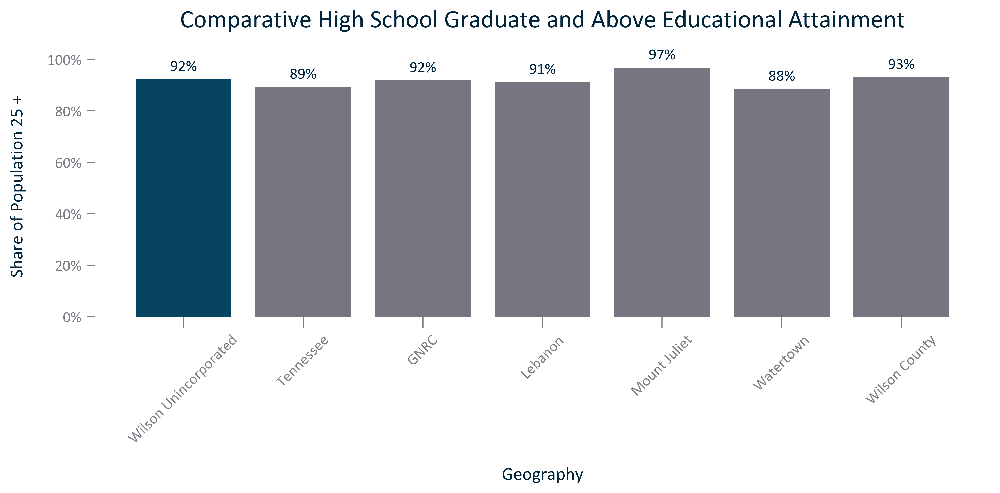

In [95]:
title = "Comparative High School Graduate and Above Educational Attainment"
#set up temporary dataframe
xinput = 'NAME'
yinput = 'Ed%:High School Graduate or More'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Time Frame'] == 'None']
df_temp = df_temp.loc[df_temp['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = 'Geography'
ylabel = 'Share of Population 25 +'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
singledatalabels(0, 6, "{:,.0f}%")
#display and save
fig.savefig('../Figures/EDUCATION_bar_geocomparative_highschoolorhigherattainment_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_bar_geocomparative_highschoolorhigherattainment_2022.png', bbox_inches='tight')
with open('../Figures/EDUCATION_bar_geocomparative_highschoolorhigherattainment_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

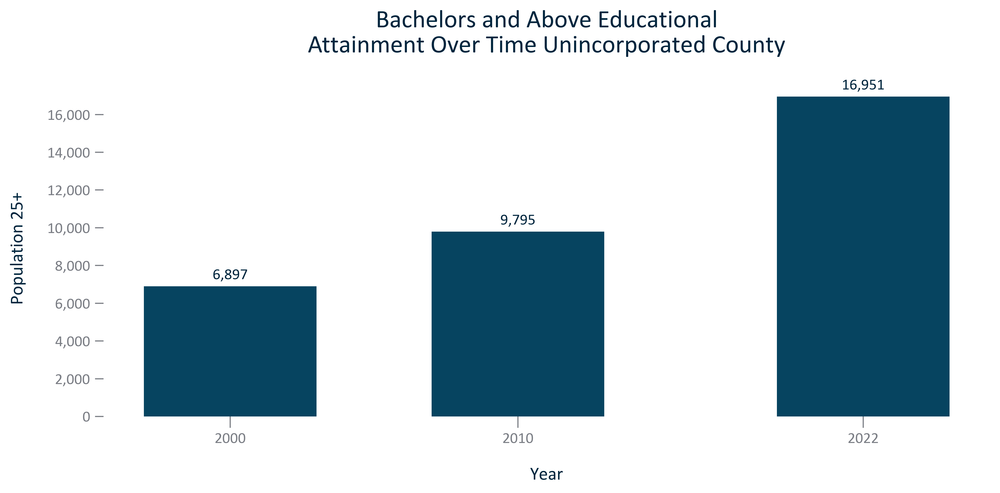

In [96]:
title = 'Bachelors and Above Educational\nAttainment Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Ed:Bachelors or More']]
xinput = 'Year'
yinput = 'Ed:Bachelors or More'
xlabel = xinput
ylabel = 'Population 25+'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(numbernodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}")
#display and save
fig.savefig('../Figures/EDUCATION_bar_primarygeo_bachelorsandabove_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_bar_primarygeo_bachelorsandabove_overtime.png', bbox_inches='tight')
with open('../Figures/EDUCATION_bar_primarygeo_bachelorsandabove_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

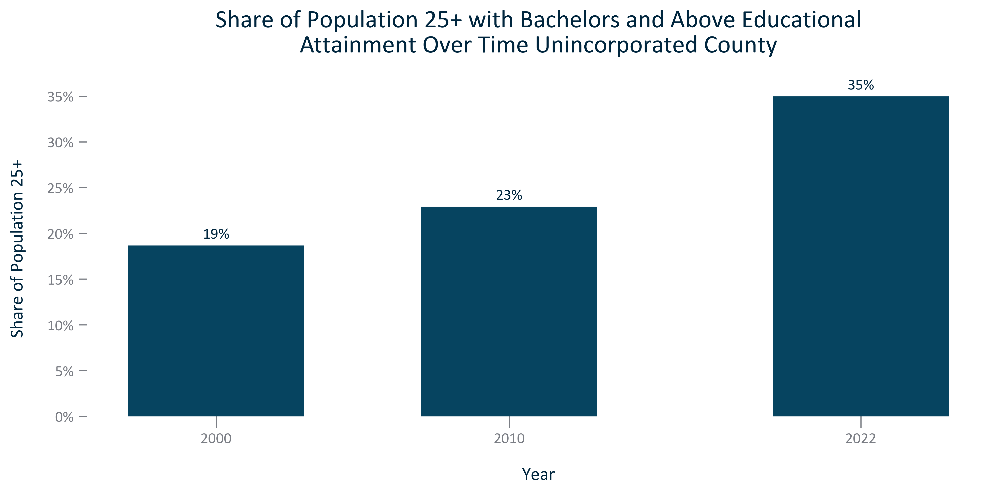

In [97]:
title = 'Share of Population 25+ with Bachelors and Above Educational\nAttainment Over Time Unincorporated County'
df_temp = Primary.loc[Primary['Time Frame'] == 'None']
df_temp = df_temp[['NAME', 'Year', 'Ed%:Bachelors or More']]
xinput = 'Year'
yinput = 'Ed%:Bachelors or More'
xlabel = xinput
ylabel = 'Share of Population 25+'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
ax.bar(x, y, width = 6) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
labels = ['2000', '2010', '2022']
plt.xticks(x, labels)
#data labels
singledatalabels(0, 5, "{:,.0f}%")
#display and save
fig.savefig('../Figures/EDUCATION_bar_primarygeo_sharebachelorsandabove_overtime.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_bar_primarygeo_sharebachelorsandabove_overtime.png', bbox_inches='tight')
with open('../Figures/EDUCATION_bar_primarygeo_sharebachelorsandabove_overtime.txt', 'w') as text_file:
    text_file.write('Citation: 2000 Decennial Census, 2006-2010 and {}'.format(acs))
plt.show()
plt.close();

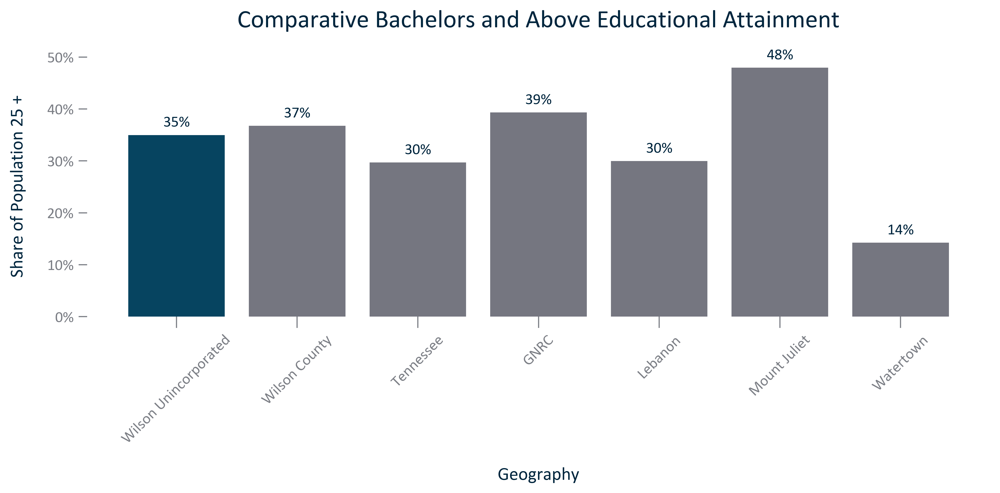

In [98]:
title = "Comparative Bachelors and Above Educational Attainment"
#set up temporary dataframe
xinput = 'NAME'
yinput = 'Ed%:Bachelors or More'
df_temp = reggeos.loc[reggeos['Time Frame'] == 'None']
df_temp = df_temp.loc[df_temp['Year'] == 2022.0].sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
x = df_temp[xinput]
y = df_temp[yinput]
xlabel = 'Geography'
ylabel = 'Share of Population 25 +'
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
singledatalabels(0, 6, "{:,.0f}%")
#display and save
fig.savefig('../Figures/EDUCATION_bar_geocomparative_bachelorsorhigherattainment_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/EDUCATION_bar_geocomparative_bachelorsorhigherattainment_2022.png', bbox_inches='tight')
with open('../Figures/EDUCATION_bar_geocomparative_bachelorsorhigherattainment_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

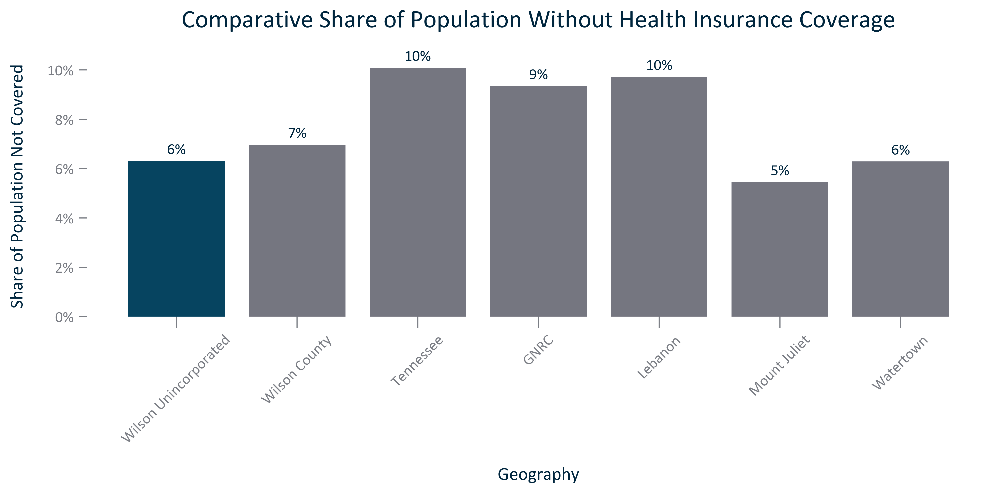

In [99]:
title = 'Comparative Share of Population Without Health Insurance Coverage'
df_temp = reggeos.loc[reggeos['Year'] == 2022.0]
df_temp = df_temp[['NAME', 'HealthCoverage%: None']]
df_temp = df_temp.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols).reset_index(drop = False)
xinput = 'NAME'
yinput = 'HealthCoverage%: None'
xlabel = 'Geography'
ylabel = 'Share of Population Not Covered'
x = df_temp[xinput]
y = df_temp[yinput]
#initiate figure and set parameters
fig, ax = plt.subplots()
bar_color = [C2 if i != primarygeo else C1 for i in x]
ax.bar(x, y, color = bar_color) 
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#data labels
singledatalabels(0, 5, "{:,.0f}%")
#display and save
fig.savefig('../Figures/HEALTH_bar_geocomparative_sharepopulationnohealthcoverage_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/HEALTH_bar_geocomparative_sharepopulationnohealthcoverage_2022.png', bbox_inches='tight')
with open('../Figures/HEALTH_bar_geocomparative_sharepopulationnohealthcoverage_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

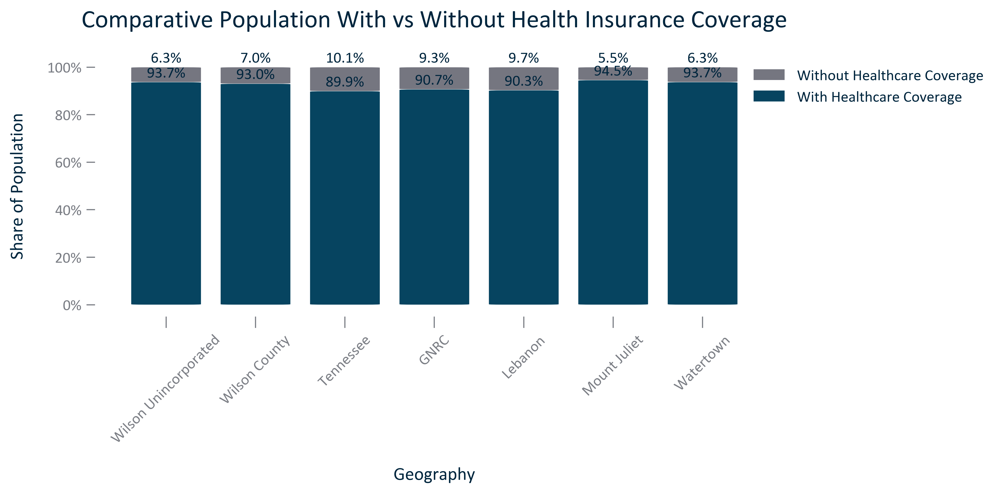

In [100]:
title = 'Comparative Population With vs Without Health Insurance Coverage'
df_temp = reggeos.loc[reggeos['Year'] == 2022.0]
df_temp = df_temp[['NAME', 'HealthCoverage%: With Healthcare Coverage', 'HealthCoverage%: None']]
df_temp = df_temp.rename(columns = {'HealthCoverage%: With Healthcare Coverage': 'With Healthcare Coverage', 'HealthCoverage%: None': 'Without Healthcare Coverage'})
df_temp = df_temp.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
#figure
fig, ax = plt.subplots()
w = 0.9
bottom = np.zeros(len(df_temp))
for i, col in enumerate(df_temp.columns):
    ax.bar(df_temp.index, df_temp[col], w, bottom=bottom, label=col)
    bottom += np.array(df_temp[col])
#rounded boxes
roundedboxes(boxstyleinput)
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.set(title = title, xlabel = 'Geography', ylabel = 'Share of Population') #set the title and axes labels
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
#outside legend
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(0.95, 1), frameon = False)
# # For each patch (basically each rectangle within the bar), add a label.
stackedbarlabels(abovestackedbarlabels)
#display and save
fig.savefig('../Figures/HEALTH_stackedbar_geocomparative_sharewithandwithouthealthcarecoverage_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/HEALTH_stackedbar_geocomparative_sharewithandwithouthealthcarecoverage_2022.png', bbox_inches='tight')
with open('../Figures/HEALTH_stackedbar_geocomparative_sharewithandwithouthealthcarecoverage_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

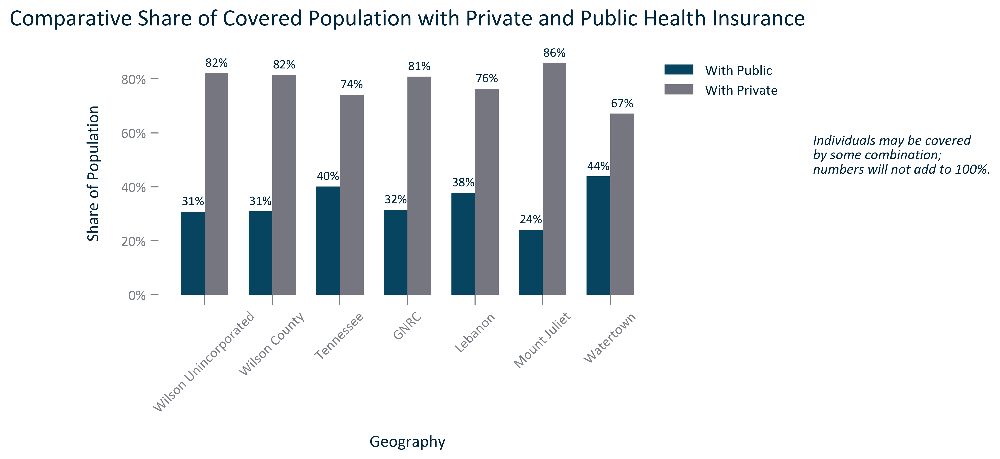

In [101]:
title = 'Comparative Share of Covered Population with Private and Public Health Insurance'
df_temp = reggeos.sort_values(by = 'Population', ascending = False)
#df_temp = df_temp.loc[(df_temp['NAME'] != 'US')&(df_temp['NAME'] != 'Mitchellville')&(df_temp['NAME'] != 'Millersville')&(df_temp['NAME'] != 'Westmoreland')]
df_temp = df_temp.loc[df_temp['Year'] == 2022.0]
df_temp = df_temp.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
xpos = np.arange(len(df_temp.index))
x = df_temp.index
y1 = df_temp['HealthCoverage%: With Public Healthcare Coverage']
y2 = df_temp['HealthCoverage%: With Private Healthcare Coverage']
xlabel = 'Geography'
ylabel = 'Share of Population'
width = 0.35
#initiate
fig, ax = plt.subplots()
bar1 = ax.bar(xpos-width/2, y1, width, label = 'With Public')
bar2 = ax.bar(xpos+width/2, y2, width, label = 'With Private')
ax.set(title = title, xlabel = xlabel, ylabel = ylabel) #set the title and axes labels
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter(percentnodecimalformat)) #y axis formatting
ax.tick_params(axis = 'x', which = 'major', rotation = 45)
ax.set_xticks(xpos)
ax.set_xticklabels(x)
#outside legend
ax.legend(bbox_to_anchor=(0.99, 1), loc='upper left', frameon = False)
ax.text(9, 45, 'Individuals may be covered\nby some combination;\nnumbers will not add to 100%.', style = 'italic')
#data labels
doubledatalabels(-9, 5, 9, 5, "{:,.0f}%", SMALLER_SIZE)
#display and save
fig.savefig('../Figures/HEALTH_clusterbar_geocomparative_publicandprivatehealthinsurancecoverage_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/HEALTH_clusterbar_geocomparative_publicandprivatehealthinsurancecoverage_2022.png', bbox_inches='tight')
with open('../Figures/HEALTH_clusterbar_geocomparative_publicandprivatehealthinsurancecoverage_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();

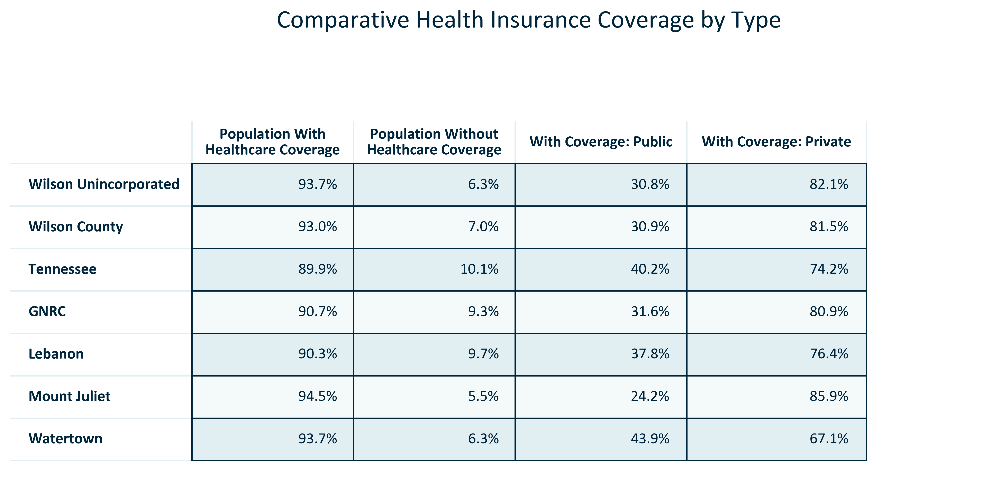

In [102]:
title = 'Comparative Health Insurance Coverage by Type'
df_temp = reggeos
df_temp = df_temp.loc[df_temp['Year'] == 2022.0].sort_values(by = 'Population', ascending = False)
df_temp = df_temp[['NAME', 'HealthCoverage%: With Healthcare Coverage', 'HealthCoverage%: None', 'HealthCoverage%: With Public Healthcare Coverage', 
                   'HealthCoverage%: With Private Healthcare Coverage']]
df_temp = df_temp.rename(columns = {'HealthCoverage%: None': 'Population Without\nHealthcare Coverage',
                                    'HealthCoverage%: With Healthcare Coverage': 'Population With\nHealthcare Coverage',  
                                    'HealthCoverage%: With Public Healthcare Coverage': 'With Coverage: Public', 
                                    'HealthCoverage%: With Private Healthcare Coverage': 'With Coverage: Private'})
df_temp.update(df_temp[['Population With\nHealthcare Coverage', 'Population Without\nHealthcare Coverage', 
                        'With Coverage: Public', 'With Coverage: Private']].applymap('{:,.1f}%'.format))
df_temp = df_temp.sort_values(by = 'NAME').set_index('NAME')
newcols = list(df_temp.index)
newcols.remove(primarygeo)
newcols.remove(county)
newcols.remove(state)
newcols.remove(region)
newcols = [region] + newcols
newcols = [state] + newcols
newcols = [county] + newcols
newcols = [primarygeo] + newcols
df_temp = df_temp.reindex(newcols)
df_temp = df_temp.replace({'nan%': '-', 'inf%': '-'})
#set up table
indexlength = len(df_temp.index)
width = len(df_temp.columns)
colours = tablecolors(indexlength, width)
colcolours = howwide(width)
rowcolours = howlong(indexlength)
#initiate figure and hide axes
fig, ax = plt.subplots()
fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')
#initiate table and set parameters
table = ax.table(cellText = df_temp.values, colLabels = df_temp.columns, rowLabels = df_temp.index, loc = 'center', cellColours = colours, colColours = colcolours, 
                cellLoc = 'right', rowLoc = 'left', rowColours = rowcolours)
table.auto_set_column_width(col=list(range(len(df_temp.columns))))
ax.set_title(label = title, y = 1.1)
row_headers = df_temp.index
column_headers = df_temp.columns
table.scale(2, 2.5) #table scaling
allheaders(col1, col2, edge1, edge2)
#display and save
fig.savefig('../Figures/HEALTH_table_geocomparative_healthinsurancebytype_2022.svg', bbox_inches='tight')
fig.savefig('../Figures/HEALTH_table_geocomparative_healthinsurancebytype_2022.png', bbox_inches='tight')
with open('../Figures/HEALTH_table_geocomparative_healthinsurancebytype_2022.txt', 'w') as text_file:
    text_file.write('Citation: {}'.format(acs))
plt.show()
plt.close();